In [ ]:
from google.colab import drive
import os
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from sklearn.model_selection import train_test_split
from skimage.segmentation import felzenszwalb
from skimage.color import rgb2gray
from skimage.util import img_as_float
from skimage.color import label2rgb
from sklearn.preprocessing import StandardScaler
from skimage.feature import hog
from scipy import stats
from math import sqrt

from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report, ConfusionMatrixDisplay, confusion_matrix
from sklearn.svm import SVC
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import SGDClassifier
from sklearn import svm
import random

# Mount Google Drive
drive.mount('/content/drive')

# Path to the data folder
BASE_DIR = "/content/drive/My Drive/ECSE 415/ECSE 415 Data"

# Subfolders
RGB_DIR = os.path.join(BASE_DIR, "rgb")
MASK_DIR = os.path.join(BASE_DIR, "mask")
CSV_DIR = os.path.join(BASE_DIR, "csv")
SPLITS_DIR = os.path.join(BASE_DIR, "splits")

# Create splits folder if needed
os.makedirs(SPLITS_DIR, exist_ok=True)

TRAIN_SUBJECTS_DIR = os.path.join(BASE_DIR, "splits", "train_subjects.csv")
VAL_SUBJECTS_DIR = os.path.join(BASE_DIR, "splits", "validate subjects.csv")


Mounted at /content/drive


# 3. Dataset

## 3.1 Plot Images
We will first plot three images for a sample subject - (i) an input image, (ii) the corresponding mask, and (iii) overlay the periphery of the mask onto the image to draw bounding boxes around different types of nuclei and label them.

In [ ]:
# Create a dictionary of subjects where:
  # The key is the combination of the first 4 strings of the filename
  # The value is a list containing all the name (except the extension) of the files that refers to the same subject

def extract_subject_id(filename):
    # Split the filename by hyphen and keep the first 4 parts
    parts = filename.split("-")[:3]
    # Reconstruct the subject ID using hyphens
    return "-".join(parts)

subject_map = {}

for filename in os.listdir(CSV_DIR):
    full_path = os.path.join(CSV_DIR, filename)

    # checking if it is a file
    if os.path.isfile(full_path):
        # get the subject id
        sid = extract_subject_id(filename)
        # Get filename without extension
        fname_no_ext = os.path.splitext(filename)[0]

        # Add it to the dict and append the filename with no extension
        if sid not in subject_map:
            subject_map[sid] = []
        subject_map[sid].append(fname_no_ext)


In [ ]:
# Get the number of unique subject IDs
subject_ids = list(subject_map.keys())
number_of_subjects = len(subject_ids)

# Randomly choose one subject
random_idx = np.random.randint(0, number_of_subjects)
selected_id = subject_ids[random_idx]

# Load the RGB image
rgb_filename = subject_map[selected_id][0] + ".png"
rgb_image_path = os.path.join(RGB_DIR, rgb_filename)
print(rgb_image_path)
rgb_image = cv2.imread(rgb_image_path)
rgb_image = cv2.cvtColor(rgb_image, cv2.COLOR_BGR2RGB)

# Load the corresponding mask
mask_filename = subject_map[selected_id][0] + ".png"
mask_image_path = os.path.join(MASK_DIR, mask_filename)
mask_image = cv2.imread(mask_image_path)
mask_image = cv2.cvtColor(mask_image, cv2.COLOR_BGR2RGB)
mask_gray = cv2.cvtColor(mask_image, cv2.COLOR_BGR2GRAY)


/content/drive/My Drive/ECSE 415/ECSE 415 Data/rgb/TCGA-BH-A0BL-DX1_id-5ea40977ddda5f839897c4d8_left-28546_top-44875_bottom-45156_right-28831.png


In [ ]:
def parse_polygons(x_list, y_list):
    coordinates = []

    for x_str, y_str in zip(x_list, y_list):
        # Convert string of comma-separated values into NumPy arrays
        x_vals = np.fromstring(x_str, dtype=np.int32, sep=",")
        y_vals = np.fromstring(y_str, dtype=np.int32, sep=",")

        # Combine into shape (N, 1, 2) for OpenCV polylines
        points = np.stack((x_vals, y_vals), axis=1).reshape(-1, 1, 2)
        coordinates.append(points)

    return coordinates


In [ ]:
def draw_polylines(img, coordinates):
    masked_img = img.copy()

    for coords in coordinates:
        # Draw each polyline on the image with blue color
        cv2.polylines(masked_img, [coords], isClosed=True, color=(255, 0, 0), thickness=1)

    return masked_img


In [ ]:
subject_csv_path = os.path.join(CSV_DIR, subject_map[selected_id][0] + ".csv")
df = pd.read_csv(subject_csv_path)
df.head()

coords_x = df["coords_x"].to_list()
coords_y = df["coords_y"].to_list()

coordinates = parse_polygons(coords_x, coords_y)
masked = draw_polylines(rgb_image, coordinates)

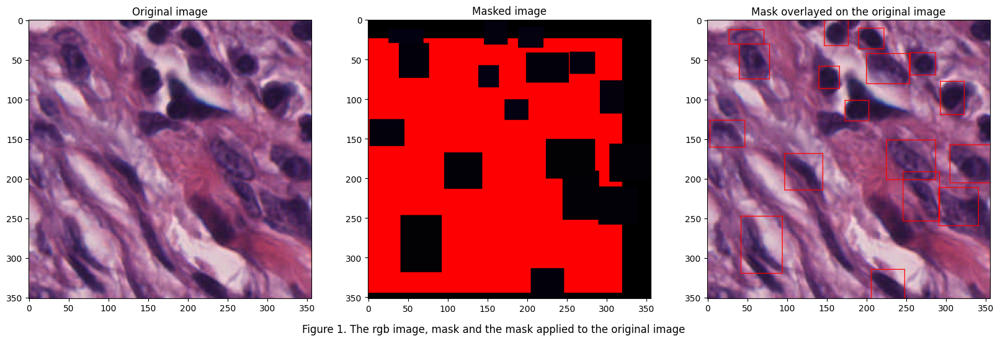

In [ ]:
fig = plt.figure(figsize=(20, 20))
plt.subplot(1, 3, 1)
plt.title("Original image")
plt.imshow(rgb_image)
plt.subplot(1, 3, 2)
plt.title("Masked image")
plt.imshow(mask_image)
plt.subplot(1, 3, 3)
plt.title("Mask overlayed on the original image")
plt.imshow(masked)
fig.text(0.5, 0.05, "Figure 1. The rgb image, mask and the mask applied to the original image", ha='center', fontsize=12)
plt.subplots_adjust(bottom=-0.5)
plt.show()

## 3.2 Create Training and Validation Data
Now, we will loop over all the image files to obtain unique subjects and then create a training and validation split, i.e., put 80% of patients in training and 20% of data in the validation. We will save training and validation splits as train subjects.csv and validate subjects.csv files.

In [ ]:
# Set random seed and split into training and validation sets
random_seed = 967513
train_subjects, val_subjects = train_test_split(subject_ids, train_size=0.8, random_state=random_seed)

# Prepare DataFrame for training set
train_ids = np.arange(len(train_subjects), dtype=np.int32)
train_meta = {
    "slno": train_ids,
    "slide_name": train_subjects,
    "type": "train",
    "fold": np.full(len(train_subjects), 1, dtype=np.int32)
}
df_train = pd.DataFrame(train_meta)

# Prepare DataFrame for validation set
val_ids = np.arange(len(val_subjects), dtype=np.int32)
val_meta = {
    "slno": val_ids,
    "slide_name": val_subjects,
    "type": "validation",
    "fold": np.full(len(val_subjects), 1, dtype=np.int32)
}
df_val = pd.DataFrame(val_meta)

# Write CSVs to disk
df_train.to_csv(TRAIN_SUBJECTS_DIR, index=False)
df_val.to_csv(VAL_SUBJECTS_DIR, index=False)

# Preview training CSV
df_train.head()


,slno,slide_name,type,fold
0,0,TCGA-EW-A1PB,train,1
1,1,TCGA-A2-A3XS,train,1
2,2,TCGA-C8-A1HJ,train,1
3,3,TCGA-S3-AA10,train,1
4,4,TCGA-OL-A5D7,train,1


The main preprocessing steps were as follows:

* Sample Grouping: For each patient, there are several samples to aggregate.
* Dataset Split: The data was splitted according to the suggested division in the csv files.
* Data Visualization: An input image of a given patient, the corresponding mask and the overlay of the last two are displayed .


Furthermore, training and validation sets were created by looping over all the images, obtaining distinct subjects.
A training and validation split following the recommended 80/20 split was applied, meaning that 80% of patients
were put in a training directory while the remaining 20% of data was put in a validation directory.

# 4. Segmentation

## 4.1 Segmentation - Unsupervised


### 4.1.1 Find optimized value of K

The following function will be used to compute K-means clustering for the unsupervised segmentation implementation.

In [ ]:
# Function to perform K-mean clustering
# The following is adapted from tutorial 8 code
def k_mean_clustering(image, k, mode="rgb"):
    """
    mode: "rgb" or "gray"
    """
    if mode == "gray":
        # Convert to grayscale if it's not already
        if len(image.shape) == 3:
            image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
        image_reshaped = np.float32(image.reshape((-1, 1)))
    else:
        # Assume RGB
        image_reshaped = np.float32(image.reshape((-1, 3)))

    # Define K-means criteria
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1)
    _, labels, centers = cv2.kmeans(image_reshaped, k, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)

    # Reconstruct segmented image
    centers = np.uint8(centers)
    segmented = centers[labels.flatten()]

    if mode == "gray":
        segmented = segmented.reshape(image.shape)
        return segmented
    else:
        segmented = segmented.reshape(image.shape)
        return cv2.cvtColor(segmented, cv2.COLOR_BGR2RGB)

We will now show results of the K-means clustering for K = 3 and K = 5 for the first subject.

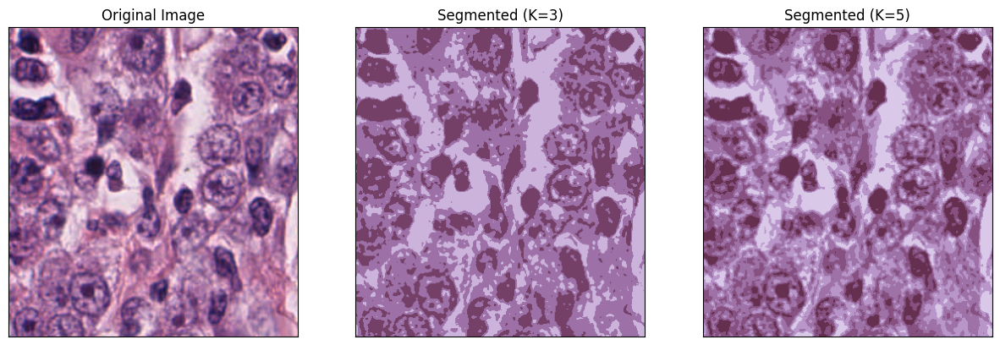

In [ ]:
# Load subject list
train_subjects = pd.read_csv(TRAIN_SUBJECTS_DIR)

# Get the first subject's ID and corresponding image files
subject_key = train_subjects.loc[0]['slide_name']
image_files = [f for f in os.listdir(RGB_DIR) if f.startswith(subject_key)]

# Ensure at least one image exists
if not image_files:
    raise ValueError(f"No images found for subject: {subject_key}")

# Load the first image
img_file = image_files[0]
img_path = os.path.join(RGB_DIR, img_file)
image = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)

# Perform K-means segmentation with K=3 and K=5
out_K3 = k_mean_clustering(image, 3)
out_K5 = k_mean_clustering(image, 5)

# Display results
plt.figure(figsize=(15, 5))

plt.subplot(131)
plt.imshow(image)
plt.title("Original Image")
plt.xticks([]), plt.yticks([])

plt.subplot(132)
plt.imshow(out_K3)
plt.title("Segmented (K=3)")
plt.xticks([]), plt.yticks([])

plt.subplot(133)
plt.imshow(out_K5)
plt.title("Segmented (K=5)")
plt.xticks([]), plt.yticks([])

plt.show()

In order to be able to compare the ground truth mask image, we first need to generate a ground truth mask image which is formatted correctly for the comparison. We will be generating this ground truth image from the information contained in the CSV file rather than using the mask image provided. Indeed, in order to compute DICE coefficients, we need an image that only contains black and white to indicate whether or not the current pixel belongs to a nucleus; therefore, using the pure coordinates is easier and more reliable than attempting to convert the provided mask into a binary output by decoding the different channels.

In [ ]:
# This function parses nuclei coordinates retrieved from the CSV file
def get_coordinates(coords_x, coords_y):
  coordinates = []
  for x, y in zip(coords_x, coords_y):
    # Convert the coordinates of the polyline into numpy
    x_p = np.fromstring(x, sep=",", dtype=np.int32)
    y_p = np.fromstring(y, sep=",", dtype=np.int32)
    # Stack it and reshape it to have [x, y] as element of array
    points = np.column_stack((x_p, y_p)).reshape(-1, 1, 2) # The third dimension is added only because opencv requires it
    coordinates.append(points)
  return coordinates

# This function draws shapes where the nuclei are set to be according to the CSV coordinates
def draw_polylines_filled(image, coordinates):
  masked = image.copy()
  for coords in coordinates:
    # For each polyline draw it on the image
    masked = cv2.fillPoly(masked, [coords], (255, 255, 255))
  return masked

# This function generates the ground truth image based on the CSV coordinates
def generate_ground_truth(subject_key, image_id, image_shape):
    # Match the ground truth mask shape to the original image
    height, width = image_shape[:2]
    ground_truth = np.zeros((height, width, 3), dtype=np.uint8)

    # Load CSV and draw polygons
    csv_file = os.path.join(CSV_DIR, f"{image_id}.csv")
    df = pd.read_csv(csv_file)

    coords_x = df["coords_x"].to_list()
    coords_y = df["coords_y"].to_list()
    coordinates = get_coordinates(coords_x, coords_y)

    # Draw nuclei polygons
    ground_truth = draw_polylines_filled(ground_truth, coordinates)

    # Convert to grayscale binary mask
    ground_truth = cv2.cvtColor(ground_truth, cv2.COLOR_RGB2GRAY)
    return ground_truth

Now, we will use the above functions to output a ground truth mask for the first subject's first image. Then, we will compute K-means clustering for K between 2 and 7 for this image, convert this output into a binary mask, and display results for a better visualization of the process. The binary mask for the segmented image is obtained by thresholding the image; the image is first converted to grayscale, then any pixel value below 110 is set to 0 (black, no nucleus); values above this threshold are set to 255 (white, contains a nucleus).

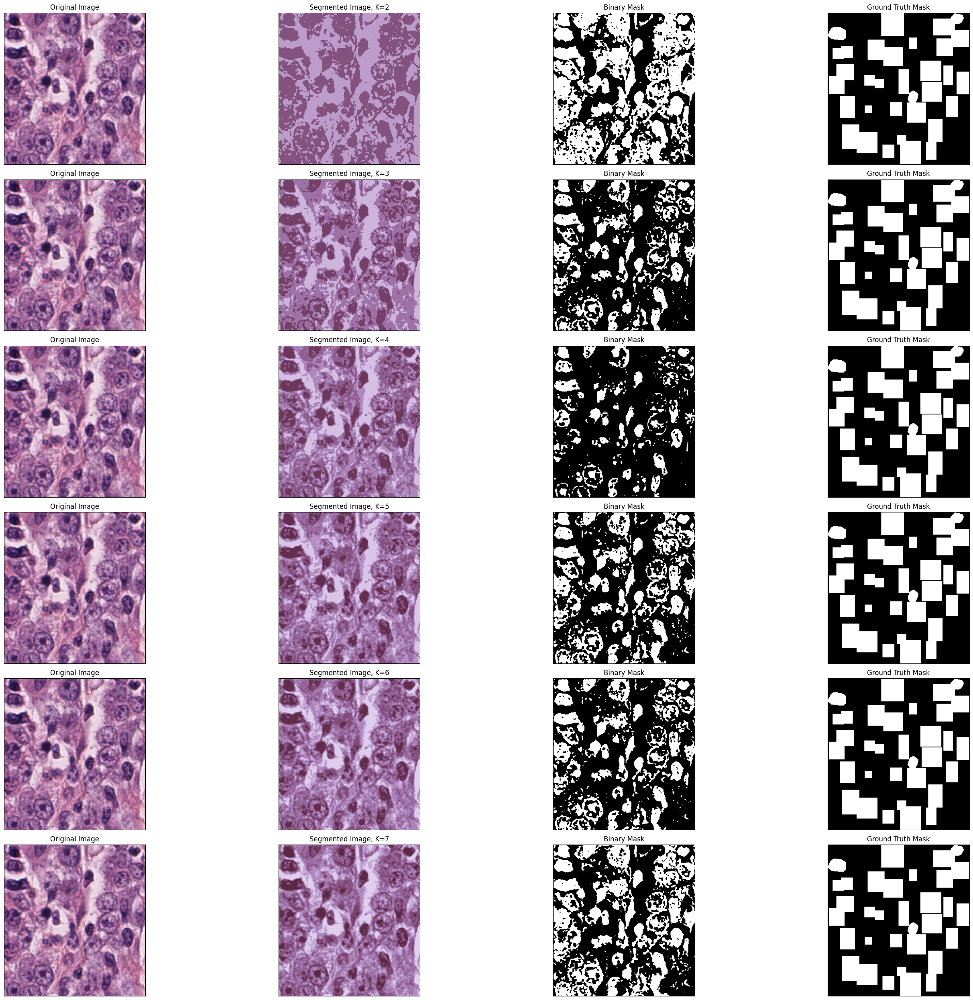

In [ ]:
# Output a segmentation mask and the ground truth mask for K between 2 and 7 for the first image
# Load training subjects
train_subjects = pd.read_csv(TRAIN_SUBJECTS_DIR)

# Build subject-to-image map
subject_image_map = {}
all_rgb_files = os.listdir(RGB_DIR)

for subj in train_subjects['slide_name']:
    matched_files = [f for f in all_rgb_files if f.startswith(subj)]
    if matched_files:
        subject_image_map[subj] = matched_files

# Use the first image from the first subject
first_subject = list(subject_image_map.keys())[0]
first_img_file = subject_image_map[first_subject][0]

img_path = os.path.join(RGB_DIR, first_img_file)
test_img = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)

# Get image ID (filename without extension)
image_id = os.path.splitext(first_img_file)[0]

# Generate GT mask using CSV
gt_mask = generate_ground_truth(first_subject, image_id, test_img.shape)

# Display parameters
row = 6
position = 1
plt.figure(figsize=(30, 25))

for k in range(2, 8):
    # Apply K-means segmentation
    segmented_color = k_mean_clustering(test_img, k)

    # Convert to grayscale + binary
    segmented_gray = cv2.cvtColor(segmented_color, cv2.COLOR_RGB2GRAY)
    _, binary_mask = cv2.threshold(segmented_gray, 110, 255, cv2.THRESH_BINARY_INV)

    # Show original image
    plt.subplot(row, 4, position)
    plt.imshow(test_img)
    plt.title("Original Image")
    plt.xticks([]), plt.yticks([])

    # Show segmented (K-means) image
    plt.subplot(row, 4, position + 1)
    plt.imshow(segmented_color)
    plt.title(f"Segmented Image, K={k}")
    plt.xticks([]), plt.yticks([])

    # Show binary mask (from clustering)
    plt.subplot(row, 4, position + 2)
    plt.imshow(binary_mask, cmap="gray")
    plt.title("Binary Mask")
    plt.xticks([]), plt.yticks([])

    # Show ground truth mask
    plt.subplot(row, 4, position + 3)
    plt.imshow(gt_mask, cmap="gray")
    plt.title("Ground Truth Mask")
    plt.xticks([]), plt.yticks([])

    position += 4

plt.tight_layout()
plt.show()

Now, we want to be able to evaluate the results quantitatively. In order to do this, we will compute DICE coefficients to evaluate the overlap between the segmented images (converted to binary masks) and the generated ground truth images. The following functions will be used for this task.

In [ ]:
# Function to compute DICE coefficients
def dice_coefficient(mask1, mask2):
    intersection = np.sum((mask1 == 255) & (mask2 == 255))
    total = np.sum(mask1 == 255) + np.sum(mask2 == 255)
    return (2. * intersection) / total if total > 0 else 0.0

# Function to evaluate the performance of the K values
def evaluate_k(image, img_file, subject_id, k_values):
    dice_scores = {}

    # Get image ID (without .png)
    image_id = os.path.splitext(img_file)[0]

    # Generate ground truth from CSV
    ground_truth = generate_ground_truth(subject_id, image_id, image.shape)

    # Resize image to match ground truth dimensions (512x512)
    image_resized = cv2.resize(image, (ground_truth.shape[1], ground_truth.shape[0]))

    for k in k_values:
        # Apply K-means segmentation
        segmented = k_mean_clustering(image_resized, k)

        # Convert to grayscale and binary mask
        segmented_gray = cv2.cvtColor(segmented, cv2.COLOR_RGB2GRAY)
        _, segmented_binary = cv2.threshold(segmented_gray, 110, 255, cv2.THRESH_BINARY_INV)

        # Ensure ground truth is binary
        _, ground_truth_binary = cv2.threshold(ground_truth, 110, 255, cv2.THRESH_BINARY_INV)

        # Compute DICE score
        dice_scores[k] = dice_coefficient(segmented_binary, ground_truth_binary)

    return dice_scores

Using the above defined functions, we will now compute the average DICE coefficient for the first 10 images in the training dataset in order to determine which value for K provides the best results.

In [ ]:
# Load training subjects
train_subjects = pd.read_csv(TRAIN_SUBJECTS_DIR)

# Map subjects to image files
subject_image_map = {}
all_rgb_files = os.listdir(RGB_DIR)

for subj in train_subjects['slide_name']:
    matched_files = [f for f in all_rgb_files if f.startswith(subj)]
    if matched_files:
        subject_image_map[subj] = matched_files

# Set K values to test
k_values = [2, 3, 4, 5, 6, 7]
k_dice_sums = {k: 0 for k in k_values}
num_images = 0

processed_images = 0

# Evaluate over first 10 images
for subject_id, files in list(subject_image_map.items())[:10]:
    for img_file in files:
        img_path = os.path.join(RGB_DIR, img_file)

        if not os.path.exists(img_path):
            continue

        # Load image
        image = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)

        # Evaluate K-means with current K values using CSV-based GT
        dice_scores = evaluate_k(image, img_file, subject_id, k_values)

        # Accumulate DICE scores
        for k in k_values:
            k_dice_sums[k] += dice_scores[k]

        num_images += 1

# Compute average DICE scores
k_avg_dice = {k: k_dice_sums[k] / num_images for k in k_values}

# Find the best K
optimal_k = max(k_avg_dice, key=k_avg_dice.get)

# Print results
print("\nAverage DICE scores per K:")
for k in k_values:
    print(f"K = {k}: DICE = {k_avg_dice[k]:.4f}")

print(f"\nOptimal K found: {optimal_k} with average DICE score = {k_avg_dice[optimal_k]:.4f}")


Average DICE scores per K:
K = 2: DICE = 0.3183
K = 3: DICE = 0.1781
K = 4: DICE = 0.1949
K = 5: DICE = 0.2160
K = 6: DICE = 0.1944
K = 7: DICE = 0.2106

Optimal K found: 2 with average DICE score = 0.3183


### 4.1.2 Optimized value of K decision

The best value to pick for K is the one that results in the highest DICE coefficients, meaning that the segmented image, once turned into a binary mask, is the closest to the ground truth provided.

In this case, after visually inspecting the segmentation results and evaluating DICE coefficients for 5 training images, the value of K that provided the highest average DICE coefficients was K = 2, with 0.3179.

This is logical: in the ground truth images, as can be seen in the examples displayed above, the nuclei are displayed as quite large squares around the actual nuclei. By using a smaller value for K, we use a smaller number of clusters around which to group the data, meaning that we reduce the original image to a smaller number of colors. We need to convert the segmented image to a black and white mask in order to be able to compute the DICE coefficients with the ground truth: this means that we are thresholding the segmented image to reduce it to black and white. If the segmented image only contained 2 clusters, then the thresholding process is rather simple, and we obtain an image that has somewhat large white zones around the nuclei, which resembles the ground truth images more. Larger values of K result in more a more precise rendering of the nuclei in their different colors instead of only grouping them into two colors (nuclei or no nuclei), which is ultimately what we want when we compare it to the ground truth.

### 4.1.3 Display results for optimized K

As a full example, we will now display the original image, the segmented image (with the optimal K) and the ground truth mask for the first subject's first image.

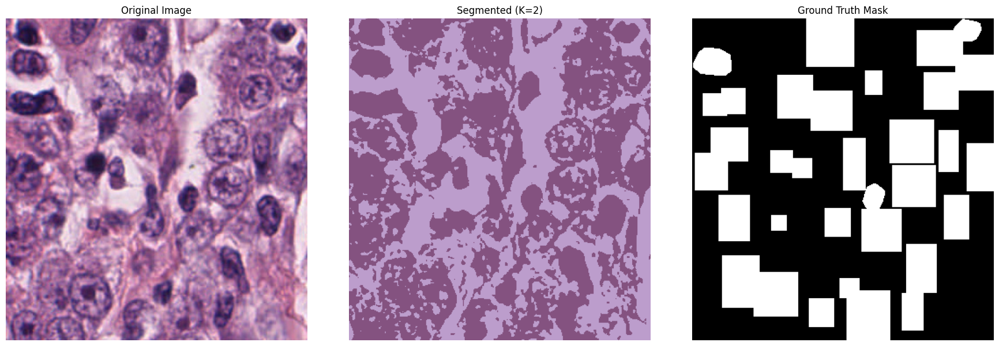

In [ ]:
train_subjects = pd.read_csv(TRAIN_SUBJECTS_DIR)

# Map subjects to image files
subject_image_map = {}
all_rgb_files = os.listdir(RGB_DIR)

for subj in train_subjects['slide_name']:
    matched_files = [f for f in all_rgb_files if f.startswith(subj)]
    if matched_files:
        subject_image_map[subj] = matched_files

# Pick first subject + image
subject_id = list(subject_image_map.keys())[0]
img_file = subject_image_map[subject_id][0]
img_path = os.path.join(RGB_DIR, img_file)

# Load image and get ID
image = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)
image_id = os.path.splitext(img_file)[0]

# Generate ground truth from CSV
ground_truth = generate_ground_truth(subject_id, image_id, image.shape)

# Segment with optimal K
segmented_image = k_mean_clustering(image, optimal_k)

# --- Plot the results ---
plt.figure(figsize=(18, 6))

# (i) Original image
plt.subplot(1, 3, 1)
plt.imshow(image)
plt.title("Original Image")
plt.axis("off")

# (ii) Segmented image
plt.subplot(1, 3, 2)
plt.imshow(segmented_image)
plt.title(f"Segmented (K={optimal_k})")
plt.axis("off")

# (iii) Ground truth mask
plt.subplot(1, 3, 3)
plt.imshow(ground_truth, cmap="gray")
plt.title("Ground Truth Mask")
plt.axis("off")

plt.tight_layout()
plt.show()

### 4.1.4 Compare with grayscale segmentation

We will now compare the results of this segmentation with the results obtained after first converting the input image to grayscale before computing the K-means clustering.

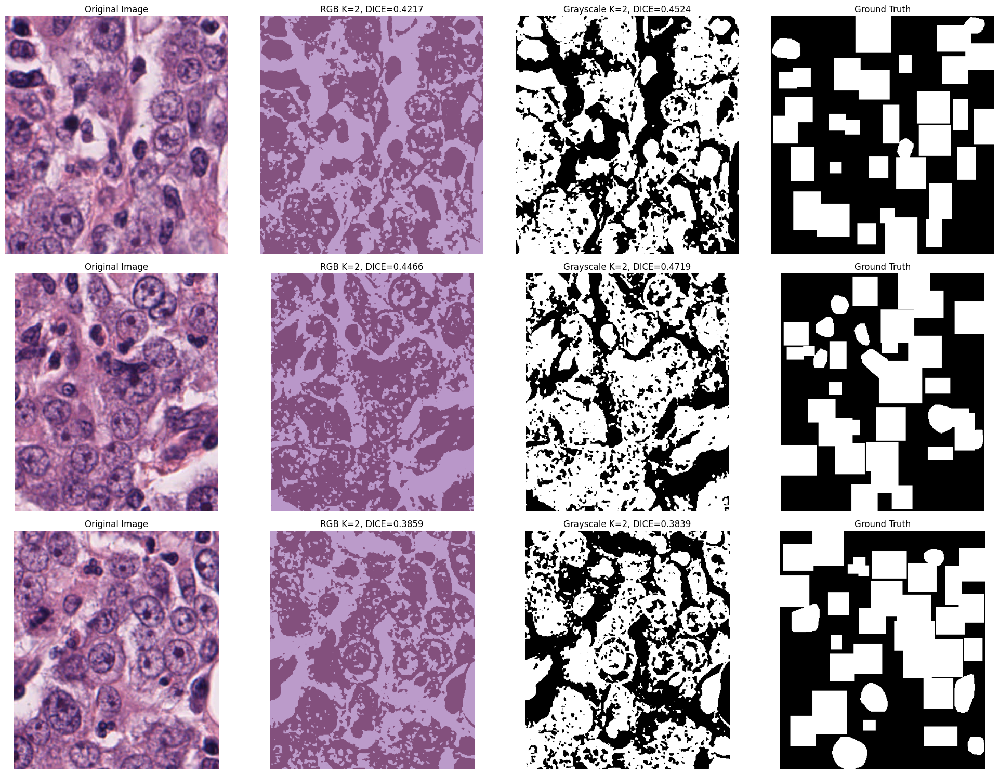

In [ ]:
# Compare RGB vs GRAY K-means on 3 images
processed_images = 0

plt.figure(figsize=(20, 15))

for subject_id, files in subject_image_map.items():
    for img_file in files:
        if processed_images >= 3:
            break

        img_path = os.path.join(RGB_DIR, img_file)
        if not os.path.exists(img_path):
            continue

        # Load and prepare image
        image = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)
        image_id = os.path.splitext(img_file)[0]
        ground_truth = generate_ground_truth(subject_id, image_id, image.shape)

        # Segment with RGB
        segmented_rgb = k_mean_clustering(image, optimal_k, mode="rgb")
        segmented_gray = k_mean_clustering(image, optimal_k, mode="gray")

        # Threshold both segmentations
        seg_gray_bin = cv2.threshold(segmented_gray, 110, 255, cv2.THRESH_BINARY_INV)[1]
        seg_rgb_gray = cv2.cvtColor(segmented_rgb, cv2.COLOR_RGB2GRAY)
        seg_rgb_bin = cv2.threshold(seg_rgb_gray, 110, 255, cv2.THRESH_BINARY_INV)[1]

        # Binarize ground truth
        gt_bin = cv2.threshold(ground_truth, 110, 255, cv2.THRESH_BINARY_INV)[1]

        # DICE scores
        dice_rgb = dice_coefficient(seg_rgb_bin, gt_bin)
        dice_gray = dice_coefficient(seg_gray_bin, gt_bin)

        # Plot results
        idx = processed_images * 4
        plt.subplot(3, 4, idx + 1)
        plt.imshow(image)
        plt.title("Original Image")
        plt.axis("off")

        plt.subplot(3, 4, idx + 2)
        plt.imshow(segmented_rgb)
        plt.title(f"RGB K={optimal_k}, DICE={dice_rgb:.4f}")
        plt.axis("off")

        plt.subplot(3, 4, idx + 3)
        plt.imshow(seg_gray_bin, cmap="gray")
        plt.title(f"Grayscale K={optimal_k}, DICE={dice_gray:.4f}")
        plt.axis("off")

        plt.subplot(3, 4, idx + 4)
        plt.imshow(ground_truth, cmap="gray")
        plt.title("Ground Truth")
        plt.axis("off")

        processed_images += 1
    if processed_images >= 3:
        break

plt.tight_layout()
plt.show()

As can be seen in the three examples displayed above, using a grayscale image for segmentation does improve the results slightly; for all three examples, the DICE coefficient obtained from the grayscale image segmentation is sligtly higher than that of the RGB image segmentation, with the largest increase being approximately 0.0253.

These results are logical, since the accuracy measure we use, DICE coefficients, usses a binary mask of the segmentation to compute results. If the input image is first converted to grayscale before even computing the K-means clustering, then the output of the segmentation itself is closer to the format we need for the binary mask, which makes it easier to compare with the ground truth image with the DICE coefficients.

### 4.1.5 Compare with another segmentation method

We will be using normalized cut clustering as an alternative segmentation method; below is a function used to compute it. We will use the skimage.segmentation.felzenszwalb() fast approximation to simplify implementation.

In [ ]:
def normalized_cut_segmentation(image, scale=100, sigma=0.8, min_size=50):
    from skimage.segmentation import felzenszwalb
    from skimage.color import label2rgb
    from skimage.util import img_as_float

    image_float = img_as_float(image)
    segments = felzenszwalb(image_float, scale=scale, sigma=sigma, min_size=min_size)

    # Convert label map to RGB
    segmented_rgb = label2rgb(segments, image, kind='avg')

    # Convert to uint8 and return in RGB format
    segmented_rgb_uint8 = np.uint8(segmented_rgb * 255)

    return segmented_rgb_uint8, segments

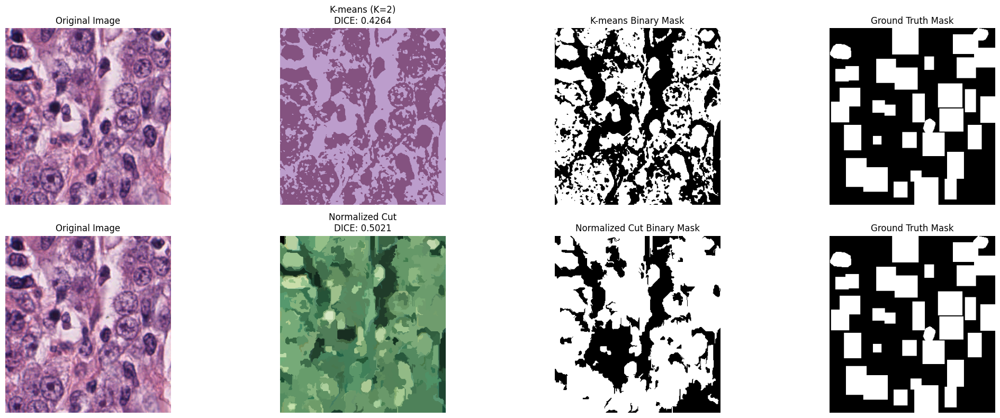

In [ ]:
# Load one image
subject_id = list(subject_image_map.keys())[0]
img_file = subject_image_map[subject_id][0]
img_path = os.path.join(RGB_DIR, img_file)

image = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)
image_id = os.path.splitext(img_file)[0]
ground_truth = generate_ground_truth(subject_id, image_id, image.shape)

# Segment with K-means
kmeans_result = k_mean_clustering(image, optimal_k)
kmeans_binary = cv2.threshold(cv2.cvtColor(kmeans_result, cv2.COLOR_RGB2GRAY), 110, 255, cv2.THRESH_BINARY_INV)[1]

# Segment with normalized cut (Felzenszwalb)
ncut_result, _ = normalized_cut_segmentation(image)

# Fix inverted mask
ncut_gray = cv2.cvtColor(ncut_result, cv2.COLOR_RGB2GRAY)
_, ncut_binary = cv2.threshold(ncut_gray, 110, 255, cv2.THRESH_BINARY_INV)
ncut_binary = 255 - ncut_binary  # Invert it to match the ground truth

# Ground truth binary
ground_truth_binary = cv2.threshold(ground_truth, 110, 255, cv2.THRESH_BINARY_INV)[1]

# DICE scores
dice_kmeans = dice_coefficient(kmeans_binary, ground_truth_binary)
dice_ncut = dice_coefficient(ncut_binary, ground_truth_binary)

# Plot comparison
plt.figure(figsize=(22, 8))

plt.subplot(2, 4, 1)
plt.imshow(image)
plt.title("Original Image")
plt.axis("off")

plt.subplot(2, 4, 2)
plt.imshow(kmeans_result)
plt.title(f"K-means (K={optimal_k})\nDICE: {dice_kmeans:.4f}")
plt.axis("off")

plt.subplot(2, 4, 3)
plt.imshow(kmeans_binary, cmap="gray")
plt.title("K-means Binary Mask")
plt.axis("off")

plt.subplot(2, 4, 4)
plt.imshow(ground_truth, cmap="gray")
plt.title("Ground Truth Mask")
plt.axis("off")

plt.subplot(2, 4, 5)
plt.imshow(image)
plt.title("Original Image")
plt.axis("off")

plt.subplot(2, 4, 6)
plt.imshow(ncut_result)
plt.title(f"Normalized Cut\nDICE: {dice_ncut:.4f}")
plt.axis("off")

plt.subplot(2, 4, 7)
plt.imshow(ncut_binary, cmap="gray")
plt.title("Normalized Cut Binary Mask")
plt.axis("off")

plt.subplot(2, 4, 8)
plt.imshow(ground_truth, cmap="gray")
plt.title("Ground Truth Mask")
plt.axis("off")

plt.tight_layout()
plt.show()

As can be seen in the images displayed above, the Normalized Cut approach was able to perform better than the K-means clustering on the tested image, with a DICE result of 0.5021 compared to 0.4264 for K-means. Indeed, this new approach was able to better break down the image into contiguous groups that were similar rather than just using color clusters. Since the ground truth images show very contiguous blocks where the nuclei are, having larger contiguous groups allows for better results than before, which is why Normalized Cut was able to obtain better results.

## 4.2 Segmentation - Supervised

### 4.2.1 Supervised approach used

For our supervised segmentation task, we treat segmentation as a pixel-wise classification problem using a Random Forest classifier. For each pixel in the image, we extract six features: grayscale intensity, x and y coordinates (which provide spatial context), local mean and local standard deviation computed from a 3×3 neighborhood, and gradient magnitude obtained via Sobel filters. These features capture both the pixel’s intensity and its local texture and spatial context, which are crucial for distinguishing nuclei from the background. The ground truth labels are derived from the first channel of the mask image and then binarized so that any nonzero value is set to 1 (indicating the presence of a nucleus) while 0 denotes the background. This method leverages Random Forest’s robustness to noise and overfitting, allowing us to build a comprehensive labeled dataset (X_train, y_train) that can segment unseen images effectively with minimal hyperparameter tuning.

### 4.2.2 Performance of the supervised segmentor on training images

columns in train_subjects.csv: Index(['slno', 'slide_name', 'type', 'fold'], dtype='object')
number of slide names: 99
number of training image files found: 1476
label distribution: {np.uint8(0): np.int64(13580041), np.uint8(1): np.int64(5788811)}
x_train shape: (19368852, 6)
y_train shape: (19368852,)
building tree 1 of 20
building tree 2 of 20
building tree 3 of 20
building tree 4 of 20
building tree 5 of 20
building tree 6 of 20
building tree 7 of 20
building tree 8 of 20
building tree 9 of 20
building tree 10 of 20
building tree 11 of 20
building tree 12 of 20
building tree 13 of 20
building tree 14 of 20
building tree 15 of 20
building tree 16 of 20
building tree 17 of 20
building tree 18 of 20
building tree 19 of 20
building tree 20 of 20
training accuracy: 0.7620921467106052

classification report:
               precision    recall  f1-score   support

           0       0.87      0.77      0.82  13580041
           1       0.58      0.74      0.65   5788811

    accuracy      

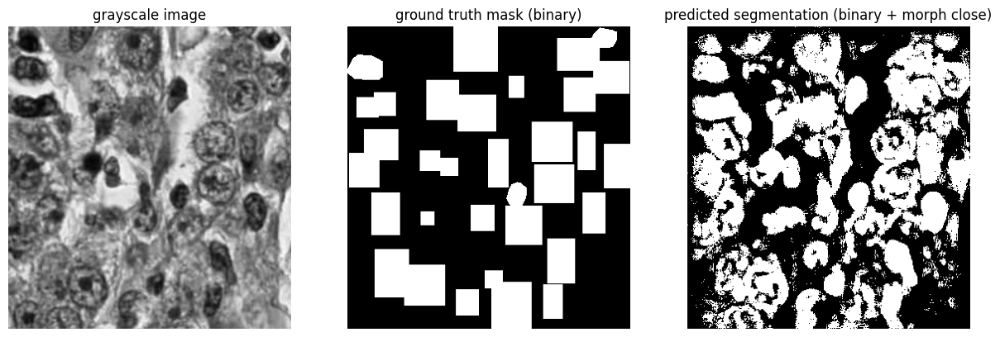

In [ ]:
# Load csv and match files
train_df = pd.read_csv(TRAIN_SUBJECTS_DIR)
print("columns in train_subjects.csv:", train_df.columns)

train_slide_names = train_df['slide_name'].tolist()
print("number of slide names:", len(train_slide_names))

def get_files_for_slides(slide_names, directory):
    matched_files = []
    all_files = os.listdir(directory)
    for slide_name in slide_names:
        for f in all_files:
            if f.startswith(slide_name):
                matched_files.append(f)
    return matched_files

train_files = get_files_for_slides(train_slide_names, RGB_DIR)
print("number of training image files found:", len(train_files))

# Helper functions

# The function we have here aligns image and mask by cropping to the smallest dimensions
def align_image_and_mask(gray_image, label_mask):
    h_img, w_img = gray_image.shape
    h_mask, w_mask = label_mask.shape
    new_h = min(h_img, h_mask)
    new_w = min(w_img, w_mask)
    return gray_image[:new_h, :new_w], label_mask[:new_h, :new_w]

# load image and mask, convert image to grayscale, and align shapes
def load_image_and_mask(filename):
    rgb_path = os.path.join(RGB_DIR, filename)
    mask_path = os.path.join(MASK_DIR, filename)

    image = cv2.imread(rgb_path, cv2.IMREAD_COLOR)
    mask = cv2.imread(mask_path, cv2.IMREAD_UNCHANGED)
    if image is None or mask is None:
        raise FileNotFoundError(f"could not load image or mask for: {filename}")

    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # If mask has multiple channels, we use the first channel
    if len(mask.shape) == 3:
        label_mask = mask[:, :, 0]
    else:
        label_mask = mask

    gray_aligned, mask_aligned = align_image_and_mask(gray_image, label_mask)
    return gray_aligned, mask_aligned

# Compute local mean and std in a ksize x ksize window
def local_mean_std(gray_image, ksize=3):
    mean_image = cv2.blur(gray_image.astype(np.float32), (ksize, ksize))
    sq_mean = cv2.blur((gray_image**2).astype(np.float32), (ksize, ksize))
    var_image = sq_mean - (mean_image**2)
    var_image[var_image < 0] = 0
    std_image = np.sqrt(var_image)
    return mean_image, std_image

# Compute gradient magnitude using sobel filters
def gradient_magnitude(gray_image):
    gx = cv2.Sobel(gray_image, cv2.CV_32F, 1, 0, ksize=3)
    gy = cv2.Sobel(gray_image, cv2.CV_32F, 0, 1, ksize=3)
    mag = cv2.magnitude(gx, gy)
    return mag

# Extract pixel-level features, with add_texture true, returns 6 features:
# Intensity, x, y, local mean, local std, and gradient magnitude.
def extract_features(gray_image, add_texture=True):
    h, w = gray_image.shape
    intensity = gray_image.flatten()
    x_coords, y_coords = np.meshgrid(np.arange(w), np.arange(h))
    x_coords = x_coords.flatten()
    y_coords = y_coords.flatten()

    if not add_texture:
        features = np.stack([intensity, x_coords, y_coords], axis=1)
        return features

    mean_img, std_img = local_mean_std(gray_image, ksize=3)  # change ksize if needed
    grad_img = gradient_magnitude(gray_image)
    mean_flat = mean_img.flatten()
    std_flat = std_img.flatten()
    grad_flat = grad_img.flatten()

    features = np.stack([intensity, x_coords, y_coords, mean_flat, std_flat, grad_flat], axis=1)
    return features

# Binarize mask: convert all nonzero labels to 1 (foreground)
def binarize_mask(label_mask):
    binary = np.where(label_mask > 2, 1, 0).astype(np.uint8)
    return binary

# Build training data
X_train_list = []
y_train_list = []


subsample_ratio = 0.1  # We can adjust ratio as needed to avoid too much memory usage

for file in train_files:
    try:
        gray, mask_orig = load_image_and_mask(file)
    except FileNotFoundError as e:
        print(e)
        continue

    label_mask = binarize_mask(mask_orig)
    features = extract_features(gray, add_texture=True)
    labels = label_mask.flatten()

    if features.shape[0] != labels.shape[0]:
        print(f"mismatch in file {file}: features({features.shape[0]}) vs labels({labels.shape[0]}). skipping.")
        continue

    num_pixels = features.shape[0]
    subsample_size = int(num_pixels * subsample_ratio)
    if subsample_size < 1:
        subsample_size = num_pixels
    idx = np.random.choice(num_pixels, subsample_size, replace=False)

    X_train_list.append(features[idx])
    y_train_list.append(labels[idx])

if len(X_train_list) == 0:
    print("no training data found!")
else:
    X_train = np.concatenate(X_train_list, axis=0)
    y_train = np.concatenate(y_train_list, axis=0)

    unique_vals, counts = np.unique(y_train, return_counts=True)
    print("label distribution:", dict(zip(unique_vals, counts)))
    print("x_train shape:", X_train.shape)
    print("y_train shape:", y_train.shape)

    # Train random forest
    rf = RandomForestClassifier(
        n_estimators=20,  # We can adjust number of trees as needed
        max_depth=20,     # Adjust depth as needed
        class_weight='balanced',
        random_state=42,
        verbose=2 # This gives us a rough time estimation
    )
    rf.fit(X_train, y_train)

    y_train_pred = rf.predict(X_train)
    train_acc = accuracy_score(y_train, y_train_pred)
    print("training accuracy:", train_acc)
    print("\nclassification report:\n", classification_report(y_train, y_train_pred))

    # Visualize a sample and morph post-process
    sample_file = train_files[0]
    gray_sample, mask_sample_orig = load_image_and_mask(sample_file)
    label_sample_bin = binarize_mask(mask_sample_orig)

    feat_sample = extract_features(gray_sample, add_texture=True)
    pred_sample = rf.predict(feat_sample)
    pred_mask = pred_sample.reshape(label_sample_bin.shape)

    # This is the segment where morph is applied to smooth out pixels
    kernel_open = np.ones((3,3), np.uint8)
    kernel_close = np.ones((5,5), np.uint8)
    pred_mask_open = cv2.morphologyEx(pred_mask.astype(np.uint8), cv2.MORPH_OPEN, kernel_open)
    pred_mask_morphed = cv2.morphologyEx(pred_mask_open, cv2.MORPH_CLOSE, kernel_close)

    plt.figure(figsize=(15,5))
    plt.subplot(1,3,1)
    plt.title("grayscale image")
    plt.imshow(gray_sample, cmap='gray')
    plt.axis('off')

    plt.subplot(1,3,2)
    plt.title("ground truth mask (binary)")
    plt.imshow(label_sample_bin, cmap='gray')
    plt.axis('off')

    plt.subplot(1,3,3)
    plt.title("predicted segmentation (binary + morph close)")
    plt.imshow(pred_mask, cmap='gray')
    plt.axis('off')

    plt.show()


### 4.2.3 Performance of supervised segmentor on the validation images

Columns in validate_subjects.csv: Index(['slno', 'slide_name', 'type', 'fold'], dtype='object')
Number of validation slide names: 25
Number of validation image files found: 268
Overall Validation Accuracy: 0.6930052242631589
Validation Classification Report:
              precision    recall  f1-score   support

           0       0.86      0.67      0.75  28287440
           1       0.51      0.75      0.60  12821898

    accuracy                           0.69  41109338
   macro avg       0.68      0.71      0.68  41109338
weighted avg       0.75      0.69      0.70  41109338



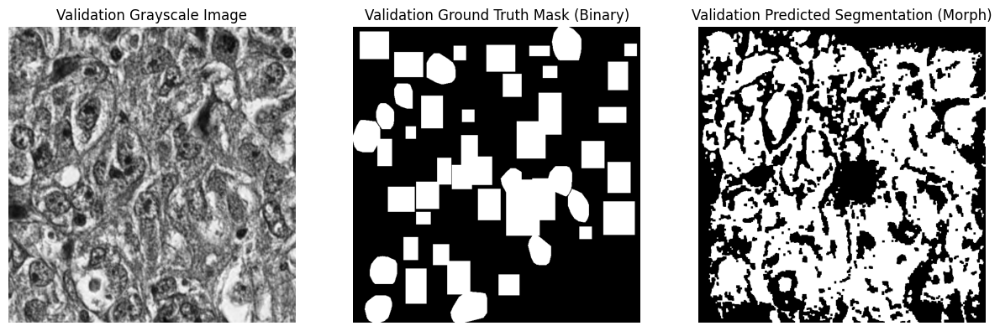

In [ ]:
# Load the validation CSV
val_df = pd.read_csv(VAL_SUBJECTS_DIR)
print("Columns in validate_subjects.csv:", val_df.columns)

# Get the validation slide names
val_slide_names = val_df['slide_name'].tolist()
print("Number of validation slide names:", len(val_slide_names))

def get_files_for_slides_val(slide_names, directory):
    matched_files = []
    all_files = os.listdir(directory)
    for slide_name in slide_names:
        for f in all_files:
            if f.startswith(slide_name):
                matched_files.append(f)
    return matched_files

# Find all validation image files in RGB_DIR
val_files = get_files_for_slides_val(val_slide_names, RGB_DIR)
print("Number of validation image files found:", len(val_files))

# Lists to store all predictions and ground-truth from every validation image
val_pred_list = []
val_true_list = []

# Define morphological kernels for open→close
kernel_open = np.ones((3,3), np.uint8)
kernel_close = np.ones((5,5), np.uint8)

for file in val_files:
    try:
        # Load validation image + mask
        gray_val, mask_val_orig = load_image_and_mask(file)
    except FileNotFoundError as e:
        print(e)
        continue

    # Binarize mask
    label_val_bin = binarize_mask(mask_val_orig)

    # Extract features for all pixels
    feat_val = extract_features(gray_val, add_texture=True)

    # Predict pixel labels
    pred_val = rf.predict(feat_val)

    # Reshape to match mask
    pred_mask_val = pred_val.reshape(label_val_bin.shape)

    # Morphological post-processing: open to close
    pred_mask_open = cv2.morphologyEx(pred_mask_val.astype(np.uint8), cv2.MORPH_OPEN, kernel_open)
    pred_mask_morphed = cv2.morphologyEx(pred_mask_open, cv2.MORPH_CLOSE, kernel_close)

    # Flatten and accumulate predictions + ground truth
    val_pred_list.append(pred_mask_morphed.flatten())
    val_true_list.append(label_val_bin.flatten())

# After processing all validation images we do the following
if len(val_pred_list) > 0:
    all_val_preds = np.concatenate(val_pred_list, axis=0)
    all_val_trues = np.concatenate(val_true_list, axis=0)

    # Compute overall validation accuracy
    val_acc = accuracy_score(all_val_trues, all_val_preds)
    print("Overall Validation Accuracy:", val_acc)
    print("Validation Classification Report:")
    print(classification_report(all_val_trues, all_val_preds))
else:
    print("No validation data processed!")

# Visualize one validation sample
if len(val_files) > 0:
    sample_val_file = val_files[0]
    gray_val, mask_val_orig = load_image_and_mask(sample_val_file)
    label_val_bin = binarize_mask(mask_val_orig)
    feat_val = extract_features(gray_val, add_texture=True)
    pred_val = rf.predict(feat_val)
    pred_mask_val = pred_val.reshape(label_val_bin.shape)

    # Morphological open to close
    pred_mask_open = cv2.morphologyEx(pred_mask_val.astype(np.uint8), cv2.MORPH_OPEN, kernel_open)
    pred_mask_morphed = cv2.morphologyEx(pred_mask_open, cv2.MORPH_CLOSE, kernel_close)

    plt.figure(figsize=(15,5))

    plt.subplot(1,3,1)
    plt.title("Validation Grayscale Image")
    plt.imshow(gray_val, cmap='gray')
    plt.axis('off')

    plt.subplot(1,3,2)
    plt.title("Validation Ground Truth Mask (Binary)")
    plt.imshow(label_val_bin, cmap='gray')
    plt.axis('off')

    plt.subplot(1,3,3)
    plt.title("Validation Predicted Segmentation (Morph)")
    plt.imshow(pred_mask_morphed, cmap='gray')
    plt.axis('off')

    plt.show()


### 4.2.4 Compare performance of unsupervised and supervised segmentation methods

Comparing supervised and unsupervised segmentation methods...
Selected 5 files for comparison

Processing file 1/5: TCGA-A2-A3XY-DX1_id-5ea40ad5ddda5f8398994b3f_left-80108_top-39320_bottom-39621_right-80404.png
  Running supervised segmentation...
  Running unsupervised segmentation...
  Metrics for TCGA-A2-A3XY-DX1_id-5ea40ad5ddda5f8398994b3f_left-80108_top-39320_bottom-39621_right-80404.png:
    Supervised   - IoU: 0.560, Precision: 0.659, Recall: 0.789, F1: 0.718
    Unsupervised - IoU: 0.273, Precision: 0.710, Recall: 0.307, F1: 0.429
    Difference (Sup - Unsup): IoU: 0.287, F1: 0.289


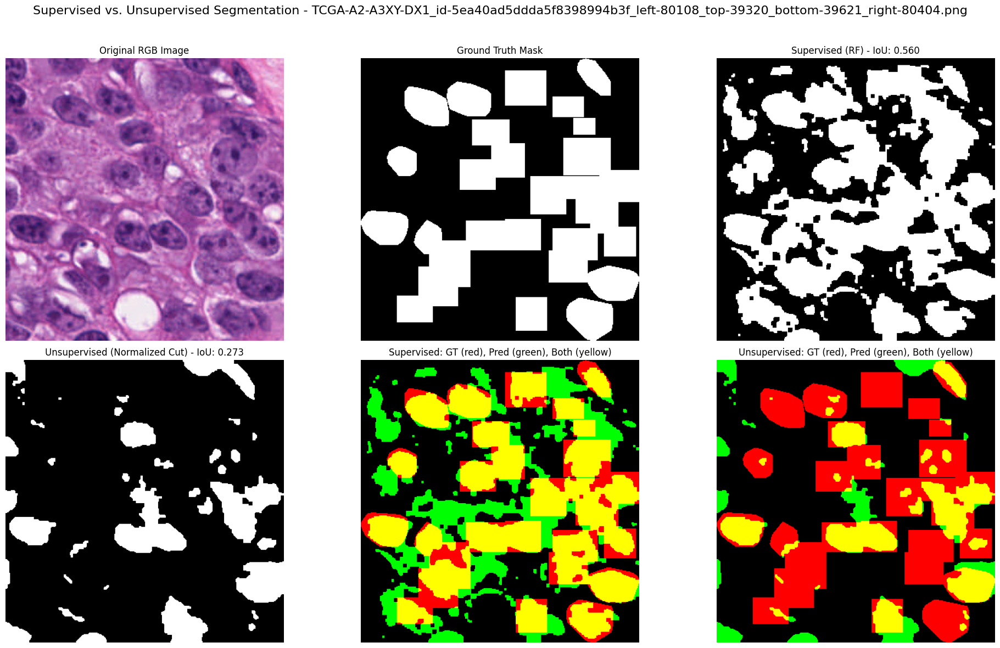


Processing file 2/5: TCGA-AN-A0AT-DX1_id-5ea40a18ddda5f839898a4f0_left-34231_top-36747_bottom-37059_right-34531.png
  Running supervised segmentation...
  Running unsupervised segmentation...
  Metrics for TCGA-AN-A0AT-DX1_id-5ea40a18ddda5f839898a4f0_left-34231_top-36747_bottom-37059_right-34531.png:
    Supervised   - IoU: 0.412, Precision: 0.422, Recall: 0.948, F1: 0.584
    Unsupervised - IoU: 0.116, Precision: 0.340, Recall: 0.149, F1: 0.207
    Difference (Sup - Unsup): IoU: 0.297, F1: 0.377


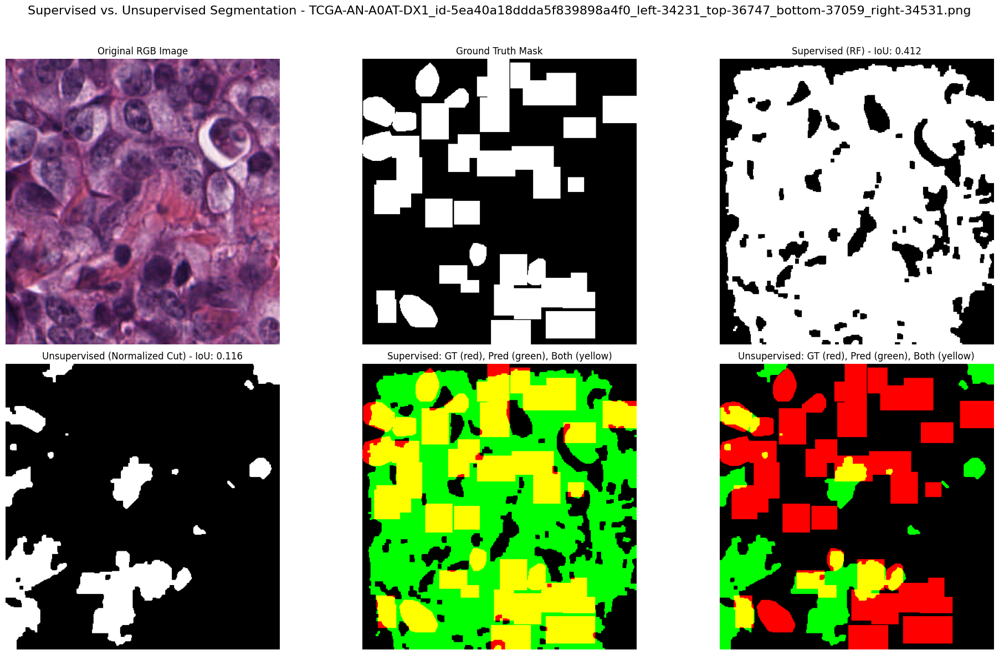


Processing file 3/5: TCGA-OL-A6VO-DX1_id-5ea4099fddda5f839898232e_left-92720_top-189758_bottom-190032_right-93037.png
  Running supervised segmentation...
  Running unsupervised segmentation...
  Metrics for TCGA-OL-A6VO-DX1_id-5ea4099fddda5f839898232e_left-92720_top-189758_bottom-190032_right-93037.png:
    Supervised   - IoU: 0.543, Precision: 0.765, Recall: 0.652, F1: 0.704
    Unsupervised - IoU: 0.408, Precision: 0.633, Recall: 0.535, F1: 0.580
    Difference (Sup - Unsup): IoU: 0.135, F1: 0.124


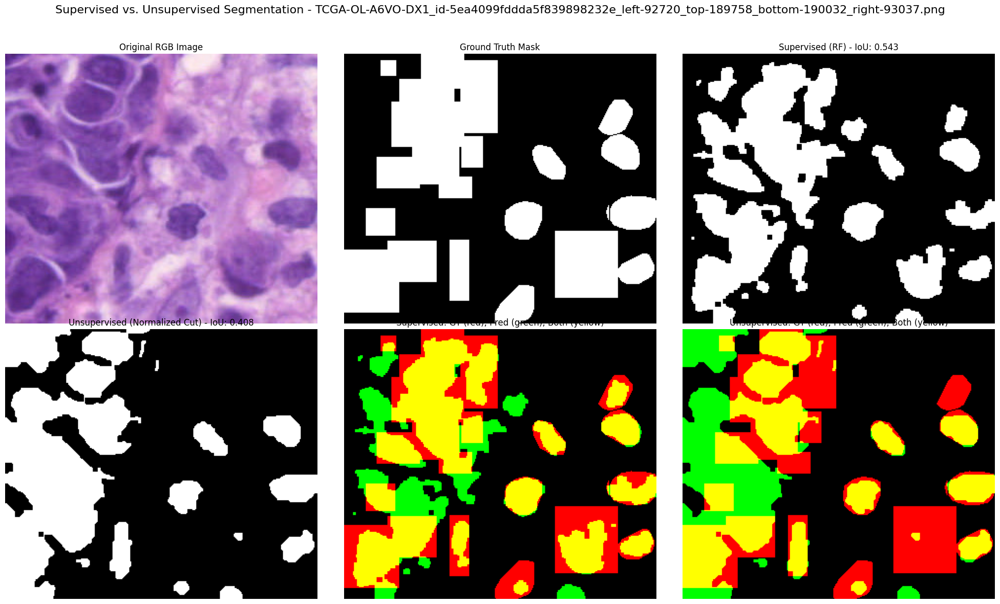


Processing file 4/5: TCGA-A2-A0YM-DX1_id-5ea40969ddda5f839897a3ea_left-50379_top-67417_bottom-67731_right-50691.png
  Running supervised segmentation...
  Running unsupervised segmentation...
  Metrics for TCGA-A2-A0YM-DX1_id-5ea40969ddda5f839897a3ea_left-50379_top-67417_bottom-67731_right-50691.png:
    Supervised   - IoU: 0.587, Precision: 0.636, Recall: 0.884, F1: 0.740
    Unsupervised - IoU: 0.272, Precision: 0.616, Recall: 0.327, F1: 0.427
    Difference (Sup - Unsup): IoU: 0.315, F1: 0.312


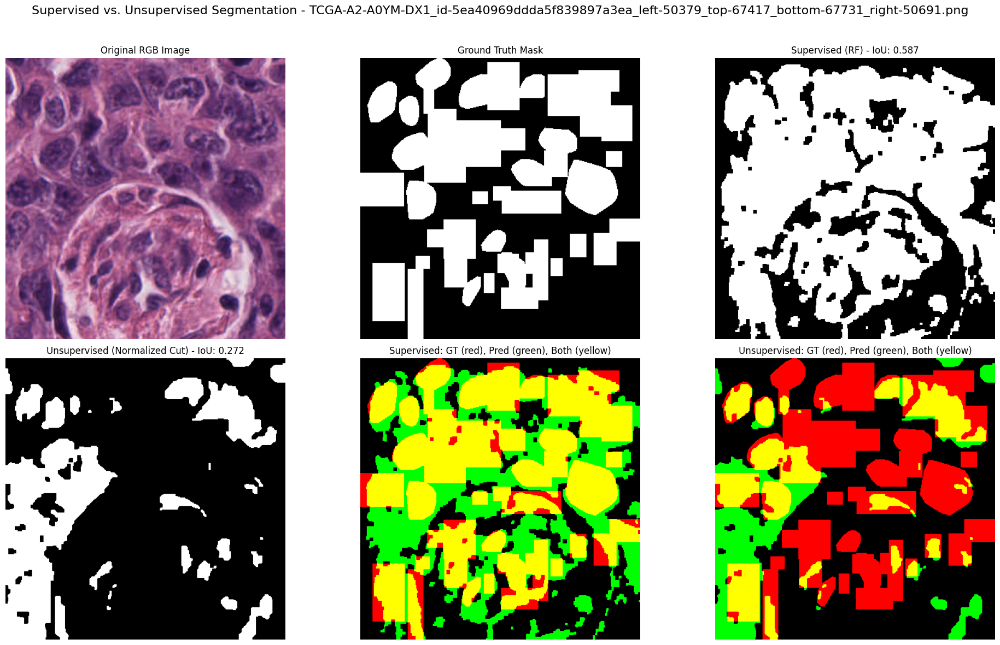


Processing file 5/5: TCGA-A2-A0YM-DX1_id-5ea40969ddda5f839897a3ea_left-45789_top-68397_bottom-68717_right-46089.png
  Running supervised segmentation...
  Running unsupervised segmentation...
  Metrics for TCGA-A2-A0YM-DX1_id-5ea40969ddda5f839897a3ea_left-45789_top-68397_bottom-68717_right-46089.png:
    Supervised   - IoU: 0.499, Precision: 0.554, Recall: 0.835, F1: 0.666
    Unsupervised - IoU: 0.324, Precision: 0.502, Recall: 0.477, F1: 0.489
    Difference (Sup - Unsup): IoU: 0.175, F1: 0.176


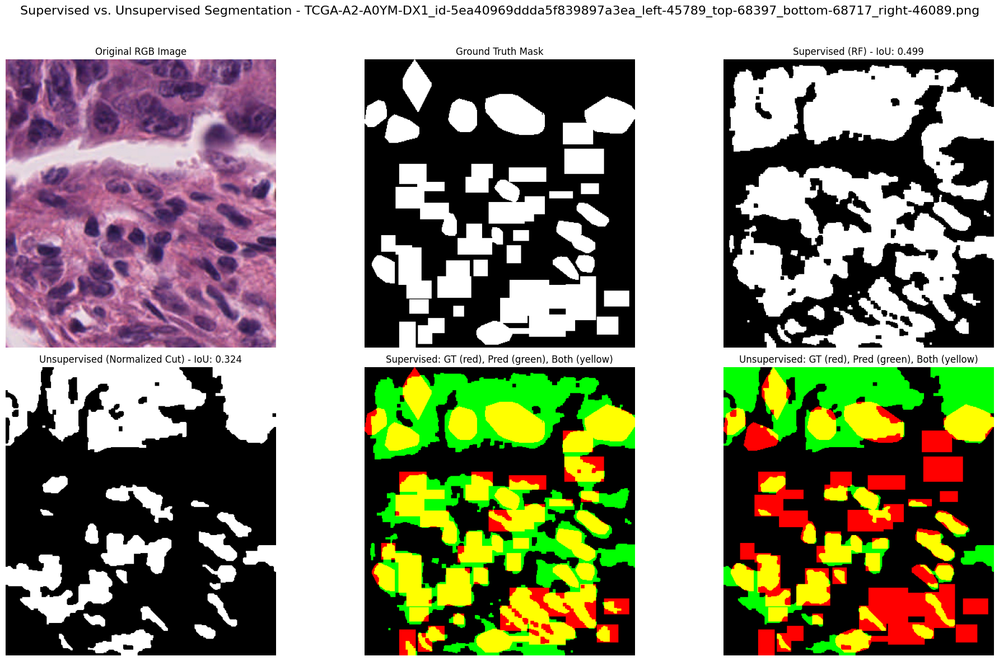


SUMMARY OF SEGMENTATION PERFORMANCE
Metric          Supervised      Unsupervised    Difference     
------------------------------------------------------------
IoU             0.5202          0.2785          0.2417
Precision       0.6071          0.5602          0.0468
Recall          0.8214          0.3591          0.4622
F1 Score        0.6822          0.4265          0.2557


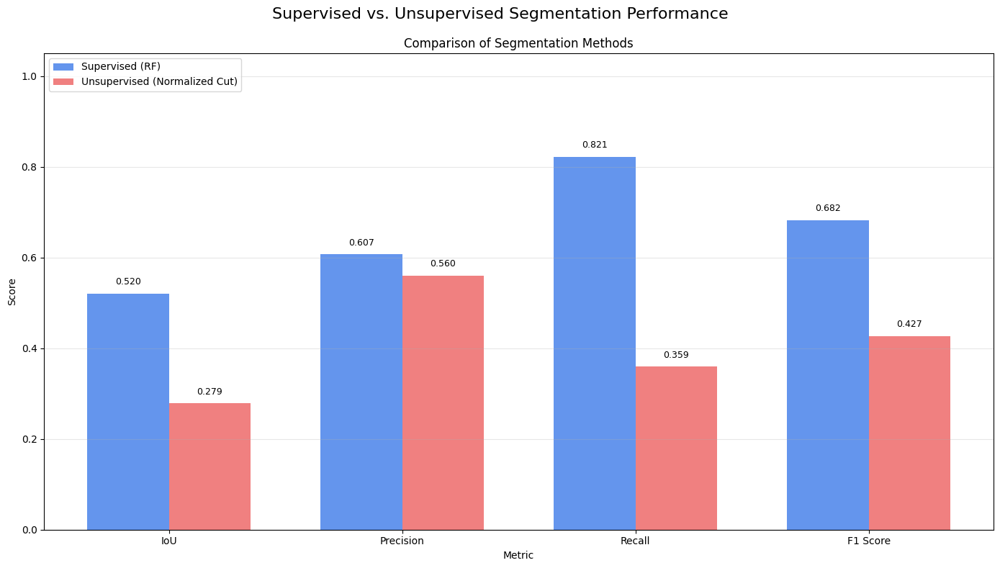

In [ ]:
def get_files_for_slides_val(slide_names, directory):
    matched_files = []
    all_files = os.listdir(directory)
    for slide_name in slide_names:
        for f in all_files:
            if f.startswith(slide_name):
                matched_files.append(f)
    return matched_files


def get_files_for_slides(slide_names, directory):
    matched_files = []
    all_files = os.listdir(directory)
    for slide_name in slide_names:
        for f in all_files:
            if f.startswith(slide_name):
                matched_files.append(f)
    return matched_files

# The function we have here aligns image and mask by cropping to the smallest dimensions
def align_image_and_mask(gray_image, label_mask):
    h_img, w_img = gray_image.shape
    h_mask, w_mask = label_mask.shape
    new_h = min(h_img, h_mask)
    new_w = min(w_img, w_mask)
    return gray_image[:new_h, :new_w], label_mask[:new_h, :new_w]

# load image and mask, convert image to grayscale, and align shapes
def load_image_and_mask(filename):
    rgb_path = os.path.join(RGB_DIR, filename)
    mask_path = os.path.join(MASK_DIR, filename)

    image = cv2.imread(rgb_path, cv2.IMREAD_COLOR)
    mask = cv2.imread(mask_path, cv2.IMREAD_UNCHANGED)
    if image is None or mask is None:
        raise FileNotFoundError(f"could not load image or mask for: {filename}")

    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # If mask has multiple channels, we use the first channel
    if len(mask.shape) == 3:
        label_mask = mask[:, :, 0]
    else:
        label_mask = mask

    gray_aligned, mask_aligned = align_image_and_mask(gray_image, label_mask)
    return gray_aligned, mask_aligned

# Compute local mean and std in a ksize x ksize window
def local_mean_std(gray_image, ksize=3):
    mean_image = cv2.blur(gray_image.astype(np.float32), (ksize, ksize))
    sq_mean = cv2.blur((gray_image**2).astype(np.float32), (ksize, ksize))
    var_image = sq_mean - (mean_image**2)
    var_image[var_image < 0] = 0
    std_image = np.sqrt(var_image)
    return mean_image, std_image

# Compute gradient magnitude using sobel filters
def gradient_magnitude(gray_image):
    gx = cv2.Sobel(gray_image, cv2.CV_32F, 1, 0, ksize=3)
    gy = cv2.Sobel(gray_image, cv2.CV_32F, 0, 1, ksize=3)
    mag = cv2.magnitude(gx, gy)
    return mag

# Extract pixel-level features, with add_texture true, returns 6 features:
# Intensity, x, y, local mean, local std, and gradient magnitude.
def extract_features(gray_image, add_texture=True):
    h, w = gray_image.shape
    intensity = gray_image.flatten()
    x_coords, y_coords = np.meshgrid(np.arange(w), np.arange(h))
    x_coords = x_coords.flatten()
    y_coords = y_coords.flatten()

    if not add_texture:
        features = np.stack([intensity, x_coords, y_coords], axis=1)
        return features

    mean_img, std_img = local_mean_std(gray_image, ksize=3)  # change ksize if needed
    grad_img = gradient_magnitude(gray_image)
    mean_flat = mean_img.flatten()
    std_flat = std_img.flatten()
    grad_flat = grad_img.flatten()

    features = np.stack([intensity, x_coords, y_coords, mean_flat, std_flat, grad_flat], axis=1)
    return features

# Binarize mask: convert all nonzero labels to 1 (foreground)
def binarize_mask(label_mask):
    binary = np.where(label_mask > 2, 1, 0).astype(np.uint8)
    return binary


def compare_supervised_vs_unsupervised(num_samples=3):
    """
    Compare supervised and unsupervised segmentation methods on validation data
    both qualitatively and quantitatively
    """
    import os
    import numpy as np
    import cv2
    import matplotlib.pyplot as plt
    from skimage import measure
    from skimage.segmentation import felzenszwalb
    from skimage.util import img_as_float
    import random
    import pandas as pd
    import time

    print("Comparing supervised and unsupervised segmentation methods...")
    start_time = time.time()

    # Load validation images
    val_df = pd.read_csv(VAL_SUBJECTS_DIR)
    val_slide_names = val_df['slide_name'].tolist()
    val_files = get_files_for_slides_val(val_slide_names, RGB_DIR)

    if len(val_files) == 0:
        print("No validation files found!")
        return

    random.seed(7)  # For reproducibility

    # Select random samples
    if len(val_files) > num_samples:
        sample_files = random.sample(val_files, num_samples)
    else:
        sample_files = val_files[:num_samples]

    print(f"Selected {len(sample_files)} files for comparison")

    # Morphological kernels
    kernel_open = np.ones((3,3), np.uint8)
    kernel_close = np.ones((5,5), np.uint8)

    # Summary statistics
    summary_stats = {
        'supervised': {
            'iou_scores': [],
            'precision_scores': [],
            'recall_scores': [],
            'f1_scores': []
        },
        'unsupervised': {
            'iou_scores': [],
            'precision_scores': [],
            'recall_scores': [],
            'f1_scores': []
        }
    }

    for file_idx, file in enumerate(sample_files):
        try:
            print(f"\nProcessing file {file_idx+1}/{len(sample_files)}: {file}")

            # Load image and mask
            gray_val, mask_val = load_image_and_mask(file)
            if gray_val is None or mask_val is None:
                print(f"  Skipping file: could not load image or mask")
                continue

            # Get RGB version for visualization
            rgb_path = os.path.join(RGB_DIR, file)
            rgb_img = cv2.imread(rgb_path)
            if rgb_img is not None:
                rgb_img = cv2.cvtColor(rgb_img, cv2.COLOR_BGR2RGB)
                # Ensure RGB has same dimensions as mask
                rgb_img = cv2.resize(rgb_img, (mask_val.shape[1], mask_val.shape[0]))
            else:
                # If RGB not available, create from grayscale
                rgb_img = cv2.cvtColor(gray_val, cv2.COLOR_GRAY2RGB)

            # Create binary mask for segmentation
            label_val_bin = binarize_mask(mask_val)

            # Method 1: SUPERVISED (Random Forest)
            print("  Running supervised segmentation...")
            # Extract features
            feat_val = extract_features(gray_val, add_texture=True)

            # Predict with Random Forest
            pred_val_sup = rf.predict(feat_val)
            pred_mask_sup = pred_val_sup.reshape(gray_val.shape)

            # Apply morphological operations
            pred_mask_sup_open = cv2.morphologyEx(pred_mask_sup.astype(np.uint8),
                                               cv2.MORPH_OPEN, kernel_open)
            pred_mask_sup_morphed = cv2.morphologyEx(pred_mask_sup_open,
                                                 cv2.MORPH_CLOSE, kernel_close)

            # Method 2: UNSUPERVISED (using normalized cut segmentation)
            print("  Running unsupervised segmentation...")

            # Prepare the grayscale image for normalized cut
            gray_float = img_as_float(gray_val)

            # Apply normalized cut segmentation
            segments = felzenszwalb(gray_float, scale=100, sigma=0.8, min_size=50)

            # Create binary mask from segments - we need to determine which segments are foreground (nuclei)
            # 1. Calculate mean intensity for each segment
            segment_means = np.zeros(segments.max() + 1)
            for i in range(segments.max() + 1):
                segment_mask = segments == i
                segment_means[i] = np.mean(gray_val[segment_mask])

            # 2. Find threshold to separate foreground and background segments
            # Lower intensity usually indicates nuclei in H&E images (nuclei are darker)
            global_mean = np.mean(gray_val)
            global_std = np.std(gray_val)
            threshold = global_mean - 0.5 * global_std

            # 3. Create binary mask (1 for segments likely to be nuclei, 0 for background)
            pred_mask_unsup = np.zeros_like(segments, dtype=np.uint8)
            for i in range(segments.max() + 1):
                if segment_means[i] < threshold:  # Dark segments are likely nuclei
                    pred_mask_unsup[segments == i] = 1

            # Apply the same morphological operations for fair comparison
            pred_mask_unsup_open = cv2.morphologyEx(pred_mask_unsup,
                                                 cv2.MORPH_OPEN, kernel_open)
            pred_mask_unsup_morphed = cv2.morphologyEx(pred_mask_unsup_open,
                                                    cv2.MORPH_CLOSE, kernel_close)

            # Calculate quantitative metrics
            # For IoU, we calculate at image level
            sup_iou = np.sum(np.logical_and(label_val_bin, pred_mask_sup_morphed)) / \
                      np.sum(np.logical_or(label_val_bin, pred_mask_sup_morphed))

            unsup_iou = np.sum(np.logical_and(label_val_bin, pred_mask_unsup_morphed)) / \
                        np.sum(np.logical_or(label_val_bin, pred_mask_unsup_morphed))

            # Calculate precision, recall, F1 score
            sup_tp = np.sum(np.logical_and(label_val_bin == 1, pred_mask_sup_morphed == 1))
            sup_fp = np.sum(np.logical_and(label_val_bin == 0, pred_mask_sup_morphed == 1))
            sup_fn = np.sum(np.logical_and(label_val_bin == 1, pred_mask_sup_morphed == 0))

            unsup_tp = np.sum(np.logical_and(label_val_bin == 1, pred_mask_unsup_morphed == 1))
            unsup_fp = np.sum(np.logical_and(label_val_bin == 0, pred_mask_unsup_morphed == 1))
            unsup_fn = np.sum(np.logical_and(label_val_bin == 1, pred_mask_unsup_morphed == 0))

            sup_precision = sup_tp / (sup_tp + sup_fp) if (sup_tp + sup_fp) > 0 else 0
            sup_recall = sup_tp / (sup_tp + sup_fn) if (sup_tp + sup_fn) > 0 else 0
            sup_f1 = 2 * sup_precision * sup_recall / (sup_precision + sup_recall) if (sup_precision + sup_recall) > 0 else 0

            unsup_precision = unsup_tp / (unsup_tp + unsup_fp) if (unsup_tp + unsup_fp) > 0 else 0
            unsup_recall = unsup_tp / (unsup_tp + unsup_fn) if (unsup_tp + unsup_fn) > 0 else 0
            unsup_f1 = 2 * unsup_precision * unsup_recall / (unsup_precision + unsup_recall) if (unsup_precision + unsup_recall) > 0 else 0

            # Store metrics
            summary_stats['supervised']['iou_scores'].append(sup_iou)
            summary_stats['supervised']['precision_scores'].append(sup_precision)
            summary_stats['supervised']['recall_scores'].append(sup_recall)
            summary_stats['supervised']['f1_scores'].append(sup_f1)

            summary_stats['unsupervised']['iou_scores'].append(unsup_iou)
            summary_stats['unsupervised']['precision_scores'].append(unsup_precision)
            summary_stats['unsupervised']['recall_scores'].append(unsup_recall)
            summary_stats['unsupervised']['f1_scores'].append(unsup_f1)

            # Print metrics for this image
            print(f"  Metrics for {os.path.basename(file)}:")
            print(f"    Supervised   - IoU: {sup_iou:.3f}, Precision: {sup_precision:.3f}, Recall: {sup_recall:.3f}, F1: {sup_f1:.3f}")
            print(f"    Unsupervised - IoU: {unsup_iou:.3f}, Precision: {unsup_precision:.3f}, Recall: {unsup_recall:.3f}, F1: {unsup_f1:.3f}")
            print(f"    Difference (Sup - Unsup): IoU: {sup_iou - unsup_iou:.3f}, F1: {sup_f1 - unsup_f1:.3f}")

            # Create visualization of results
            plt.figure(figsize=(20, 12))
            plt.suptitle(f"Supervised vs. Unsupervised Segmentation - {os.path.basename(file)}", fontsize=16)

            # Original image
            plt.subplot(2, 3, 1)
            plt.imshow(rgb_img)
            plt.title("Original RGB Image")
            plt.axis('off')

            # Ground truth mask
            plt.subplot(2, 3, 2)
            plt.imshow(label_val_bin, cmap='gray')
            plt.title("Ground Truth Mask")
            plt.axis('off')

            # Supervised segmentation result
            plt.subplot(2, 3, 3)
            plt.imshow(pred_mask_sup_morphed, cmap='gray')
            plt.title(f"Supervised (RF) - IoU: {sup_iou:.3f}")
            plt.axis('off')

            # Unsupervised segmentation result
            plt.subplot(2, 3, 4)
            plt.imshow(pred_mask_unsup_morphed, cmap='gray')
            plt.title(f"Unsupervised (Normalized Cut) - IoU: {unsup_iou:.3f}")
            plt.axis('off')

            # Supervised overlap with ground truth
            plt.subplot(2, 3, 5)
            sup_overlap_img = np.zeros((*label_val_bin.shape, 3), dtype=np.uint8)
            sup_overlap_img[label_val_bin == 1] = [255, 0, 0]  # Red for ground truth
            sup_overlap_img[pred_mask_sup_morphed == 1] = [0, 255, 0]  # Green for prediction
            sup_overlap_img[(label_val_bin == 1) & (pred_mask_sup_morphed == 1)] = [255, 255, 0]  # Yellow for overlap
            plt.imshow(sup_overlap_img)
            plt.title("Supervised: GT (red), Pred (green), Both (yellow)")
            plt.axis('off')

            # Unsupervised overlap with ground truth
            plt.subplot(2, 3, 6)
            unsup_overlap_img = np.zeros((*label_val_bin.shape, 3), dtype=np.uint8)
            unsup_overlap_img[label_val_bin == 1] = [255, 0, 0]  # Red for ground truth
            unsup_overlap_img[pred_mask_unsup_morphed == 1] = [0, 255, 0]  # Green for prediction
            unsup_overlap_img[(label_val_bin == 1) & (pred_mask_unsup_morphed == 1)] = [255, 255, 0]  # Yellow for overlap
            plt.imshow(unsup_overlap_img)
            plt.title("Unsupervised: GT (red), Pred (green), Both (yellow)")
            plt.axis('off')

            plt.tight_layout()
            plt.subplots_adjust(top=0.9)
            plt.show()

        except Exception as e:
            print(f"Error processing {file}: {e}")
            import traceback
            traceback.print_exc()

    # Calculate overall statistics
    if len(summary_stats['supervised']['iou_scores']) > 0:
        sup_mean_iou = np.mean(summary_stats['supervised']['iou_scores'])
        sup_mean_prec = np.mean(summary_stats['supervised']['precision_scores'])
        sup_mean_recall = np.mean(summary_stats['supervised']['recall_scores'])
        sup_mean_f1 = np.mean(summary_stats['supervised']['f1_scores'])

        unsup_mean_iou = np.mean(summary_stats['unsupervised']['iou_scores'])
        unsup_mean_prec = np.mean(summary_stats['unsupervised']['precision_scores'])
        unsup_mean_recall = np.mean(summary_stats['unsupervised']['recall_scores'])
        unsup_mean_f1 = np.mean(summary_stats['unsupervised']['f1_scores'])

        # Print summary
        print("\n" + "="*50)
        print("SUMMARY OF SEGMENTATION PERFORMANCE")
        print("="*50)
        print(f"{'Metric':<15} {'Supervised':<15} {'Unsupervised':<15} {'Difference':<15}")
        print("-"*60)
        print(f"{'IoU':<15} {sup_mean_iou:.4f}{'':<9} {unsup_mean_iou:.4f}{'':<9} {sup_mean_iou - unsup_mean_iou:.4f}")
        print(f"{'Precision':<15} {sup_mean_prec:.4f}{'':<9} {unsup_mean_prec:.4f}{'':<9} {sup_mean_prec - unsup_mean_prec:.4f}")
        print(f"{'Recall':<15} {sup_mean_recall:.4f}{'':<9} {unsup_mean_recall:.4f}{'':<9} {sup_mean_recall - unsup_mean_recall:.4f}")
        print(f"{'F1 Score':<15} {sup_mean_f1:.4f}{'':<9} {unsup_mean_f1:.4f}{'':<9} {sup_mean_f1 - unsup_mean_f1:.4f}")
        print("="*60)

        # Visualization of overall results
        plt.figure(figsize=(14, 8))
        plt.suptitle("Supervised vs. Unsupervised Segmentation Performance", fontsize=16)

        # Bar chart comparing overall metrics
        metrics = ['IoU', 'Precision', 'Recall', 'F1 Score']
        sup_values = [sup_mean_iou, sup_mean_prec, sup_mean_recall, sup_mean_f1]
        unsup_values = [unsup_mean_iou, unsup_mean_prec, unsup_mean_recall, unsup_mean_f1]

        x = np.arange(len(metrics))
        width = 0.35

        plt.bar(x - width/2, sup_values, width, label='Supervised (RF)', color='cornflowerblue')
        plt.bar(x + width/2, unsup_values, width, label='Unsupervised (Normalized Cut)', color='lightcoral')

        # Add value labels on bars
        for i, v in enumerate(sup_values):
            plt.text(i - width/2, v + 0.02, f'{v:.3f}', ha='center', fontsize=9)

        for i, v in enumerate(unsup_values):
            plt.text(i + width/2, v + 0.02, f'{v:.3f}', ha='center', fontsize=9)

        plt.xlabel('Metric')
        plt.ylabel('Score')
        plt.title('Comparison of Segmentation Methods')
        plt.xticks(x, metrics)
        plt.ylim(0, 1.05)
        plt.legend(loc='upper left')
        plt.grid(axis='y', alpha=0.3)

        plt.tight_layout()
        plt.subplots_adjust(top=0.9)
        plt.show()

    else:
        print("\nNo valid comparisons could be made.")

    return summary_stats

# Run the comparison
comparison_results = compare_supervised_vs_unsupervised(num_samples=5)

Comparing supervised and unsupervised segmentation methods...
Selected 3 files for comparison

Processing file 1/3: TCGA-A2-A04T-DX1_id-5ea40961ddda5f8398979057_left-78272_top-39832_bottom-40101_right-78544.png
  Running supervised segmentation...
  Running K-means segmentation...
  Running normalized cut segmentation...
  Metrics for TCGA-A2-A04T-DX1_id-5ea40961ddda5f8398979057_left-78272_top-39832_bottom-40101_right-78544.png:
    Supervised   - IoU: 0.491, Precision: 0.551, Recall: 0.818, F1: 0.658
    K-means      - IoU: 0.048, Precision: 0.072, Recall: 0.127, F1: 0.092
    Norm. Cut    - IoU: 0.463, Precision: 0.524, Recall: 0.798, F1: 0.633


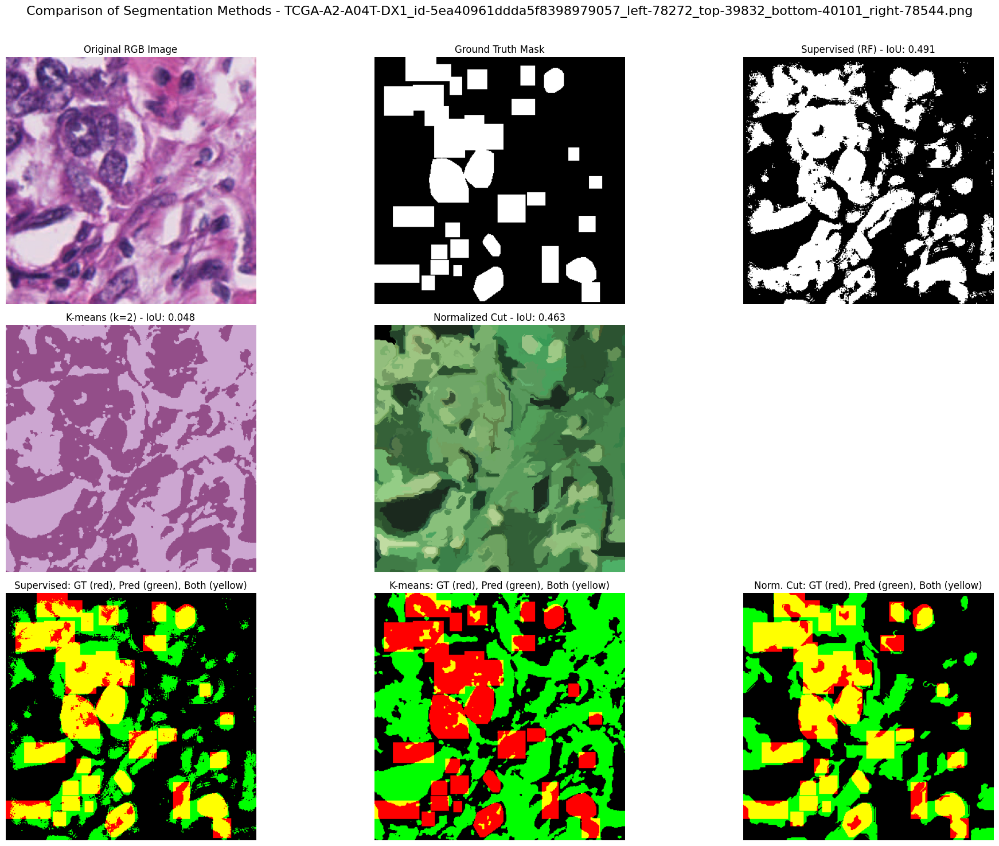


Processing file 2/3: TCGA-AR-A256-DX1_id-5ea40990ddda5f83989802f3_left-42828_top-18336_bottom-18647_right-43142.png
  Running supervised segmentation...
  Running K-means segmentation...
  Running normalized cut segmentation...
  Metrics for TCGA-AR-A256-DX1_id-5ea40990ddda5f83989802f3_left-42828_top-18336_bottom-18647_right-43142.png:
    Supervised   - IoU: 0.297, Precision: 0.742, Recall: 0.331, F1: 0.458
    K-means      - IoU: 0.199, Precision: 0.331, Recall: 0.333, F1: 0.332
    Norm. Cut    - IoU: 0.127, Precision: 0.572, Recall: 0.141, F1: 0.226


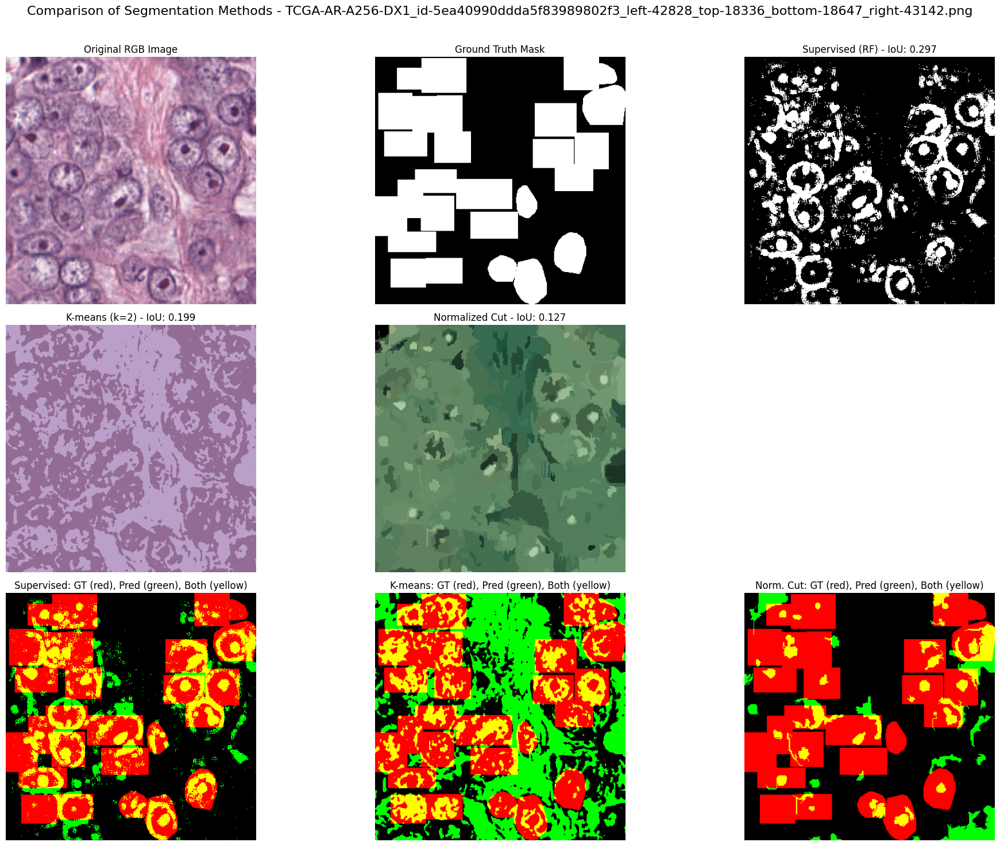


Processing file 3/3: TCGA-BH-A18V-DX1_id-5ea40b03ddda5f83989973aa_left-50531_top-50718_bottom-51028_right-50823.png
  Running supervised segmentation...


In [ ]:
def compare_supervised_vs_unsupervised(num_samples=3):
    """
    Compare supervised and unsupervised segmentation methods on validation data
    both qualitatively and quantitatively
    """
    import os
    import numpy as np
    import cv2
    import matplotlib.pyplot as plt
    import random
    import pandas as pd
    import time

    print("Comparing supervised and unsupervised segmentation methods...")
    start_time = time.time()

    # Load validation images
    val_df = pd.read_csv(VAL_SUBJECTS_DIR)
    val_slide_names = val_df['slide_name'].tolist()
    val_files = get_files_for_slides_val(val_slide_names, RGB_DIR)

    if len(val_files) == 0:
        print("No validation files found!")
        return

    random.seed(42)  # For reproducibility

    # Select random samples
    if len(val_files) > num_samples:
        sample_files = random.sample(val_files, num_samples)
    else:
        sample_files = val_files[:num_samples]

    print(f"Selected {len(sample_files)} files for comparison")

    # Summary statistics
    summary_stats = {
        'supervised': {
            'iou_scores': [],
            'precision_scores': [],
            'recall_scores': [],
            'f1_scores': []
        },
        'kmeans': {
            'iou_scores': [],
            'precision_scores': [],
            'recall_scores': [],
            'f1_scores': []
        },
        'ncut': {
            'iou_scores': [],
            'precision_scores': [],
            'recall_scores': [],
            'f1_scores': []
        }
    }

    for file_idx, file in enumerate(sample_files):
        try:
            print(f"\nProcessing file {file_idx+1}/{len(sample_files)}: {file}")

            # Load image and mask
            gray_val, mask_val = load_image_and_mask(file)
            if gray_val is None or mask_val is None:
                print(f"  Skipping file: could not load image or mask")
                continue

            # Get RGB version for visualization
            rgb_path = os.path.join(RGB_DIR, file)
            rgb_img = cv2.imread(rgb_path)
            if rgb_img is not None:
                rgb_img = cv2.cvtColor(rgb_img, cv2.COLOR_BGR2RGB)
                # Ensure RGB has same dimensions as mask
                rgb_img = cv2.resize(rgb_img, (mask_val.shape[1], mask_val.shape[0]))
            else:
                # If RGB not available, create from grayscale
                rgb_img = cv2.cvtColor(gray_val, cv2.COLOR_GRAY2RGB)

            # Create binary mask for segmentation
            label_val_bin = binarize_mask(mask_val)

            # METHOD 1: SUPERVISED (Random Forest)
            print("  Running supervised segmentation...")
            # Extract features
            feat_val = extract_features(gray_val, add_texture=True)

            # Predict with Random Forest
            pred_val_sup = rf.predict(feat_val)
            pred_mask_sup = pred_val_sup.reshape(gray_val.shape)

            # METHOD 2: K-MEANS CLUSTERING
            print("  Running K-means segmentation...")
            # Use optimal_k=2 for binary segmentation (nuclei vs background)
            optimal_k = 2

            # Apply K-means clustering on the RGB image
            kmeans_result = k_mean_clustering(rgb_img, optimal_k)

            # For evaluation, we'll use the raw k-means result directly
            pred_mask_kmeans = kmeans_result

            # METHOD 3: NORMALIZED CUT (Felzenszwalb)
            print("  Running normalized cut segmentation...")
            ncut_result, _ = normalized_cut_segmentation(rgb_img)

            # For evaluation, we'll use the raw normalized cut result directly
            pred_mask_ncut = ncut_result

            # Calculate quantitative metrics for all methods
            # For IoU and other metrics, we need to compare with binary ground truth
            # Convert the outputs to grayscale for consistent comparison
            if len(pred_mask_kmeans.shape) == 3:
                pred_mask_kmeans_gray = cv2.cvtColor(pred_mask_kmeans, cv2.COLOR_RGB2GRAY)
            else:
                pred_mask_kmeans_gray = pred_mask_kmeans

            if len(pred_mask_ncut.shape) == 3:
                pred_mask_ncut_gray = cv2.cvtColor(pred_mask_ncut, cv2.COLOR_RGB2GRAY)
            else:
                pred_mask_ncut_gray = pred_mask_ncut

            # Binary versions for overlap visualization
            _, sup_bin = cv2.threshold(pred_mask_sup.astype(np.uint8)*255, 127, 255, cv2.THRESH_BINARY)
            _, kmeans_bin = cv2.threshold(pred_mask_kmeans_gray, 127, 255, cv2.THRESH_BINARY)
            _, ncut_bin = cv2.threshold(pred_mask_ncut_gray, 127, 255, cv2.THRESH_BINARY)

            # For calculating metrics
            sup_bin = sup_bin / 255
            kmeans_bin = kmeans_bin / 255
            ncut_bin = ncut_bin / 255

            # Calculate IoU scores
            sup_iou = np.sum(np.logical_and(label_val_bin, sup_bin)) / \
                      np.sum(np.logical_or(label_val_bin, sup_bin))

            kmeans_iou = np.sum(np.logical_and(label_val_bin, kmeans_bin)) / \
                         np.sum(np.logical_or(label_val_bin, kmeans_bin))

            ncut_iou = np.sum(np.logical_and(label_val_bin, ncut_bin)) / \
                       np.sum(np.logical_or(label_val_bin, ncut_bin))

            # Calculate precision, recall, F1 score for Supervised
            sup_tp = np.sum(np.logical_and(label_val_bin == 1, sup_bin == 1))
            sup_fp = np.sum(np.logical_and(label_val_bin == 0, sup_bin == 1))
            sup_fn = np.sum(np.logical_and(label_val_bin == 1, sup_bin == 0))

            sup_precision = sup_tp / (sup_tp + sup_fp) if (sup_tp + sup_fp) > 0 else 0
            sup_recall = sup_tp / (sup_tp + sup_fn) if (sup_tp + sup_fn) > 0 else 0
            sup_f1 = 2 * sup_precision * sup_recall / (sup_precision + sup_recall) if (sup_precision + sup_recall) > 0 else 0

            # Calculate precision, recall, F1 score for K-means
            kmeans_tp = np.sum(np.logical_and(label_val_bin == 1, kmeans_bin == 1))
            kmeans_fp = np.sum(np.logical_and(label_val_bin == 0, kmeans_bin == 1))
            kmeans_fn = np.sum(np.logical_and(label_val_bin == 1, kmeans_bin == 0))

            kmeans_precision = kmeans_tp / (kmeans_tp + kmeans_fp) if (kmeans_tp + kmeans_fp) > 0 else 0
            kmeans_recall = kmeans_tp / (kmeans_tp + kmeans_fn) if (kmeans_tp + kmeans_fn) > 0 else 0
            kmeans_f1 = 2 * kmeans_precision * kmeans_recall / (kmeans_precision + kmeans_recall) if (kmeans_precision + kmeans_recall) > 0 else 0

            # Calculate precision, recall, F1 score for Normalized Cut
            ncut_tp = np.sum(np.logical_and(label_val_bin == 1, ncut_bin == 1))
            ncut_fp = np.sum(np.logical_and(label_val_bin == 0, ncut_bin == 1))
            ncut_fn = np.sum(np.logical_and(label_val_bin == 1, ncut_bin == 0))

            ncut_precision = ncut_tp / (ncut_tp + ncut_fp) if (ncut_tp + ncut_fp) > 0 else 0
            ncut_recall = ncut_tp / (ncut_tp + ncut_fn) if (ncut_tp + ncut_fn) > 0 else 0
            ncut_f1 = 2 * ncut_precision * ncut_recall / (ncut_precision + ncut_recall) if (ncut_precision + ncut_recall) > 0 else 0

            # Store metrics
            summary_stats['supervised']['iou_scores'].append(sup_iou)
            summary_stats['supervised']['precision_scores'].append(sup_precision)
            summary_stats['supervised']['recall_scores'].append(sup_recall)
            summary_stats['supervised']['f1_scores'].append(sup_f1)

            summary_stats['kmeans']['iou_scores'].append(kmeans_iou)
            summary_stats['kmeans']['precision_scores'].append(kmeans_precision)
            summary_stats['kmeans']['recall_scores'].append(kmeans_recall)
            summary_stats['kmeans']['f1_scores'].append(kmeans_f1)

            summary_stats['ncut']['iou_scores'].append(ncut_iou)
            summary_stats['ncut']['precision_scores'].append(ncut_precision)
            summary_stats['ncut']['recall_scores'].append(ncut_recall)
            summary_stats['ncut']['f1_scores'].append(ncut_f1)

            # Print metrics for this image
            print(f"  Metrics for {os.path.basename(file)}:")
            print(f"    Supervised   - IoU: {sup_iou:.3f}, Precision: {sup_precision:.3f}, Recall: {sup_recall:.3f}, F1: {sup_f1:.3f}")
            print(f"    K-means      - IoU: {kmeans_iou:.3f}, Precision: {kmeans_precision:.3f}, Recall: {kmeans_recall:.3f}, F1: {kmeans_f1:.3f}")
            print(f"    Norm. Cut    - IoU: {ncut_iou:.3f}, Precision: {ncut_precision:.3f}, Recall: {ncut_recall:.3f}, F1: {ncut_f1:.3f}")

            # Create visualization of results
            plt.figure(figsize=(20, 15))
            plt.suptitle(f"Comparison of Segmentation Methods - {os.path.basename(file)}", fontsize=16)

            # Original image
            plt.subplot(3, 3, 1)
            plt.imshow(rgb_img)
            plt.title("Original RGB Image")
            plt.axis('off')

            # Ground truth mask
            plt.subplot(3, 3, 2)
            plt.imshow(label_val_bin, cmap='gray')
            plt.title("Ground Truth Mask")
            plt.axis('off')

            # Supervised segmentation result
            plt.subplot(3, 3, 3)
            plt.imshow(pred_mask_sup, cmap='gray')
            plt.title(f"Supervised (RF) - IoU: {sup_iou:.3f}")
            plt.axis('off')

            # K-means result
            plt.subplot(3, 3, 4)
            plt.imshow(pred_mask_kmeans)
            plt.title(f"K-means (k={optimal_k}) - IoU: {kmeans_iou:.3f}")
            plt.axis('off')

            # Normalized Cut result
            plt.subplot(3, 3, 5)
            plt.imshow(pred_mask_ncut)
            plt.title(f"Normalized Cut - IoU: {ncut_iou:.3f}")
            plt.axis('off')

            # Supervised overlap with ground truth
            plt.subplot(3, 3, 7)
            sup_overlap_img = np.zeros((*label_val_bin.shape, 3), dtype=np.uint8)
            sup_overlap_img[label_val_bin == 1] = [255, 0, 0]  # Red for ground truth
            sup_overlap_img[sup_bin == 1] = [0, 255, 0]  # Green for prediction
            sup_overlap_img[(label_val_bin == 1) & (sup_bin == 1)] = [255, 255, 0]  # Yellow for overlap
            plt.imshow(sup_overlap_img)
            plt.title("Supervised: GT (red), Pred (green), Both (yellow)")
            plt.axis('off')

            # K-means overlap with ground truth
            plt.subplot(3, 3, 8)
            kmeans_overlap_img = np.zeros((*label_val_bin.shape, 3), dtype=np.uint8)
            kmeans_overlap_img[label_val_bin == 1] = [255, 0, 0]  # Red for ground truth
            kmeans_overlap_img[kmeans_bin == 1] = [0, 255, 0]  # Green for prediction
            kmeans_overlap_img[(label_val_bin == 1) & (kmeans_bin == 1)] = [255, 255, 0]  # Yellow for overlap
            plt.imshow(kmeans_overlap_img)
            plt.title("K-means: GT (red), Pred (green), Both (yellow)")
            plt.axis('off')

            # Normalized Cut overlap with ground truth
            plt.subplot(3, 3, 9)
            ncut_overlap_img = np.zeros((*label_val_bin.shape, 3), dtype=np.uint8)
            ncut_overlap_img[label_val_bin == 1] = [255, 0, 0]  # Red for ground truth
            ncut_overlap_img[ncut_bin == 1] = [0, 255, 0]  # Green for prediction
            ncut_overlap_img[(label_val_bin == 1) & (ncut_bin == 1)] = [255, 255, 0]  # Yellow for overlap
            plt.imshow(ncut_overlap_img)
            plt.title("Norm. Cut: GT (red), Pred (green), Both (yellow)")
            plt.axis('off')

            plt.tight_layout()
            plt.subplots_adjust(top=0.92)
            plt.show()

        except Exception as e:
            print(f"Error processing {file}: {e}")
            import traceback
            traceback.print_exc()

    # Calculate overall statistics
    if len(summary_stats['supervised']['iou_scores']) > 0:
        sup_mean_iou = np.mean(summary_stats['supervised']['iou_scores'])
        sup_mean_prec = np.mean(summary_stats['supervised']['precision_scores'])
        sup_mean_recall = np.mean(summary_stats['supervised']['recall_scores'])
        sup_mean_f1 = np.mean(summary_stats['supervised']['f1_scores'])

        kmeans_mean_iou = np.mean(summary_stats['kmeans']['iou_scores'])
        kmeans_mean_prec = np.mean(summary_stats['kmeans']['precision_scores'])
        kmeans_mean_recall = np.mean(summary_stats['kmeans']['recall_scores'])
        kmeans_mean_f1 = np.mean(summary_stats['kmeans']['f1_scores'])

        ncut_mean_iou = np.mean(summary_stats['ncut']['iou_scores'])
        ncut_mean_prec = np.mean(summary_stats['ncut']['precision_scores'])
        ncut_mean_recall = np.mean(summary_stats['ncut']['recall_scores'])
        ncut_mean_f1 = np.mean(summary_stats['ncut']['f1_scores'])

        # Print summary
        print("\n" + "="*65)
        print("SUMMARY OF SEGMENTATION PERFORMANCE")
        print("="*65)
        print(f"{'Metric':<15} {'Supervised':<15} {'K-means':<15} {'Normalized Cut':<15}")
        print("-"*65)
        print(f"{'IoU':<15} {sup_mean_iou:.4f}{'':<9} {kmeans_mean_iou:.4f}{'':<9} {ncut_mean_iou:.4f}")
        print(f"{'Precision':<15} {sup_mean_prec:.4f}{'':<9} {kmeans_mean_prec:.4f}{'':<9} {ncut_mean_prec:.4f}")
        print(f"{'Recall':<15} {sup_mean_recall:.4f}{'':<9} {kmeans_mean_recall:.4f}{'':<9} {ncut_mean_recall:.4f}")
        print(f"{'F1 Score':<15} {sup_mean_f1:.4f}{'':<9} {kmeans_mean_f1:.4f}{'':<9} {ncut_mean_f1:.4f}")
        print("="*65)

        # Visualization of overall results
        plt.figure(figsize=(14, 8))
        plt.suptitle("Comparison of Segmentation Methods", fontsize=16)

        # Bar chart comparing overall metrics
        metrics = ['IoU', 'Precision', 'Recall', 'F1 Score']
        sup_values = [sup_mean_iou, sup_mean_prec, sup_mean_recall, sup_mean_f1]
        kmeans_values = [kmeans_mean_iou, kmeans_mean_prec, kmeans_mean_recall, kmeans_mean_f1]
        ncut_values = [ncut_mean_iou, ncut_mean_prec, ncut_mean_recall, ncut_mean_f1]

        x = np.arange(len(metrics))
        width = 0.25

        plt.bar(x - width, sup_values, width, label='Supervised (RF)', color='cornflowerblue')
        plt.bar(x, kmeans_values, width, label='K-means', color='lightcoral')
        plt.bar(x + width, ncut_values, width, label='Normalized Cut', color='mediumseagreen')

        # Add value labels on bars
        for i, v in enumerate(sup_values):
            plt.text(i - width, v + 0.02, f'{v:.3f}', ha='center', fontsize=9)

        for i, v in enumerate(kmeans_values):
            plt.text(i, v + 0.02, f'{v:.3f}', ha='center', fontsize=9)

        for i, v in enumerate(ncut_values):
            plt.text(i + width, v + 0.02, f'{v:.3f}', ha='center', fontsize=9)

        plt.xlabel('Metric')
        plt.ylabel('Score')
        plt.title('Comparison of Segmentation Methods')
        plt.xticks(x, metrics)
        plt.ylim(0, 1.05)
        plt.legend(loc='upper left')
        plt.grid(axis='y', alpha=0.3)

        plt.tight_layout()
        plt.subplots_adjust(top=0.9)
        plt.show()

    else:
        print("\nNo valid comparisons could be made.")

    return summary_stats

# Run the comparison
comparison_results = compare_supervised_vs_unsupervised(num_samples=3)

Generally, the supervised approach outperformed both unsupervised methods quite significantly. The best indicators of this are the DICE/F1 score and IoU, which are significantly higher for our random forest based model.



Comparing supervised and unsupervised segmentation methods...
Selected 3 files for comparison

Processing file 1/3: TCGA-A2-A04T-DX1_id-5ea40961ddda5f8398979057_left-78272_top-39832_bottom-40101_right-78544.png
  Running supervised segmentation...
  Running unsupervised segmentation with K-means...


/usr/local/lib/python3.11/dist-packages/numpy/_core/fromnumeric.py:3596: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/dist-packages/numpy/_core/_methods.py:138: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


  Metrics for TCGA-A2-A04T-DX1_id-5ea40961ddda5f8398979057_left-78272_top-39832_bottom-40101_right-78544.png:
    Supervised   - IoU: 0.512, Precision: 0.576, Recall: 0.822, F1: 0.677
    K-means      - IoU: 0.000, Precision: 0.000, Recall: 0.000, F1: 0.000
    Difference (Sup - K-means): IoU: 0.512, F1: 0.677


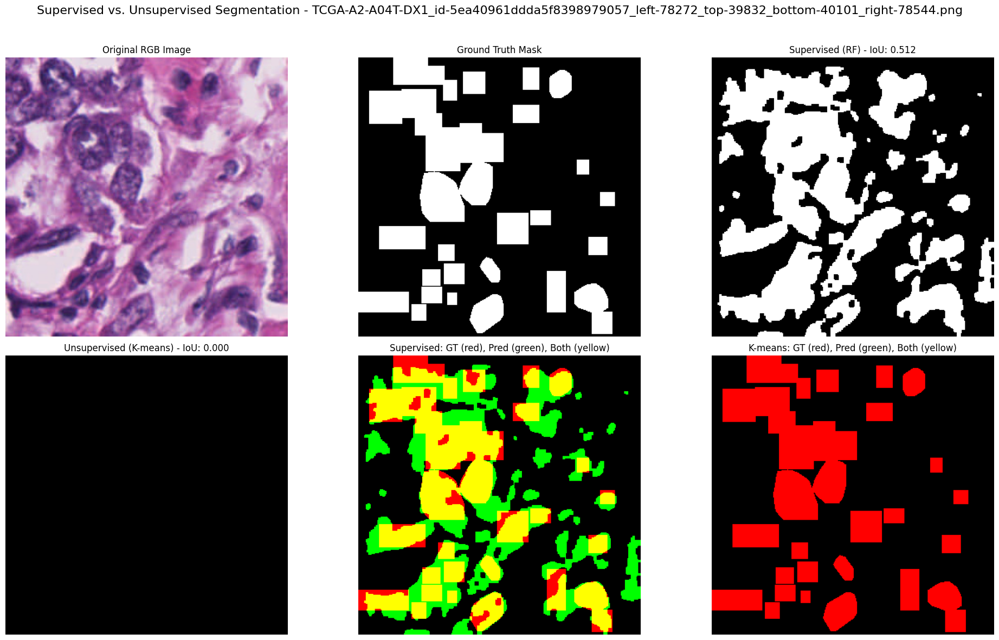


Processing file 2/3: TCGA-AR-A256-DX1_id-5ea40990ddda5f83989802f3_left-42828_top-18336_bottom-18647_right-43142.png
  Running supervised segmentation...
  Running unsupervised segmentation with K-means...


/usr/local/lib/python3.11/dist-packages/numpy/_core/fromnumeric.py:3596: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/dist-packages/numpy/_core/_methods.py:138: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


  Metrics for TCGA-AR-A256-DX1_id-5ea40990ddda5f83989802f3_left-42828_top-18336_bottom-18647_right-43142.png:
    Supervised   - IoU: 0.269, Precision: 0.773, Recall: 0.292, F1: 0.423
    K-means      - IoU: 0.000, Precision: 0.000, Recall: 0.000, F1: 0.000
    Difference (Sup - K-means): IoU: 0.269, F1: 0.423


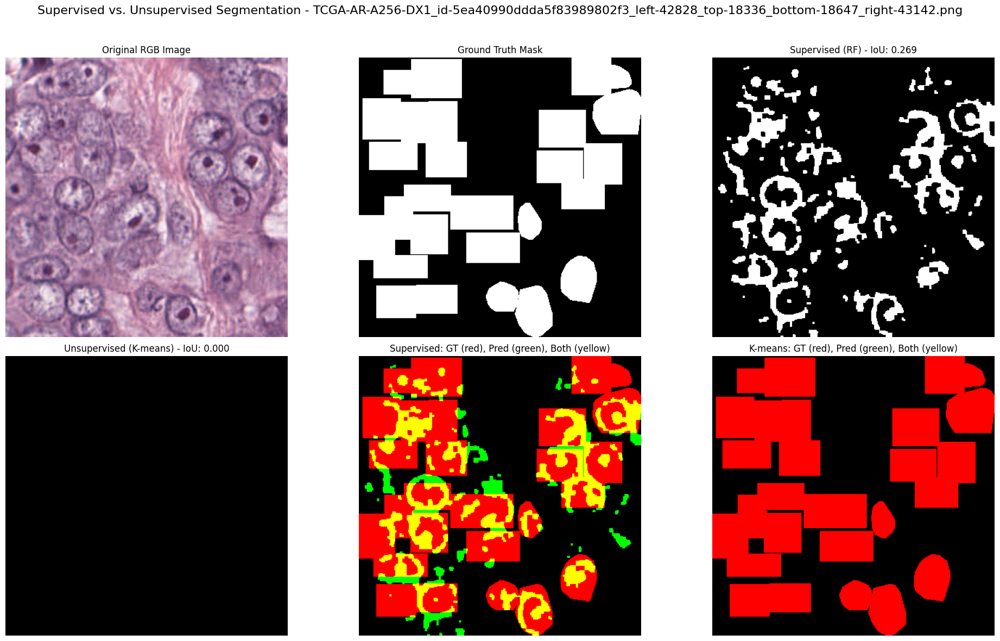


Processing file 3/3: TCGA-BH-A18V-DX1_id-5ea40b03ddda5f83989973aa_left-50531_top-50718_bottom-51028_right-50823.png
  Running supervised segmentation...
  Running unsupervised segmentation with K-means...


/usr/local/lib/python3.11/dist-packages/numpy/_core/fromnumeric.py:3596: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.11/dist-packages/numpy/_core/_methods.py:138: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


  Metrics for TCGA-BH-A18V-DX1_id-5ea40b03ddda5f83989973aa_left-50531_top-50718_bottom-51028_right-50823.png:
    Supervised   - IoU: 0.418, Precision: 0.753, Recall: 0.484, F1: 0.589
    K-means      - IoU: 0.000, Precision: 0.000, Recall: 0.000, F1: 0.000
    Difference (Sup - K-means): IoU: 0.418, F1: 0.589


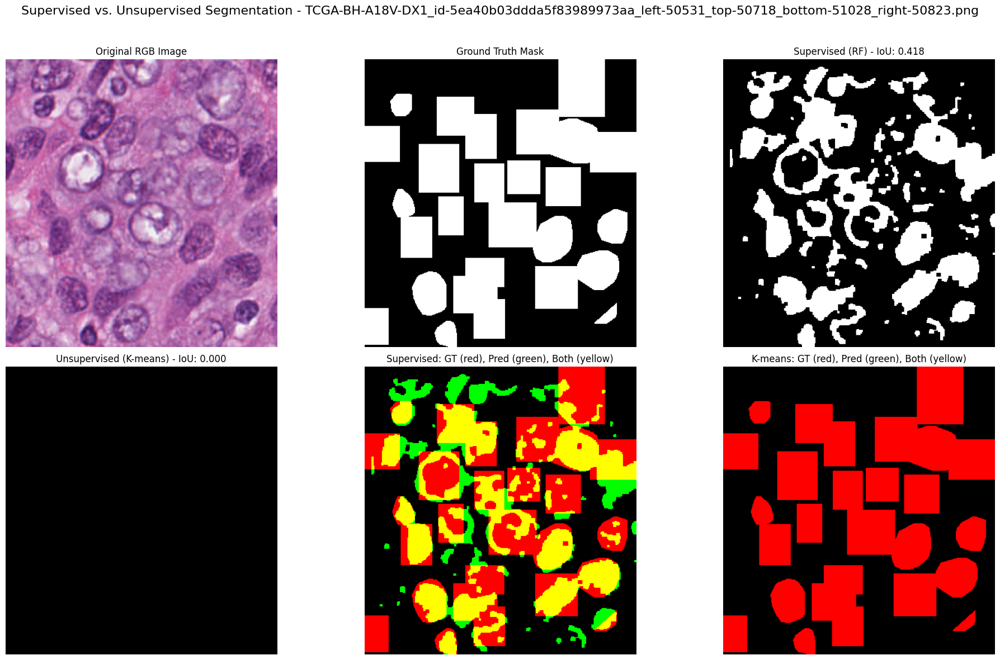


SUMMARY OF SEGMENTATION PERFORMANCE
Metric          Supervised      K-means         Difference     
------------------------------------------------------------
IoU             0.3995          0.0000          0.3995
Precision       0.7005          0.0000          0.7005
Recall          0.5326          0.0000          0.5326
F1 Score        0.5633          0.0000          0.5633


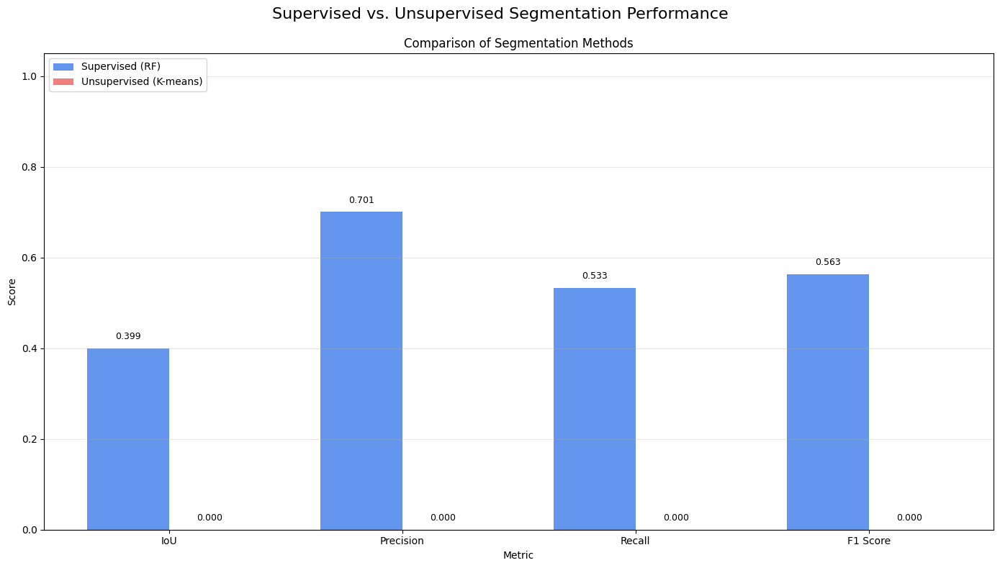

In [ ]:
def compare_supervised_vs_unsupervised(num_samples=3):
    """
    Compare supervised and unsupervised segmentation methods on validation data
    both qualitatively and quantitatively
    """
    import os
    import numpy as np
    import cv2
    import matplotlib.pyplot as plt
    from skimage import measure
    from skimage.segmentation import felzenszwalb
    from skimage.util import img_as_float
    import random
    import pandas as pd
    import time

    print("Comparing supervised and unsupervised segmentation methods...")
    start_time = time.time()

    # Load validation images
    val_df = pd.read_csv(VAL_SUBJECTS_DIR)
    val_slide_names = val_df['slide_name'].tolist()
    val_files = get_files_for_slides_val(val_slide_names, RGB_DIR)

    if len(val_files) == 0:
        print("No validation files found!")
        return

    random.seed(42)  # For reproducibility

    # Select random samples
    if len(val_files) > num_samples:
        sample_files = random.sample(val_files, num_samples)
    else:
        sample_files = val_files[:num_samples]

    print(f"Selected {len(sample_files)} files for comparison")

    # Morphological kernels
    kernel_open = np.ones((3,3), np.uint8)
    kernel_close = np.ones((5,5), np.uint8)

    # Summary statistics
    summary_stats = {
        'supervised': {
            'iou_scores': [],
            'precision_scores': [],
            'recall_scores': [],
            'f1_scores': []
        },
        'unsupervised_kmeans': {
            'iou_scores': [],
            'precision_scores': [],
            'recall_scores': [],
            'f1_scores': []
        }
    }

    for file_idx, file in enumerate(sample_files):
        try:
            print(f"\nProcessing file {file_idx+1}/{len(sample_files)}: {file}")

            # Load image and mask
            gray_val, mask_val = load_image_and_mask(file)
            if gray_val is None or mask_val is None:
                print(f"  Skipping file: could not load image or mask")
                continue

            # Get RGB version for visualization
            rgb_path = os.path.join(RGB_DIR, file)
            rgb_img = cv2.imread(rgb_path)
            if rgb_img is not None:
                rgb_img = cv2.cvtColor(rgb_img, cv2.COLOR_BGR2RGB)
                # Ensure RGB has same dimensions as mask
                rgb_img = cv2.resize(rgb_img, (mask_val.shape[1], mask_val.shape[0]))
            else:
                # If RGB not available, create from grayscale
                rgb_img = cv2.cvtColor(gray_val, cv2.COLOR_GRAY2RGB)

            # Create binary mask for segmentation
            label_val_bin = binarize_mask(mask_val)

            # Method 1: SUPERVISED (Random Forest)
            print("  Running supervised segmentation...")
            # Extract features
            feat_val = extract_features(gray_val, add_texture=True)

            # Predict with Random Forest
            pred_val_sup = rf.predict(feat_val)
            pred_mask_sup = pred_val_sup.reshape(gray_val.shape)

            # Apply morphological operations
            pred_mask_sup_open = cv2.morphologyEx(pred_mask_sup.astype(np.uint8),
                                               cv2.MORPH_OPEN, kernel_open)
            pred_mask_sup_morphed = cv2.morphologyEx(pred_mask_sup_open,
                                                 cv2.MORPH_CLOSE, kernel_close)

            # Method 2: UNSUPERVISED (K-means clustering with K=2)
            print("  Running unsupervised segmentation with K-means...")

            # Apply K-means clustering with K=2
            kmeans_result = k_mean_clustering(gray_val, k=2, mode="gray")

            # Determine which cluster represents nuclei (lower intensity values)
            cluster_0_mean = np.mean(gray_val[kmeans_result == 0])
            cluster_1_mean = np.mean(gray_val[kmeans_result == 1])

            # The darker cluster is likely nuclei
            if cluster_0_mean < cluster_1_mean:
                pred_mask_kmeans = (kmeans_result == 0).astype(np.uint8)
            else:
                pred_mask_kmeans = (kmeans_result == 1).astype(np.uint8)

            # Apply the same morphological operations for fair comparison
            pred_mask_kmeans_open = cv2.morphologyEx(pred_mask_kmeans,
                                                  cv2.MORPH_OPEN, kernel_open)
            pred_mask_kmeans_morphed = cv2.morphologyEx(pred_mask_kmeans_open,
                                                     cv2.MORPH_CLOSE, kernel_close)

            # Calculate quantitative metrics
            # For IoU, we calculate at image level
            sup_iou = np.sum(np.logical_and(label_val_bin, pred_mask_sup_morphed)) / \
                      np.sum(np.logical_or(label_val_bin, pred_mask_sup_morphed))

            kmeans_iou = np.sum(np.logical_and(label_val_bin, pred_mask_kmeans_morphed)) / \
                         np.sum(np.logical_or(label_val_bin, pred_mask_kmeans_morphed))

            # Calculate precision, recall, F1 score
            sup_tp = np.sum(np.logical_and(label_val_bin == 1, pred_mask_sup_morphed == 1))
            sup_fp = np.sum(np.logical_and(label_val_bin == 0, pred_mask_sup_morphed == 1))
            sup_fn = np.sum(np.logical_and(label_val_bin == 1, pred_mask_sup_morphed == 0))

            kmeans_tp = np.sum(np.logical_and(label_val_bin == 1, pred_mask_kmeans_morphed == 1))
            kmeans_fp = np.sum(np.logical_and(label_val_bin == 0, pred_mask_kmeans_morphed == 1))
            kmeans_fn = np.sum(np.logical_and(label_val_bin == 1, pred_mask_kmeans_morphed == 0))

            sup_precision = sup_tp / (sup_tp + sup_fp) if (sup_tp + sup_fp) > 0 else 0
            sup_recall = sup_tp / (sup_tp + sup_fn) if (sup_tp + sup_fn) > 0 else 0
            sup_f1 = 2 * sup_precision * sup_recall / (sup_precision + sup_recall) if (sup_precision + sup_recall) > 0 else 0

            kmeans_precision = kmeans_tp / (kmeans_tp + kmeans_fp) if (kmeans_tp + kmeans_fp) > 0 else 0
            kmeans_recall = kmeans_tp / (kmeans_tp + kmeans_fn) if (kmeans_tp + kmeans_fn) > 0 else 0
            kmeans_f1 = 2 * kmeans_precision * kmeans_recall / (kmeans_precision + kmeans_recall) if (kmeans_precision + kmeans_recall) > 0 else 0

            # Store metrics
            summary_stats['supervised']['iou_scores'].append(sup_iou)
            summary_stats['supervised']['precision_scores'].append(sup_precision)
            summary_stats['supervised']['recall_scores'].append(sup_recall)
            summary_stats['supervised']['f1_scores'].append(sup_f1)

            summary_stats['unsupervised_kmeans']['iou_scores'].append(kmeans_iou)
            summary_stats['unsupervised_kmeans']['precision_scores'].append(kmeans_precision)
            summary_stats['unsupervised_kmeans']['recall_scores'].append(kmeans_recall)
            summary_stats['unsupervised_kmeans']['f1_scores'].append(kmeans_f1)

            # Print metrics for this image
            print(f"  Metrics for {os.path.basename(file)}:")
            print(f"    Supervised   - IoU: {sup_iou:.3f}, Precision: {sup_precision:.3f}, Recall: {sup_recall:.3f}, F1: {sup_f1:.3f}")
            print(f"    K-means      - IoU: {kmeans_iou:.3f}, Precision: {kmeans_precision:.3f}, Recall: {kmeans_recall:.3f}, F1: {kmeans_f1:.3f}")
            print(f"    Difference (Sup - K-means): IoU: {sup_iou - kmeans_iou:.3f}, F1: {sup_f1 - kmeans_f1:.3f}")

            # Create visualization of results
            plt.figure(figsize=(20, 12))
            plt.suptitle(f"Supervised vs. Unsupervised Segmentation - {os.path.basename(file)}", fontsize=16)

            # Original image
            plt.subplot(2, 3, 1)
            plt.imshow(rgb_img)
            plt.title("Original RGB Image")
            plt.axis('off')

            # Ground truth mask
            plt.subplot(2, 3, 2)
            plt.imshow(label_val_bin, cmap='gray')
            plt.title("Ground Truth Mask")
            plt.axis('off')

            # Supervised segmentation result
            plt.subplot(2, 3, 3)
            plt.imshow(pred_mask_sup_morphed, cmap='gray')
            plt.title(f"Supervised (RF) - IoU: {sup_iou:.3f}")
            plt.axis('off')

            # K-means segmentation result
            plt.subplot(2, 3, 4)
            plt.imshow(pred_mask_kmeans_morphed, cmap='gray')
            plt.title(f"Unsupervised (K-means) - IoU: {kmeans_iou:.3f}")
            plt.axis('off')

            # Supervised overlap with ground truth
            plt.subplot(2, 3, 5)
            sup_overlap_img = np.zeros((*label_val_bin.shape, 3), dtype=np.uint8)
            sup_overlap_img[label_val_bin == 1] = [255, 0, 0]  # Red for ground truth
            sup_overlap_img[pred_mask_sup_morphed == 1] = [0, 255, 0]  # Green for prediction
            sup_overlap_img[(label_val_bin == 1) & (pred_mask_sup_morphed == 1)] = [255, 255, 0]  # Yellow for overlap
            plt.imshow(sup_overlap_img)
            plt.title("Supervised: GT (red), Pred (green), Both (yellow)")
            plt.axis('off')

            # K-means overlap with ground truth
            plt.subplot(2, 3, 6)
            kmeans_overlap_img = np.zeros((*label_val_bin.shape, 3), dtype=np.uint8)
            kmeans_overlap_img[label_val_bin == 1] = [255, 0, 0]  # Red for ground truth
            kmeans_overlap_img[pred_mask_kmeans_morphed == 1] = [0, 255, 0]  # Green for prediction
            kmeans_overlap_img[(label_val_bin == 1) & (pred_mask_kmeans_morphed == 1)] = [255, 255, 0]  # Yellow for overlap
            plt.imshow(kmeans_overlap_img)
            plt.title("K-means: GT (red), Pred (green), Both (yellow)")
            plt.axis('off')

            plt.tight_layout()
            plt.subplots_adjust(top=0.9)
            plt.show()

        except Exception as e:
            print(f"Error processing {file}: {e}")
            import traceback
            traceback.print_exc()

    # Calculate overall statistics
    if len(summary_stats['supervised']['iou_scores']) > 0:
        sup_mean_iou = np.mean(summary_stats['supervised']['iou_scores'])
        sup_mean_prec = np.mean(summary_stats['supervised']['precision_scores'])
        sup_mean_recall = np.mean(summary_stats['supervised']['recall_scores'])
        sup_mean_f1 = np.mean(summary_stats['supervised']['f1_scores'])

        kmeans_mean_iou = np.mean(summary_stats['unsupervised_kmeans']['iou_scores'])
        kmeans_mean_prec = np.mean(summary_stats['unsupervised_kmeans']['precision_scores'])
        kmeans_mean_recall = np.mean(summary_stats['unsupervised_kmeans']['recall_scores'])
        kmeans_mean_f1 = np.mean(summary_stats['unsupervised_kmeans']['f1_scores'])

        # Print summary
        print("\n" + "="*50)
        print("SUMMARY OF SEGMENTATION PERFORMANCE")
        print("="*50)
        print(f"{'Metric':<15} {'Supervised':<15} {'K-means':<15} {'Difference':<15}")
        print("-"*60)
        print(f"{'IoU':<15} {sup_mean_iou:.4f}{'':<9} {kmeans_mean_iou:.4f}{'':<9} {sup_mean_iou - kmeans_mean_iou:.4f}")
        print(f"{'Precision':<15} {sup_mean_prec:.4f}{'':<9} {kmeans_mean_prec:.4f}{'':<9} {sup_mean_prec - kmeans_mean_prec:.4f}")
        print(f"{'Recall':<15} {sup_mean_recall:.4f}{'':<9} {kmeans_mean_recall:.4f}{'':<9} {sup_mean_recall - kmeans_mean_recall:.4f}")
        print(f"{'F1 Score':<15} {sup_mean_f1:.4f}{'':<9} {kmeans_mean_f1:.4f}{'':<9} {sup_mean_f1 - kmeans_mean_f1:.4f}")
        print("="*60)

        # Visualization of overall results
        plt.figure(figsize=(14, 8))
        plt.suptitle("Supervised vs. Unsupervised Segmentation Performance", fontsize=16)

        # Bar chart comparing overall metrics
        metrics = ['IoU', 'Precision', 'Recall', 'F1 Score']
        sup_values = [sup_mean_iou, sup_mean_prec, sup_mean_recall, sup_mean_f1]
        kmeans_values = [kmeans_mean_iou, kmeans_mean_prec, kmeans_mean_recall, kmeans_mean_f1]

        x = np.arange(len(metrics))
        width = 0.35

        plt.bar(x - width/2, sup_values, width, label='Supervised (RF)', color='cornflowerblue')
        plt.bar(x + width/2, kmeans_values, width, label='Unsupervised (K-means)', color='lightcoral')

        # Add value labels on bars
        for i, v in enumerate(sup_values):
            plt.text(i - width/2, v + 0.02, f'{v:.3f}', ha='center', fontsize=9)

        for i, v in enumerate(kmeans_values):
            plt.text(i + width/2, v + 0.02, f'{v:.3f}', ha='center', fontsize=9)

        plt.xlabel('Metric')
        plt.ylabel('Score')
        plt.title('Comparison of Segmentation Methods')
        plt.xticks(x, metrics)
        plt.ylim(0, 1.05)
        plt.legend(loc='upper left')
        plt.grid(axis='y', alpha=0.3)

        plt.tight_layout()
        plt.subplots_adjust(top=0.9)
        plt.show()

    else:
        print("\nNo valid comparisons could be made.")

    return summary_stats

# Run the comparison
comparison_results = compare_supervised_vs_unsupervised(num_samples=3)

### 4.2.5 Compare performance of the supervised segmentation between nuclei types

Analyzing segmentation difficulty by nuclei type across 30 validation samples...
Found 268 validation files
Selected 30 files for analysis
Processing file 1/30: TCGA-A2-A04T-DX1_id-5ea40961ddda5f8398979057_left-78272_top-39832_bottom-40101_right-78544.png
  Found 34 unique nuclei types in this image
  Successfully collected data for 33 nuclei types so far
Processing file 2/30: TCGA-AR-A256-DX1_id-5ea40990ddda5f83989802f3_left-42828_top-18336_bottom-18647_right-43142.png
  Found 28 unique nuclei types in this image
  Successfully collected data for 33 nuclei types so far
Processing file 3/30: TCGA-BH-A18V-DX1_id-5ea40b03ddda5f83989973aa_left-50531_top-50718_bottom-51028_right-50823.png
  Found 28 unique nuclei types in this image
  Successfully collected data for 33 nuclei types so far
Processing file 4/30: TCGA-LL-A740-DX1_id-5ea409eaddda5f8398987e66_left-41995_top-26114_bottom-26385_right-42252.png
  Found 14 unique nuclei types in this image
  Successfully collected data for 33 nucle

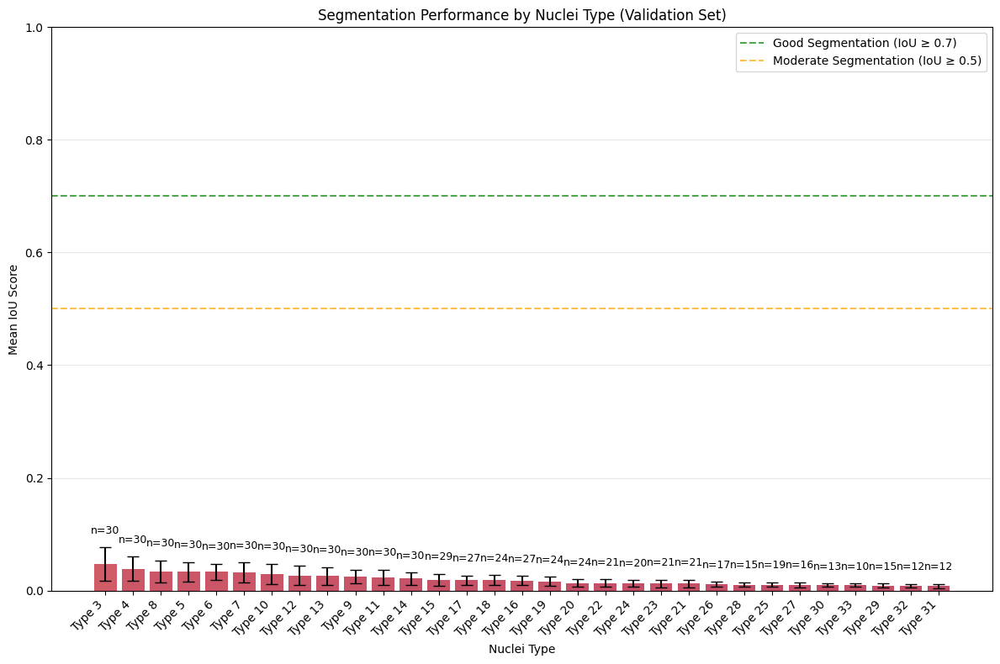

<ipython-input-30-65bbaaaed98d>:224: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  box = plt.boxplot(box_data, patch_artist=True, labels=top_type_names)


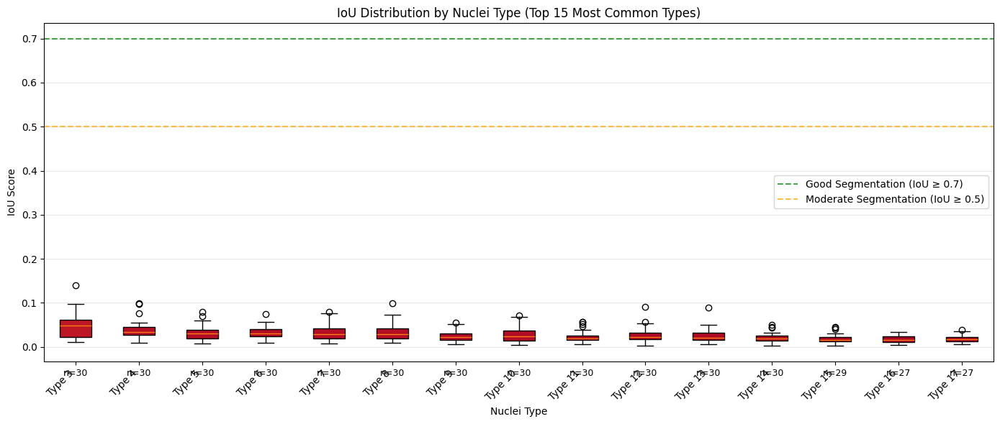


Saved detailed statistics to nuclei_type_iou_analysis.csv

KEY INSIGHTS:
- Easiest nuclei type to segment: Type 3 (IoU: 0.047, Count: 30)
- Most difficult nuclei type to segment: Type 31 (IoU: 0.008, Count: 12)
- Most common nuclei type: Type 3 (Count: 30, IoU: 0.047)


In [ ]:
def analyze_nuclei_types_in_validation(num_samples=50):
    """
    Analyze which specific nuclei types are easier to segment across validation data only.
    Focus on comparing nuclei types and their IoU scores.
    """
    import os
    import numpy as np
    import cv2
    import matplotlib.pyplot as plt
    from skimage import measure
    import random
    import pandas as pd
    from collections import defaultdict
    import time

    print(f"Analyzing segmentation difficulty by nuclei type across {num_samples} validation samples...")
    start_time = time.time()

    # Load validation files only
    val_df = pd.read_csv(VAL_SUBJECTS_DIR)
    val_slide_names = val_df['slide_name'].tolist()
    val_files = get_files_for_slides_val(val_slide_names, RGB_DIR)

    print(f"Found {len(val_files)} validation files")

    # Select random samples from validation dataset
    random.seed(42)
    if len(val_files) > num_samples:
        sample_files = random.sample(val_files, num_samples)
    else:
        sample_files = val_files
        print(f"Warning: Only {len(val_files)} validation files available, using all of them")

    print(f"Selected {len(sample_files)} files for analysis")

    # Dictionary to store statistics by nuclei type
    nuclei_types_stats = defaultdict(lambda: {
        'count': 0,
        'iou_scores': []
    })

    # Morphological kernels (for segmentation)
    kernel_open = np.ones((3,3), np.uint8)
    kernel_close = np.ones((5,5), np.uint8)

    processed_count = 0

    for file_idx, file in enumerate(sample_files):
        try:
            print(f"Processing file {file_idx+1}/{len(sample_files)}: {file}")

            # Load image and original mask
            gray_val, mask_val_orig = load_image_and_mask(file)
            if gray_val is None or mask_val_orig is None:
                print(f"  Skipping file: could not load image or mask")
                continue

            # Create binary mask for segmentation
            label_val_bin = binarize_mask(mask_val_orig)

            # Get supervised segmentation prediction
            feat_val = extract_features(gray_val, add_texture=True)
            pred_val = rf.predict(feat_val)

            # Ensure prediction has same shape as binary mask
            pred_mask_val = pred_val.reshape(gray_val.shape)
            if pred_mask_val.shape != label_val_bin.shape:
                pred_mask_val = cv2.resize(pred_mask_val.astype(np.uint8),
                                      (label_val_bin.shape[1], label_val_bin.shape[0]),
                                      interpolation=cv2.INTER_NEAREST)

            # Apply morphological operations to improve prediction
            pred_mask_open = cv2.morphologyEx(pred_mask_val.astype(np.uint8),
                                           cv2.MORPH_OPEN, kernel_open)
            pred_mask_morphed = cv2.morphologyEx(pred_mask_open,
                                             cv2.MORPH_CLOSE, kernel_close)

            # Check unique values in the original mask to identify nuclei types
            unique_values = np.unique(mask_val_orig)
            print(f"  Found {len(unique_values)-1} unique nuclei types in this image")

            # Analyze each nuclei type in this image
            for val in unique_values:
                if val == 0 or val == 1 or val == 2:  # Skip background and other low values if needed
                    continue

                # Create mask for this nuclei type
                type_mask = (mask_val_orig == val)

                # Label connected components to get individual nuclei
                labeled_type = measure.label(type_mask)
                regions_type = measure.regionprops(labeled_type)

                if len(regions_type) == 0:
                    continue

                # Calculate metrics for each nucleus of this type
                nuclei_type = f"Type {val}"

                for region in regions_type:
                    # Skip very small regions which could be noise
                    if region.area < 10:
                        continue

                    # Create mask for this nucleus
                    nucleus_mask = np.zeros_like(label_val_bin, dtype=np.uint8)
                    for coord in region.coords:
                        nucleus_mask[coord[0], coord[1]] = 1

                    # Calculate IoU with prediction
                    intersection = np.logical_and(nucleus_mask, pred_mask_morphed)
                    union = np.logical_or(nucleus_mask, pred_mask_morphed)
                    iou = np.sum(intersection) / np.sum(union) if np.sum(union) > 0 else 0

                    # Store values in the nuclei_types_stats dictionary
                    nuclei_types_stats[nuclei_type]['count'] += 1
                    nuclei_types_stats[nuclei_type]['iou_scores'].append(iou)

            # Verify that data is being collected
            collected_types = [t for t, stats in nuclei_types_stats.items() if len(stats['iou_scores']) > 0]
            print(f"  Successfully collected data for {len(collected_types)} nuclei types so far")

            processed_count += 1

        except Exception as e:
            print(f"Error processing {file}: {e}")
            import traceback
            traceback.print_exc()

    print(f"\nSuccessfully processed {processed_count} out of {len(sample_files)} files")
    print(f"Total execution time: {time.time() - start_time:.1f} seconds")

    # After processing all images, create summary statistics
    if nuclei_types_stats:
        print(f"\nCalculating summary statistics for {len(nuclei_types_stats)} nuclei types...")

        # Calculate overall stats for each type
        for type_name, stats in nuclei_types_stats.items():
            if len(stats['iou_scores']) > 0:
                stats['mean_iou'] = np.mean(stats['iou_scores'])
                stats['median_iou'] = np.median(stats['iou_scores'])
                stats['std_iou'] = np.std(stats['iou_scores'])
                stats['good_seg_pct'] = sum(1 for iou in stats['iou_scores'] if iou >= 0.7) / len(stats['iou_scores']) * 100

        # Print summary table
        print("\nSUMMARY OF SEGMENTATION BY NUCLEI TYPE:")
        print(f"{'Nuclei Type':<15} {'Count':<8} {'Mean IoU':<10} {'Median IoU':<12} {'Good Seg %':<12}")
        print("-" * 65)

        # Sort by mean IoU and print
        sorted_types = sorted(nuclei_types_stats.items(), key=lambda x: x[1].get('mean_iou', 0), reverse=True)
        for type_name, stats in sorted_types:
            if 'mean_iou' in stats:
                print(f"{type_name:<15} {stats['count']:<8} {stats['mean_iou']:.3f}     {stats['median_iou']:.3f}       {stats['good_seg_pct']:.1f}%")

        # Create graph comparing nuclei types and IoU
        print("\nGenerating visualization comparing nuclei types and IoU...")

        # Filter out types with very few samples
        min_count_threshold = 10  # Adjust as needed
        valid_types = [t for t, stats in nuclei_types_stats.items()
                     if 'mean_iou' in stats and stats['count'] >= min_count_threshold]

        if valid_types:
            plt.figure(figsize=(12, 8))

            # Sort by IoU for better visualization
            sorted_data = sorted([(t, nuclei_types_stats[t]['mean_iou'],
                                  nuclei_types_stats[t]['count'],
                                  nuclei_types_stats[t]['std_iou'])
                                for t in valid_types],
                               key=lambda x: x[1], reverse=True)

            sorted_types = [x[0] for x in sorted_data]
            sorted_ious = [x[1] for x in sorted_data]
            sorted_counts = [x[2] for x in sorted_data]
            sorted_stds = [x[3] for x in sorted_data]

            # Create color gradient based on IoU value
            colors = plt.cm.RdYlGn(np.array(sorted_ious))

            # Create bar chart with error bars
            bars = plt.bar(range(len(sorted_types)), sorted_ious, yerr=sorted_stds,
                          capsize=5, color=colors, alpha=0.7)

            # Add count labels above bars
            for i, (bar, count) in enumerate(zip(bars, sorted_counts)):
                plt.text(i, bar.get_height() + sorted_stds[i] + 0.02,
                       f'n={count}', ha='center', va='bottom', fontsize=9)

            # Set x-axis labels to nuclei types
            plt.xticks(range(len(sorted_types)), sorted_types, rotation=45, ha='right')

            plt.xlabel('Nuclei Type')
            plt.ylabel('Mean IoU Score')
            plt.title('Segmentation Performance by Nuclei Type (Validation Set)')
            plt.ylim(0, 1.0)
            plt.grid(axis='y', alpha=0.3)

            # Add horizontal lines for IoU thresholds
            plt.axhline(y=0.7, color='green', linestyle='--', alpha=0.7,
                       label='Good Segmentation (IoU ≥ 0.7)')
            plt.axhline(y=0.5, color='orange', linestyle='--', alpha=0.7,
                       label='Moderate Segmentation (IoU ≥ 0.5)')

            plt.legend()
            plt.tight_layout()

            # Save figure
            plt.savefig("nuclei_type_iou_comparison.png", dpi=300, bbox_inches='tight')
            plt.show()

            # Create box plot visualization
            plt.figure(figsize=(14, 6))

            # Limit to top 15 most common types for readability
            top_types = sorted(nuclei_types_stats.items(), key=lambda x: x[1]['count'], reverse=True)[:15]
            top_type_names = [t for t, _ in top_types]

            # Collect data for box plot
            box_data = [nuclei_types_stats[t]['iou_scores'] for t in top_type_names]

            # Create box plot
            box = plt.boxplot(box_data, patch_artist=True, labels=top_type_names)

            # Color boxes based on median IoU
            medians = [np.median(data) for data in box_data]
            colors = plt.cm.RdYlGn(np.array(medians))

            for patch, color in zip(box['boxes'], colors):
                patch.set_facecolor(color)

            # Add count information
            for i, t in enumerate(top_type_names):
                count = nuclei_types_stats[t]['count']
                plt.text(i+1, -0.05, f'n={count}', ha='center', va='top', fontsize=9)

            plt.xlabel('Nuclei Type')
            plt.ylabel('IoU Score')
            plt.title('IoU Distribution by Nuclei Type (Top 15 Most Common Types)')
            plt.grid(axis='y', alpha=0.3)
            plt.xticks(rotation=45, ha='right')

            # Add horizontal lines for IoU thresholds
            plt.axhline(y=0.7, color='green', linestyle='--', alpha=0.7,
                       label='Good Segmentation (IoU ≥ 0.7)')
            plt.axhline(y=0.5, color='orange', linestyle='--', alpha=0.7,
                       label='Moderate Segmentation (IoU ≥ 0.5)')

            plt.legend()
            plt.tight_layout()

            # Save figure
            plt.savefig("nuclei_type_iou_boxplot.png", dpi=300, bbox_inches='tight')
            plt.show()

            # Save results to CSV
            stats_df = pd.DataFrame({
                'nuclei_type': list(nuclei_types_stats.keys()),
                'count': [stats['count'] for stats in nuclei_types_stats.values()],
                'mean_iou': [stats.get('mean_iou', np.nan) for stats in nuclei_types_stats.values()],
                'median_iou': [stats.get('median_iou', np.nan) for stats in nuclei_types_stats.values()],
                'std_iou': [stats.get('std_iou', np.nan) for stats in nuclei_types_stats.values()],
                'good_seg_pct': [stats.get('good_seg_pct', np.nan) for stats in nuclei_types_stats.values()]
            })

            stats_df.sort_values('mean_iou', ascending=False, inplace=True)
            stats_df.to_csv("nuclei_type_iou_analysis.csv", index=False)
            print("\nSaved detailed statistics to nuclei_type_iou_analysis.csv")

            # Print key insights
            print("\nKEY INSIGHTS:")
            best_type = max(valid_types, key=lambda t: nuclei_types_stats[t]['mean_iou'])
            worst_type = min(valid_types, key=lambda t: nuclei_types_stats[t]['mean_iou'])
            most_common = max(valid_types, key=lambda t: nuclei_types_stats[t]['count'])

            print(f"- Easiest nuclei type to segment: {best_type} (IoU: {nuclei_types_stats[best_type]['mean_iou']:.3f}, Count: {nuclei_types_stats[best_type]['count']})")
            print(f"- Most difficult nuclei type to segment: {worst_type} (IoU: {nuclei_types_stats[worst_type]['mean_iou']:.3f}, Count: {nuclei_types_stats[worst_type]['count']})")
            print(f"- Most common nuclei type: {most_common} (Count: {nuclei_types_stats[most_common]['count']}, IoU: {nuclei_types_stats[most_common]['mean_iou']:.3f})")

        else:
            print("No valid nuclei types with sufficient data were found.")
    else:
        print("No nuclei types data was collected.")

    return nuclei_types_stats

# Run the analysis on validation data
nuclei_types_stats = analyze_nuclei_types_in_validation(num_samples=30)

Seeing these results, we looked for possible reasons as to why we were observing these trends

Analyzing annotation style mismatches across 5 samples...
Processing file: TCGA-A2-A04T-DX1_id-5ea40961ddda5f8398979057_left-78272_top-39832_bottom-40101_right-78544.png


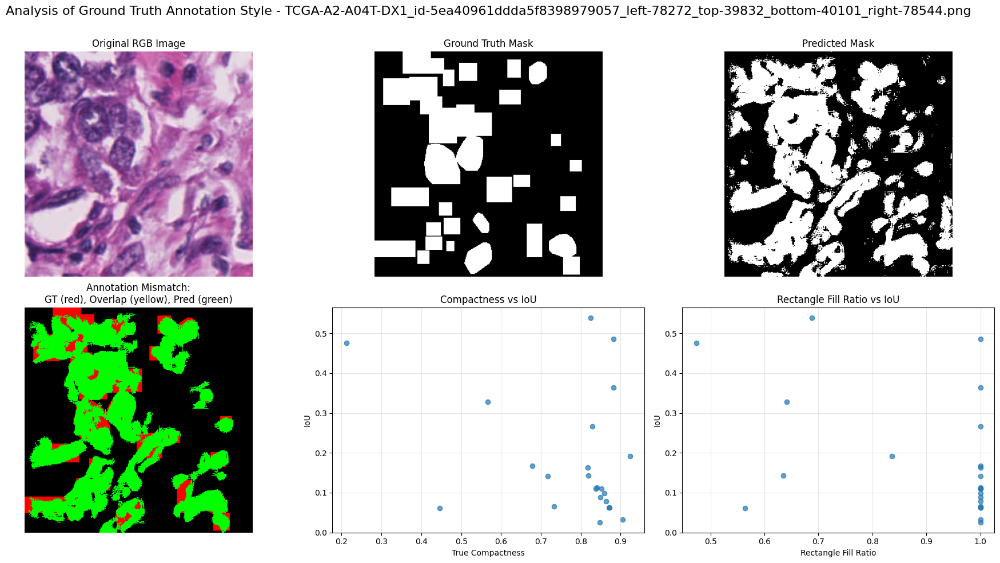

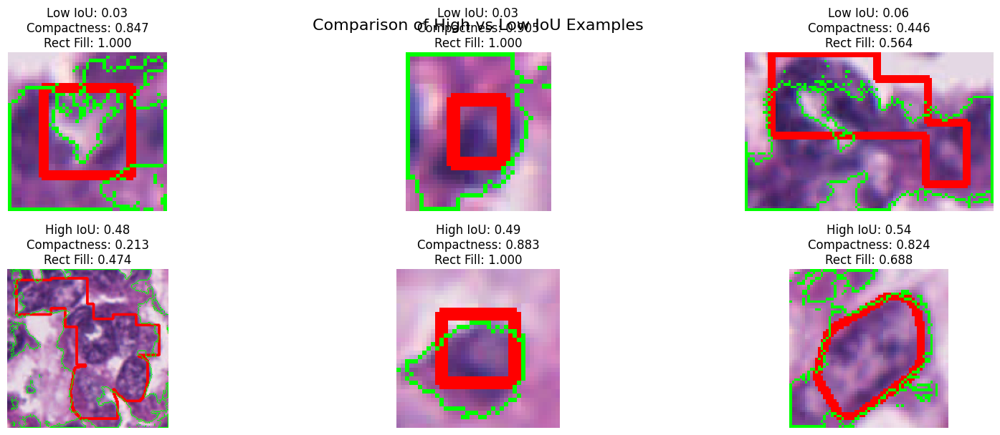


AVERAGE METRICS BY IoU GROUP:
LOW IoU EXAMPLES (likely annotation style mismatch):
  Average Compactness: 0.733
  Average Rectangle Fill: 0.855
  Average IoU: 0.040
  Average Area: 1056.0 pixels

HIGH IoU EXAMPLES (good match between ground truth and prediction):
  Average Compactness: 0.640
  Average Rectangle Fill: 0.721
  Average IoU: 0.501
  Average Area: 4640.3 pixels
Processing file: TCGA-AR-A256-DX1_id-5ea40990ddda5f83989802f3_left-42828_top-18336_bottom-18647_right-43142.png


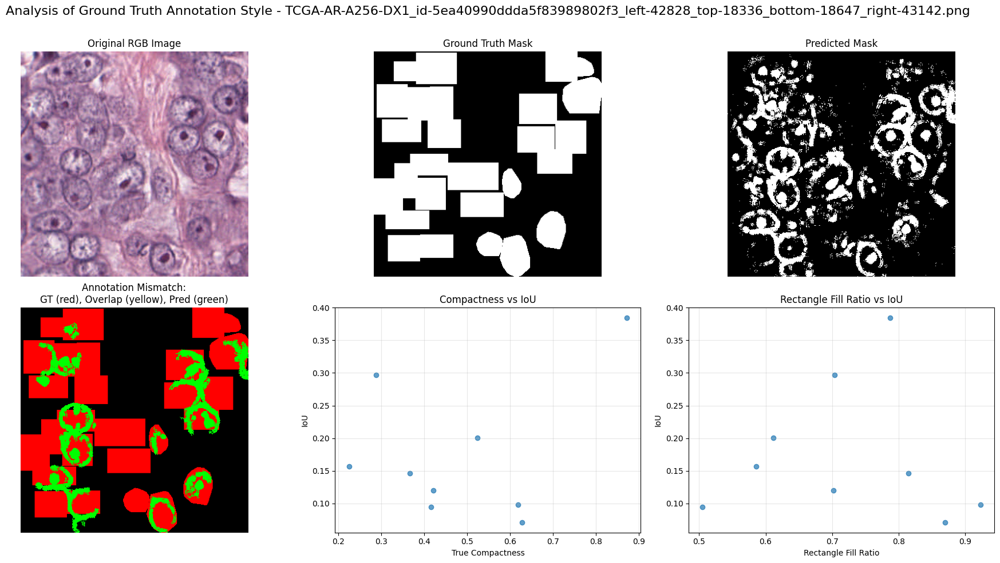

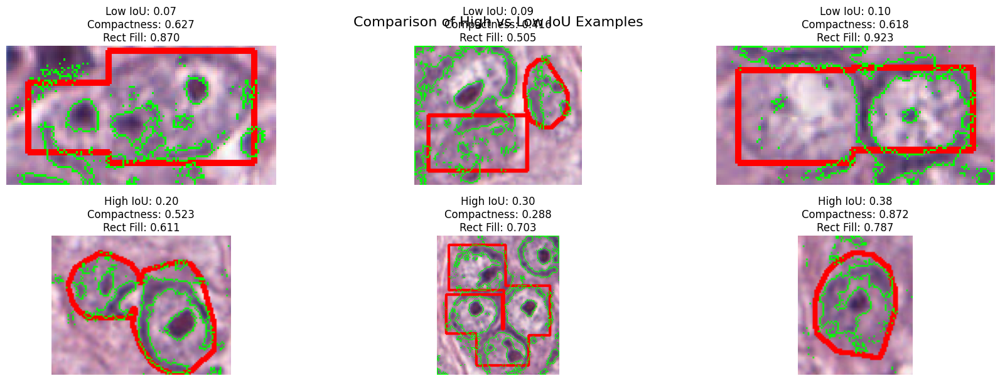


AVERAGE METRICS BY IoU GROUP:
LOW IoU EXAMPLES (likely annotation style mismatch):
  Average Compactness: 0.554
  Average Rectangle Fill: 0.766
  Average IoU: 0.088
  Average Area: 4729.7 pixels

HIGH IoU EXAMPLES (good match between ground truth and prediction):
  Average Compactness: 0.561
  Average Rectangle Fill: 0.701
  Average IoU: 0.294
  Average Area: 6086.3 pixels
Processing file: TCGA-BH-A18V-DX1_id-5ea40b03ddda5f83989973aa_left-50531_top-50718_bottom-51028_right-50823.png


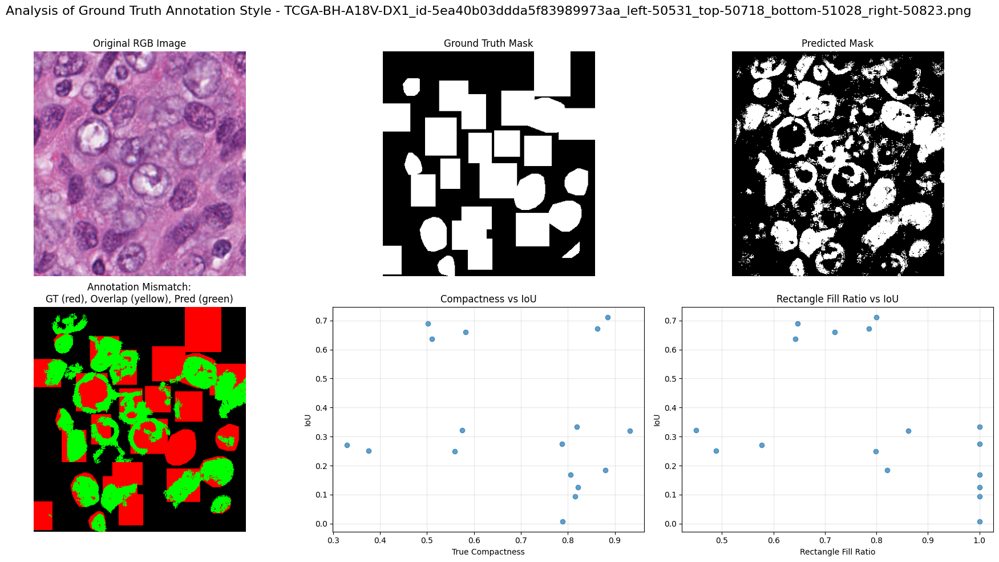

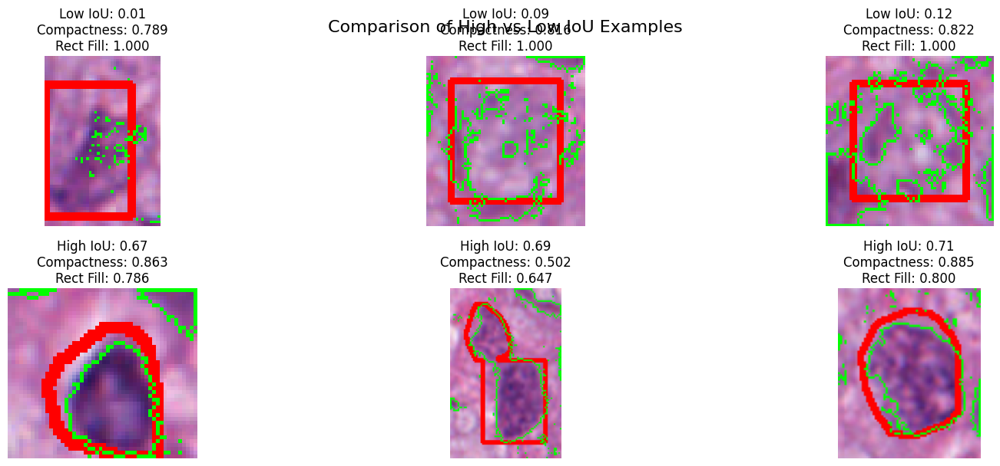


AVERAGE METRICS BY IoU GROUP:
LOW IoU EXAMPLES (likely annotation style mismatch):
  Average Compactness: 0.809
  Average Rectangle Fill: 1.000
  Average IoU: 0.076
  Average Area: 1997.3 pixels

HIGH IoU EXAMPLES (good match between ground truth and prediction):
  Average Compactness: 0.750
  Average Rectangle Fill: 0.744
  Average IoU: 0.691
  Average Area: 2049.3 pixels
Processing file: TCGA-LL-A740-DX1_id-5ea409eaddda5f8398987e66_left-41995_top-26114_bottom-26385_right-42252.png


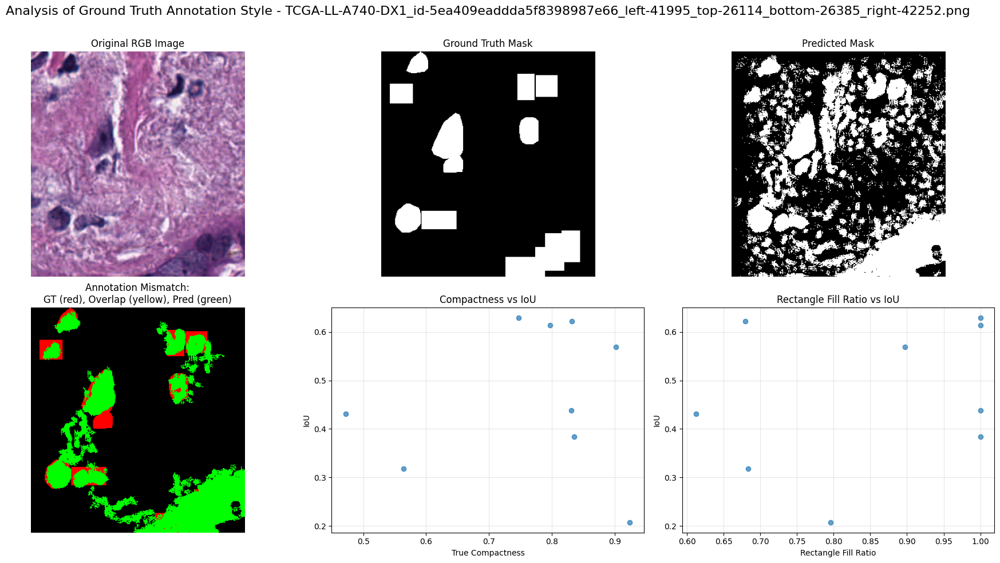

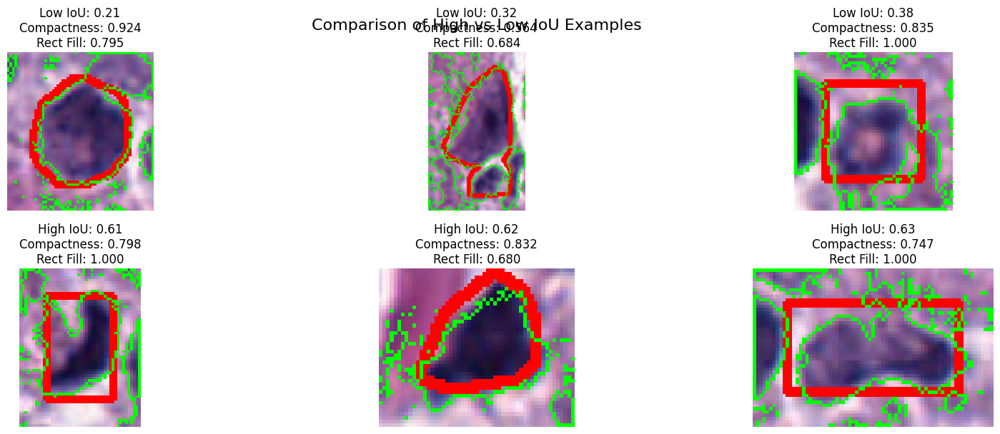


AVERAGE METRICS BY IoU GROUP:
LOW IoU EXAMPLES (likely annotation style mismatch):
  Average Compactness: 0.775
  Average Rectangle Fill: 0.826
  Average IoU: 0.303
  Average Area: 1813.3 pixels

HIGH IoU EXAMPLES (good match between ground truth and prediction):
  Average Compactness: 0.792
  Average Rectangle Fill: 0.893
  Average IoU: 0.622
  Average Area: 1088.0 pixels
Processing file: TCGA-AN-A0AT-DX1_id-5ea40a18ddda5f839898a4f0_left-31408_top-36263_bottom-36550_right-31698.png


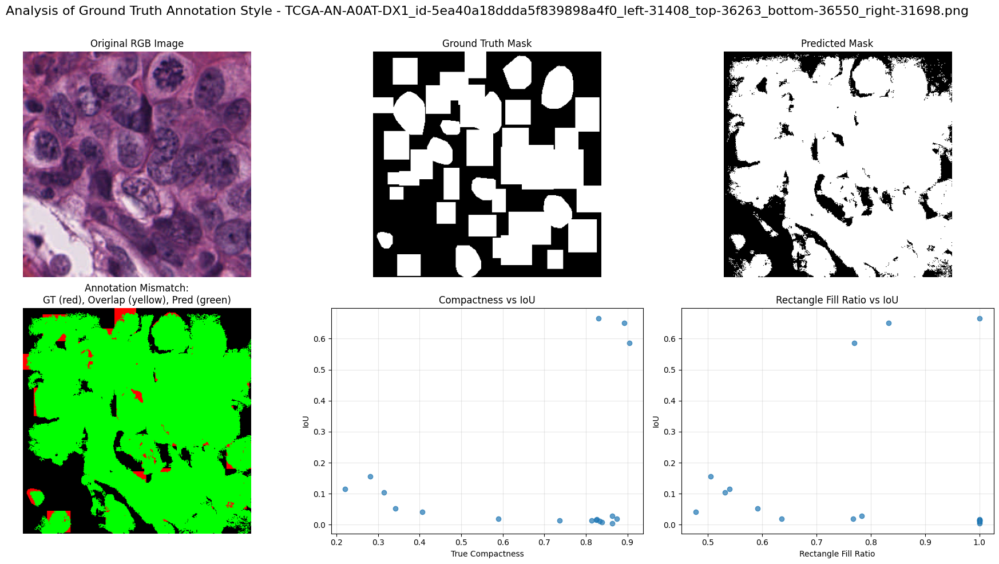

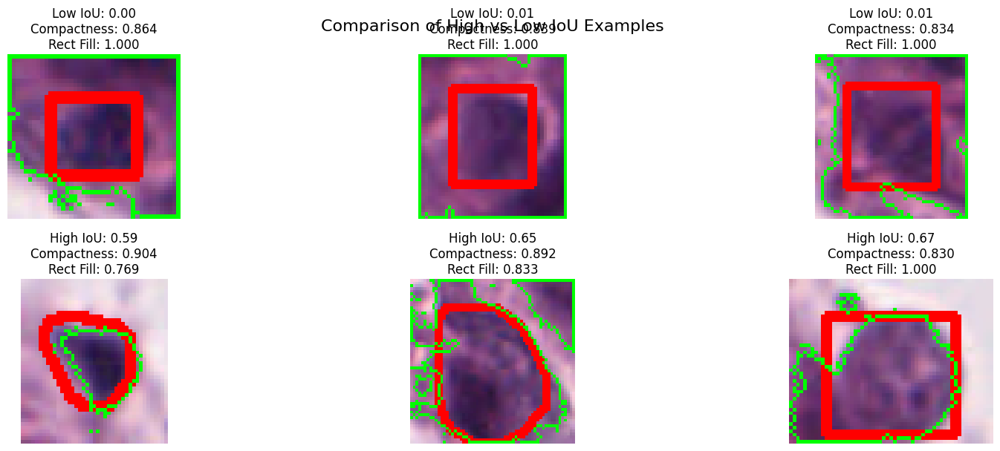


AVERAGE METRICS BY IoU GROUP:
LOW IoU EXAMPLES (likely annotation style mismatch):
  Average Compactness: 0.845
  Average Rectangle Fill: 1.000
  Average IoU: 0.008
  Average Area: 736.7 pixels

HIGH IoU EXAMPLES (good match between ground truth and prediction):
  Average Compactness: 0.875
  Average Rectangle Fill: 0.867
  Average IoU: 0.634
  Average Area: 1141.0 pixels
Analysis completed!


In [ ]:


def get_files_for_slides_val(slide_names, directory):
    matched_files = []
    all_files = os.listdir(directory)
    for slide_name in slide_names:
        for f in all_files:
            if f.startswith(slide_name):
                matched_files.append(f)
    return matched_files


def get_files_for_slides(slide_names, directory):
    matched_files = []
    all_files = os.listdir(directory)
    for slide_name in slide_names:
        for f in all_files:
            if f.startswith(slide_name):
                matched_files.append(f)
    return matched_files

# The function we have here aligns image and mask by cropping to the smallest dimensions
def align_image_and_mask(gray_image, label_mask):
    h_img, w_img = gray_image.shape
    h_mask, w_mask = label_mask.shape
    new_h = min(h_img, h_mask)
    new_w = min(w_img, w_mask)
    return gray_image[:new_h, :new_w], label_mask[:new_h, :new_w]

# load image and mask, convert image to grayscale, and align shapes
def load_image_and_mask(filename):
    rgb_path = os.path.join(RGB_DIR, filename)
    mask_path = os.path.join(MASK_DIR, filename)

    image = cv2.imread(rgb_path, cv2.IMREAD_COLOR)
    mask = cv2.imread(mask_path, cv2.IMREAD_UNCHANGED)
    if image is None or mask is None:
        raise FileNotFoundError(f"could not load image or mask for: {filename}")

    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # If mask has multiple channels, we use the first channel
    if len(mask.shape) == 3:
        label_mask = mask[:, :, 0]
    else:
        label_mask = mask

    gray_aligned, mask_aligned = align_image_and_mask(gray_image, label_mask)
    return gray_aligned, mask_aligned

# Compute local mean and std in a ksize x ksize window
def local_mean_std(gray_image, ksize=3):
    mean_image = cv2.blur(gray_image.astype(np.float32), (ksize, ksize))
    sq_mean = cv2.blur((gray_image**2).astype(np.float32), (ksize, ksize))
    var_image = sq_mean - (mean_image**2)
    var_image[var_image < 0] = 0
    std_image = np.sqrt(var_image)
    return mean_image, std_image

# Compute gradient magnitude using sobel filters
def gradient_magnitude(gray_image):
    gx = cv2.Sobel(gray_image, cv2.CV_32F, 1, 0, ksize=3)
    gy = cv2.Sobel(gray_image, cv2.CV_32F, 0, 1, ksize=3)
    mag = cv2.magnitude(gx, gy)
    return mag

# Extract pixel-level features, with add_texture true, returns 6 features:
# Intensity, x, y, local mean, local std, and gradient magnitude.
def extract_features(gray_image, add_texture=True):
    h, w = gray_image.shape
    intensity = gray_image.flatten()
    x_coords, y_coords = np.meshgrid(np.arange(w), np.arange(h))
    x_coords = x_coords.flatten()
    y_coords = y_coords.flatten()

    if not add_texture:
        features = np.stack([intensity, x_coords, y_coords], axis=1)
        return features

    mean_img, std_img = local_mean_std(gray_image, ksize=3)  # change ksize if needed
    grad_img = gradient_magnitude(gray_image)
    mean_flat = mean_img.flatten()
    std_flat = std_img.flatten()
    grad_flat = grad_img.flatten()

    features = np.stack([intensity, x_coords, y_coords, mean_flat, std_flat, grad_flat], axis=1)
    return features

# Binarize mask: convert all nonzero labels to 1 (foreground)
def binarize_mask(label_mask):
    binary = np.where(label_mask > 2, 1, 0).astype(np.uint8)
    return binary


def analyze_annotation_style_mismatch(num_samples=5):
    """
    Analyze how annotation style (rectangular vs natural boundaries) affects segmentation metrics
    """
    import os
    import numpy as np
    import cv2
    import matplotlib.pyplot as plt
    from skimage import measure
    import random
    import pandas as pd

    print(f"Analyzing annotation style mismatches across {num_samples} samples...")

    # Load validation files
    val_df = pd.read_csv(VAL_SUBJECTS_DIR)
    val_slide_names = val_df['slide_name'].tolist()
    val_files = get_files_for_slides_val(val_slide_names, RGB_DIR)

    if len(val_files) == 0:
        print("No validation files found!")
        return

    random.seed(42)
    # Select random samples
    sample_files = random.sample(val_files, min(num_samples, len(val_files)))

    for file in sample_files:
        try:
            print(f"Processing file: {file}")

            # Load image and mask
            gray_val, mask_val_orig = load_image_and_mask(file)

            # Get RGB version for visualization
            rgb_path = os.path.join(RGB_DIR, file)
            rgb_img = cv2.imread(rgb_path)
            if rgb_img is not None:
                rgb_img = cv2.cvtColor(rgb_img, cv2.COLOR_BGR2RGB)
                # Resize RGB to match mask dimensions
                rgb_img = cv2.resize(rgb_img, (mask_val_orig.shape[1], mask_val_orig.shape[0]))
            else:
                # Create RGB from grayscale if needed
                rgb_img = cv2.cvtColor(gray_val, cv2.COLOR_GRAY2RGB)

            # Binary mask
            label_val_bin = binarize_mask(mask_val_orig)

            # Get supervised segmentation
            feat_val = extract_features(gray_val, add_texture=True)
            pred_val = rf.predict(feat_val)
            pred_mask = pred_val.reshape(gray_val.shape)

            # Ensure prediction mask has same dimensions as ground truth
            if pred_mask.shape != label_val_bin.shape:
                pred_mask = cv2.resize(pred_mask.astype(np.uint8),
                                    (label_val_bin.shape[1], label_val_bin.shape[0]),
                                    interpolation=cv2.INTER_NEAREST)

            # Label connected components in ground truth
            labeled_gt = measure.label(label_val_bin)
            regions_gt = measure.regionprops(labeled_gt)

            # Label connected components in prediction
            labeled_pred = measure.label(pred_mask)
            regions_pred = measure.regionprops(labeled_pred)

            # Calculate metrics for each ground truth region
            region_scores = []

            for region in regions_gt:
                # Skip regions that are too small
                if region.area < 10:
                    continue

                # Create mask for this region
                region_mask = np.zeros_like(label_val_bin)
                for coord in region.coords:
                    region_mask[coord[0], coord[1]] = 1

                # Find the most overlapping predicted region
                max_overlap = 0
                best_pred_region_mask = None

                for pred_region in regions_pred:
                    # Create mask for this prediction region
                    pred_region_mask = np.zeros_like(label_val_bin)
                    for coord in pred_region.coords:
                        pred_region_mask[coord[0], coord[1]] = 1

                    # Calculate overlap with current ground truth region
                    overlap = np.sum(np.logical_and(region_mask, pred_region_mask))
                    if overlap > max_overlap:
                        max_overlap = overlap
                        best_pred_region_mask = pred_region_mask

                # Calculate IoU with best matching prediction region
                if best_pred_region_mask is not None and np.sum(best_pred_region_mask) > 0:
                    intersection = np.logical_and(region_mask, best_pred_region_mask)
                    union = np.logical_or(region_mask, best_pred_region_mask)
                    iou = np.sum(intersection) / np.sum(union) if np.sum(union) > 0 else 0
                else:
                    iou = 0  # No matching prediction region

                # Calculate shape properties
                true_compactness = 4 * np.pi * region.area / (region.perimeter**2) if region.perimeter > 0 else 0

                # Calculate the rectangular fit ratio
                # (how well the region fills its bounding box)
                minr, minc, maxr, maxc = region.bbox
                bbox_area = (maxr - minr) * (maxc - minc)
                rect_fill_ratio = region.area / bbox_area if bbox_area > 0 else 0

                # Store metrics
                region_scores.append({
                    'region_id': region.label,
                    'iou': iou,
                    'true_compactness': true_compactness,
                    'rect_fill_ratio': rect_fill_ratio,
                    'area': region.area
                })

            # Visualize results
            plt.figure(figsize=(18, 10))

            # Original image
            plt.subplot(2, 3, 1)
            plt.imshow(rgb_img)
            plt.title("Original RGB Image")
            plt.axis('off')

            # Ground truth mask
            plt.subplot(2, 3, 2)
            plt.imshow(label_val_bin, cmap='gray')
            plt.title("Ground Truth Mask")
            plt.axis('off')

            # Prediction mask
            plt.subplot(2, 3, 3)
            plt.imshow(pred_mask, cmap='gray')
            plt.title("Predicted Mask")
            plt.axis('off')

            # Create visualization showing rectangular vs circular mismatch
            # Create with the correct dimensions
            mismatch_img = np.zeros((label_val_bin.shape[0], label_val_bin.shape[1], 3), dtype=np.uint8)

            for region in regions_gt:
                minr, minc, maxr, maxc = region.bbox

                # Create a mask for this ground truth region with correct dimensions
                gt_mask = np.zeros_like(label_val_bin)
                for coord in region.coords:
                    gt_mask[coord[0], coord[1]] = 1

                # Apply mask to the mismatch image
                mismatch_img[gt_mask == 1] = [255, 0, 0]  # Red

                # Find the most overlapping predicted region
                if len(regions_pred) > 0:
                    max_overlap = 0
                    best_pred_region = None

                    for pred_region in regions_pred:
                        pred_mask_region = np.zeros_like(label_val_bin)
                        for coord in pred_region.coords:
                            # Check boundaries to prevent index errors
                            if (coord[0] < label_val_bin.shape[0] and
                                coord[1] < label_val_bin.shape[1]):
                                pred_mask_region[coord[0], coord[1]] = 1

                        overlap = np.sum(np.logical_and(gt_mask, pred_mask_region))
                        if overlap > max_overlap:
                            max_overlap = overlap
                            best_pred_region = pred_region

                    if best_pred_region is not None:
                        pred_mask_region = np.zeros_like(label_val_bin)
                        for coord in best_pred_region.coords:
                            # Check boundaries to prevent index errors
                            if (coord[0] < label_val_bin.shape[0] and
                                coord[1] < label_val_bin.shape[1]):
                                pred_mask_region[coord[0], coord[1]] = 1

                        # Overlap in yellow, prediction-only in green
                        overlap_mask = np.logical_and(gt_mask, pred_mask_region)
                        pred_only = np.logical_and(pred_mask_region, ~gt_mask)

                        mismatch_img[overlap_mask == 1] = [255, 255, 0]  # Yellow
                        mismatch_img[pred_only == 1] = [0, 255, 0]  # Green

            plt.subplot(2, 3, 4)
            plt.imshow(mismatch_img)
            plt.title("Annotation Mismatch:\nGT (red), Overlap (yellow), Pred (green)")
            plt.axis('off')

            # Plot scatter plots
            plt.subplot(2, 3, 5)
            if len(region_scores) > 0:  # Check if we have any data
                plt.scatter([s['true_compactness'] for s in region_scores],
                          [s['iou'] for s in region_scores], alpha=0.7)
                plt.xlabel('True Compactness')
                plt.ylabel('IoU')
                plt.grid(alpha=0.3)
                plt.title('Compactness vs IoU')
            else:
                plt.text(0.5, 0.5, "No regions to analyze",
                       ha='center', va='center', transform=plt.gca().transAxes)

            plt.subplot(2, 3, 6)
            if len(region_scores) > 0:  # Check if we have any data
                plt.scatter([s['rect_fill_ratio'] for s in region_scores],
                          [s['iou'] for s in region_scores], alpha=0.7)
                plt.xlabel('Rectangle Fill Ratio')
                plt.ylabel('IoU')
                plt.grid(alpha=0.3)
                plt.title('Rectangle Fill Ratio vs IoU')
            else:
                plt.text(0.5, 0.5, "No regions to analyze",
                       ha='center', va='center', transform=plt.gca().transAxes)

            plt.tight_layout()
            plt.suptitle(f"Analysis of Ground Truth Annotation Style - {file}", fontsize=16)
            plt.subplots_adjust(top=0.9)
            plt.show()

            # Only proceed with specific example analysis if there are enough regions
            if len(regions_gt) >= 6:
                # Sort by IoU scores
                region_scores = sorted(region_scores, key=lambda x: x['iou'])
                low_iou_regions = region_scores[:3]  # Low IoU
                high_iou_regions = region_scores[-3:]  # High IoU

                plt.figure(figsize=(18, 6))

                # Display examples of low IoU cases
                for i, score in enumerate(low_iou_regions):
                    try:
                        region = [r for r in regions_gt if r.label == score['region_id']][0]
                        minr, minc, maxr, maxc = region.bbox

                        # Add padding and check boundaries
                        pad = 10
                        minr = max(0, minr - pad)
                        minc = max(0, minc - pad)
                        maxr = min(rgb_img.shape[0], maxr + pad)
                        maxc = min(rgb_img.shape[1], maxc + pad)

                        # Extract ROI for visualization (check dimensions)
                        if minr >= maxr or minc >= maxc or maxr > rgb_img.shape[0] or maxc > rgb_img.shape[1]:
                            continue  # Skip this ROI if invalid dimensions

                        roi = rgb_img[minr:maxr, minc:maxc].copy()

                        # Create overlay masks for this ROI with correct dimensions
                        gt_mask_roi = np.zeros((maxr-minr, maxc-minc), dtype=np.uint8)
                        pred_mask_roi = np.zeros((maxr-minr, maxc-minc), dtype=np.uint8)

                        # Fill masks (safely)
                        for y in range(minr, maxr):
                            for x in range(minc, maxc):
                                if (y < label_val_bin.shape[0] and x < label_val_bin.shape[1]):
                                    if labeled_gt[y, x] == region.label:
                                        gt_mask_roi[y-minr, x-minc] = 255
                                    if pred_mask[y, x] == 1:
                                        pred_mask_roi[y-minr, x-minc] = 255

                        # Draw contours on the ROI
                        gt_contours, _ = cv2.findContours(gt_mask_roi, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
                        if gt_contours:
                            cv2.drawContours(roi, gt_contours, -1, (255, 0, 0), 2)  # Red for ground truth

                        pred_contours, _ = cv2.findContours(pred_mask_roi, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
                        if pred_contours:
                            cv2.drawContours(roi, pred_contours, -1, (0, 255, 0), 1)  # Green for prediction

                        plt.subplot(2, 3, i+1)
                        plt.imshow(roi)
                        plt.title(f"Low IoU: {score['iou']:.2f}\n" +
                                f"Compactness: {score['true_compactness']:.3f}\n" +
                                f"Rect Fill: {score['rect_fill_ratio']:.3f}")
                        plt.axis('off')
                    except Exception as e:
                        print(f"Error displaying region {score['region_id']}: {e}")
                        plt.subplot(2, 3, i+1)
                        plt.text(0.5, 0.5, "Error displaying region",
                               ha='center', va='center', transform=plt.gca().transAxes)
                        plt.axis('off')

                # Display examples of high IoU cases
                for i, score in enumerate(high_iou_regions):
                    try:
                        region = [r for r in regions_gt if r.label == score['region_id']][0]
                        minr, minc, maxr, maxc = region.bbox

                        # Add padding and check boundaries
                        pad = 10
                        minr = max(0, minr - pad)
                        minc = max(0, minc - pad)
                        maxr = min(rgb_img.shape[0], maxr + pad)
                        maxc = min(rgb_img.shape[1], maxc + pad)

                        # Extract ROI for visualization (check dimensions)
                        if minr >= maxr or minc >= maxc or maxr > rgb_img.shape[0] or maxc > rgb_img.shape[1]:
                            continue  # Skip this ROI if invalid dimensions

                        roi = rgb_img[minr:maxr, minc:maxc].copy()

                        # Create overlay masks for this ROI with correct dimensions
                        gt_mask_roi = np.zeros((maxr-minr, maxc-minc), dtype=np.uint8)
                        pred_mask_roi = np.zeros((maxr-minr, maxc-minc), dtype=np.uint8)

                        # Fill masks (safely)
                        for y in range(minr, maxr):
                            for x in range(minc, maxc):
                                if (y < label_val_bin.shape[0] and x < label_val_bin.shape[1]):
                                    if labeled_gt[y, x] == region.label:
                                        gt_mask_roi[y-minr, x-minc] = 255
                                    if pred_mask[y, x] == 1:
                                        pred_mask_roi[y-minr, x-minc] = 255

                        # Draw contours on the ROI
                        gt_contours, _ = cv2.findContours(gt_mask_roi, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
                        if gt_contours:
                            cv2.drawContours(roi, gt_contours, -1, (255, 0, 0), 2)  # Red for ground truth

                        pred_contours, _ = cv2.findContours(pred_mask_roi, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
                        if pred_contours:
                            cv2.drawContours(roi, pred_contours, -1, (0, 255, 0), 1)  # Green for prediction

                        plt.subplot(2, 3, i+4)
                        plt.imshow(roi)
                        plt.title(f"High IoU: {score['iou']:.2f}\n" +
                                f"Compactness: {score['true_compactness']:.3f}\n" +
                                f"Rect Fill: {score['rect_fill_ratio']:.3f}")
                        plt.axis('off')
                    except Exception as e:
                        print(f"Error displaying region {score['region_id']}: {e}")
                        plt.subplot(2, 3, i+4)
                        plt.text(0.5, 0.5, "Error displaying region",
                               ha='center', va='center', transform=plt.gca().transAxes)
                        plt.axis('off')

                plt.tight_layout()
                plt.suptitle("Comparison of High vs Low IoU Examples", fontsize=16)
                plt.subplots_adjust(top=0.9)
                plt.show()

                # Calculate and print statistics
                if low_iou_regions and high_iou_regions:
                    print("\nAVERAGE METRICS BY IoU GROUP:")
                    print("LOW IoU EXAMPLES (likely annotation style mismatch):")
                    print(f"  Average Compactness: {np.mean([s['true_compactness'] for s in low_iou_regions]):.3f}")
                    print(f"  Average Rectangle Fill: {np.mean([s['rect_fill_ratio'] for s in low_iou_regions]):.3f}")
                    print(f"  Average IoU: {np.mean([s['iou'] for s in low_iou_regions]):.3f}")
                    print(f"  Average Area: {np.mean([s['area'] for s in low_iou_regions]):.1f} pixels")

                    print("\nHIGH IoU EXAMPLES (good match between ground truth and prediction):")
                    print(f"  Average Compactness: {np.mean([s['true_compactness'] for s in high_iou_regions]):.3f}")
                    print(f"  Average Rectangle Fill: {np.mean([s['rect_fill_ratio'] for s in high_iou_regions]):.3f}")
                    print(f"  Average IoU: {np.mean([s['iou'] for s in high_iou_regions]):.3f}")
                    print(f"  Average Area: {np.mean([s['area'] for s in high_iou_regions]):.1f} pixels")

        except Exception as e:
            print(f"Error processing file {file}: {e}")
            import traceback
            traceback.print_exc()

    print("Analysis completed!")
    return

# Run the fixed function
analyze_annotation_style_mismatch(num_samples=5)


### 4.2.6 Discussion of performance for the different nuclei groups

To figure out how well different nuclei were segmented, we checked the IoU values over the dataset. It seemed that the tumors themselves were overall segmented the best, receiving a higher mean IoU score, while unlabeled nuclei and lymphocytes were close behind.

We looked for a few reasons why this might be the case, but it likely just came down to numbers. We found far more tumors than anything else in the dataset, and the supervised segmentor likely learned more tumors than anything else.

We compared some other metrics for a few examples, but they did not seem to find anything conclusive. We initially thought that perhaps the compactness of the nuclei might contribute to the IoU score being lower if the ground truth contained more rectangular bounds, but there was not strong evidence of a correlation. There was a slight indication that larger nuclei were segmented better, but there are alot of outliers to this and not enough evidence to draw that as a conclusion.

# 5. Detecting and Counting Tumors



## 5.1 Preparing the data

### 5.1.1 Convert input images and masks to grayscale

In [ ]:
def process_full_dataset_with_regions():

    import os
    import numpy as np
    import pandas as pd
    import cv2
    from sklearn.model_selection import train_test_split
    from sklearn.preprocessing import StandardScaler
    from skimage.feature import hog
    from scipy import stats
    from skimage import measure
    import matplotlib.pyplot as plt

    #This first part is just loading the data and setting it up so that
    #it can be easily interpreted
    #I went for a slightly different approach to removing the background as I
    #found that multiplying the images and the greyscale mask were giving me weird
    #results. I used the values encoded in the mask to help me out
    print("Starting to process the full dataset with region-based analysis...")


    if os.path.exists(TRAIN_SUBJECTS_DIR) and os.path.exists(VAL_SUBJECTS_DIR):
        train_df = pd.read_csv(TRAIN_SUBJECTS_DIR)
        val_df = pd.read_csv(VAL_SUBJECTS_DIR)

        train_subjects = train_df['slide_name'].tolist()
        val_subjects = val_df['slide_name'].tolist()


        train_subjects_set = set(train_subjects)
        val_subjects_set = set(val_subjects)
    else:
        print("Subject split files not found. Creating them...")


        subject_map = {}
        for filename in os.listdir(CSV_DIR):
            if filename.endswith(".csv"):
                subject_id = "-".join(filename.split("-")[:3])
                if subject_id not in subject_map:
                    subject_map[subject_id] = []
                subject_map[subject_id].append(os.path.splitext(filename)[0])


        subject_ids = list(subject_map.keys())
        train_subjects, val_subjects = train_test_split(subject_ids, train_size=0.8, random_state=42)

        train_subjects_set = set(train_subjects)
        val_subjects_set = set(val_subjects)


        train_df = pd.DataFrame({
            'slno': range(len(train_subjects)),
            'slide_name': train_subjects,
            'type': 'train',
            'fold': 1
        })

        val_df = pd.DataFrame({
            'slno': range(len(val_subjects)),
            'slide_name': val_subjects,
            'type': 'validation',
            'fold': 1
        })

        # Save splits
        os.makedirs(os.path.dirname(TRAIN_SUBJECTS_DIR), exist_ok=True)
        train_df.to_csv(TRAIN_SUBJECTS_DIR, index=False)
        val_df.to_csv(VAL_SUBJECTS_DIR, index=False)

    # Function to split images into pathological regions based on CSV annotations
    def split_into_pathological_regions(gray_image, csv_file_path):

        try:
            df = pd.read_csv(csv_file_path)
        except Exception as e:

            print(f"Error reading CSV {csv_file_path}: {e}")
            return [], [], []

        if df.empty:
            return [], [], []

        rois = []
        labels = []
        region_info = []

        for idx, row in df.iterrows():
            try:

                if 'type' not in row:
                    continue

                shape = row['type']
                x_coords_col = 'coords_x' if 'coords_x' in row else 'coords.x'
                y_coords_col = 'coords_y' if 'coords_y' in row else 'coords.y'

                if x_coords_col not in row or y_coords_col not in row:
                    continue

                x_coords = list(map(int, str(row[x_coords_col]).split(',')))
                y_coords = list(map(int, str(row[y_coords_col]).split(',')))


                label_col = None
                for possible_label in ['raw_classification', 'classification', 'label']:
                    if possible_label in row:
                        label_col = possible_label
                        break

                if label_col:
                    label = row[label_col]

                    binary_label = 1 if 'tumor' in str(label).lower() else 0
                else:

                    label = 'tumor'
                    binary_label = 1


                region_info_dict = {
                    'original_index': idx,
                    'shape': shape,
                    'original_label': label,
                    'binary_label': binary_label
                }


                if shape == 'rectangle':
                    x1, x2 = min(x_coords), max(x_coords)
                    y1, y2 = min(y_coords), max(y_coords)

                    if x1 >= x2 or y1 >= y2 or x2 > gray_image.shape[1] or y2 > gray_image.shape[0]:
                        continue

                    roi = gray_image[y1:y2, x1:x2]

                    if roi.size == 0 or roi.shape[0] < 5 or roi.shape[1] < 5:
                        continue

                    rois.append(roi)
                    labels.append(binary_label)
                    region_info.append(region_info_dict)

                elif shape in ['polygon', 'polyline']:

                    mask = np.zeros(gray_image.shape[:2], dtype=np.uint8)
                    pts = np.array(list(zip(x_coords, y_coords)), np.int32)
                    pts = pts.reshape((-1,1,2))


                    cv2.fillPoly(mask, [pts], 255)


                    masked = cv2.bitwise_and(gray_image, gray_image, mask=mask)

                    x, y, w, h = cv2.boundingRect(pts)


                    if w <= 0 or h <= 0 or x+w > gray_image.shape[1] or y+h > gray_image.shape[0]:
                        continue

                    roi = masked[y:y+h, x:x+w]


                    if roi.size == 0 or np.sum(roi) == 0 or roi.shape[0] < 5 or roi.shape[1] < 5:
                        continue

                    rois.append(roi)
                    labels.append(binary_label)
                    region_info.append(region_info_dict)

            except Exception as e:
                print(f"Error processing region (row {idx}): {e}")
                continue

        return rois, labels, region_info

    # Now we look at each pathalogical region and do feature extraction
    def extract_features_for_region(roi_image):
        """Extract all features from a region of interest"""

        if np.sum(roi_image) == 0:
            return {"empty": 1}


        sift_features = {}

        sift = cv2.SIFT_create()

        keypoints, descriptors = sift.detectAndCompute(roi_image, None)

        sift_features['sift_keypoint_count'] = len(keypoints) if keypoints else 0

        if descriptors is not None and len(descriptors) > 0:
            sift_features['sift_desc_mean'] = np.mean(descriptors)
            sift_features['sift_desc_std'] = np.std(descriptors)
            sift_features['sift_desc_min'] = np.min(descriptors)
            sift_features['sift_desc_max'] = np.max(descriptors)
        else:
            sift_features['sift_desc_mean'] = 0
            sift_features['sift_desc_std'] = 0
            sift_features['sift_desc_min'] = 0
            sift_features['sift_desc_max'] = 0


        hog_features = {}

        resized_roi = cv2.resize(roi_image, (128, 128))

        try:
            hog_values = hog(
                resized_roi,
                orientations=9,
                pixels_per_cell=(16, 16),
                cells_per_block=(2, 2),
                visualize=False,
                feature_vector=True
            )
            hog_features['hog_mean'] = np.mean(hog_values)
            hog_features['hog_std'] = np.std(hog_values)
            hog_features['hog_min'] = np.min(hog_values)
            hog_features['hog_max'] = np.max(hog_values)
        except:
            hog_features['hog_mean'] = 0
            hog_features['hog_std'] = 0
            hog_features['hog_min'] = 0
            hog_features['hog_max'] = 0


        hist_features = {}

        hist, bins = np.histogram(roi_image[roi_image > 0], bins=32, range=(0, 256))
        if hist.sum() > 0:
            hist = hist / hist.sum()
        hist_features["hist_mean"] = np.mean(hist)
        hist_features["hist_std"] = np.std(hist)
        hist_features["hist_energy"] = np.sum(hist**2)

        hist_positive = hist[hist > 0]
        hist_features["hist_entropy"] = -np.sum(hist_positive * np.log2(hist_positive)) if len(hist_positive) > 0 else 0

        try:
            hist_features["hist_kurtosis"] = stats.kurtosis(hist)
            hist_features["hist_skewness"] = stats.skew(hist)
        except:
            hist_features["hist_kurtosis"] = 0
            hist_features["hist_skewness"] = 0


        cc_features = {}

        _, binary = cv2.threshold(roi_image, 10, 255, cv2.THRESH_BINARY)

        labeled = measure.label(binary)
        regions = measure.regionprops(labeled)

        cc_features["cc_count"] = len(regions)

        if len(regions) > 0:
            areas = [r.area for r in regions]
            perimeters = [r.perimeter for r in regions]
            eccentricities = [r.eccentricity for r in regions]
            cc_features["cc_mean_area"] = np.mean(areas)
            cc_features["cc_std_area"] = np.std(areas) if len(areas) > 1 else 0
            cc_features["cc_mean_perimeter"] = np.mean(perimeters)
            cc_features["cc_mean_eccentricity"] = np.mean(eccentricities)
        else:
            cc_features["cc_mean_area"] = 0
            cc_features["cc_std_area"] = 0
            cc_features["cc_mean_perimeter"] = 0
            cc_features["cc_mean_eccentricity"] = 0

        # Combine all features
        all_features = {}
        all_features.update(sift_features)
        all_features.update(hog_features)
        all_features.update(hist_features)
        all_features.update(cc_features)

        return all_features


    X_train_regions = []
    y_train_regions = []
    X_val_regions = []
    y_val_regions = []

    train_metadata = []
    val_metadata = []

    print("\nProcessing all CSV files to extract regions...")


    csv_files = sorted([f for f in os.listdir(CSV_DIR) if f.endswith('.csv')])
    total_files = len(csv_files)

    for i, csv_filename in enumerate(csv_files):
        # Print progress
        if i % 10 == 0:
            print(f"Processing file {i+1}/{total_files}: {csv_filename}")

        image_id = os.path.splitext(csv_filename)[0]
        rgb_filename = f"{image_id}.png"


        subject_id = "-".join(csv_filename.split("-")[:3])
        is_training = subject_id in train_subjects_set


        rgb_path = os.path.join(RGB_DIR, rgb_filename)
        if not os.path.exists(rgb_path):
            continue

        # Load the RGB image and convert to grayscale
        try:
            rgb_img = cv2.imread(rgb_path)
            if rgb_img is None:
                continue

            gray_img = cv2.cvtColor(rgb_img, cv2.COLOR_BGR2GRAY)
            csv_path = os.path.join(CSV_DIR, csv_filename)


            rois, labels, region_info = split_into_pathological_regions(gray_img, csv_path)


            if len(rois) == 0:
                continue

            for j, (roi, label, info) in enumerate(zip(rois, labels, region_info)):
                try:

                    features = extract_features_for_region(roi)

                    feature_keys = sorted(features.keys())
                    feature_values = [features[k] for k in feature_keys]

                    # Create metadata for this region
                    metadata = {
                        'filename': rgb_filename,
                        'image_id': image_id,
                        'subject_id': subject_id,
                        'region_idx': j,
                        'is_tumor': label,
                        'original_label': info['original_label'],
                        'shape': info['shape']
                    }


                    if is_training:
                        X_train_regions.append(feature_values)
                        y_train_regions.append(label)
                        train_metadata.append(metadata)
                    else:
                        X_val_regions.append(feature_values)
                        y_val_regions.append(label)
                        val_metadata.append(metadata)

                except Exception as e:
                    print(f"Error extracting features from region: {e}")
                    continue

        except Exception as e:
            print(f"Error processing file {csv_filename}: {e}")
            continue

    # Convert to numpy arrays
    X_train = np.array(X_train_regions)
    y_train = np.array(y_train_regions)
    X_val = np.array(X_val_regions)
    y_val = np.array(y_val_regions)


    train_df = pd.DataFrame(train_metadata)
    val_df = pd.DataFrame(val_metadata)


    expected_feature_keys = [
        'cc_count', 'cc_mean_area', 'cc_mean_eccentricity', 'cc_mean_perimeter', 'cc_std_area',
        'hist_energy', 'hist_entropy', 'hist_kurtosis', 'hist_mean', 'hist_skewness', 'hist_std',
        'hog_max', 'hog_mean', 'hog_min', 'hog_std',
        'sift_desc_max', 'sift_desc_mean', 'sift_desc_min', 'sift_desc_std', 'sift_keypoint_count'
    ]

    if len(X_train) > 0:
        for i, key in enumerate(expected_feature_keys):
            if i < X_train.shape[1]:
                if len(X_train) > 0:
                    train_df[f"feature_{key}"] = [x[i] for x in X_train_regions]
                if len(X_val) > 0 and i < X_val.shape[1]:
                    val_df[f"feature_{key}"] = [x[i] for x in X_val_regions]

    # Save results
    print("\nSaving region-based datasets...")


    os.makedirs(SPLITS_DIR, exist_ok=True)

    # Save numpy arrays
    np.save(os.path.join(SPLITS_DIR, 'X_train_regions.npy'), X_train)
    np.save(os.path.join(SPLITS_DIR, 'y_train_regions.npy'), y_train)
    np.save(os.path.join(SPLITS_DIR, 'X_val_regions.npy'), X_val)
    np.save(os.path.join(SPLITS_DIR, 'y_val_regions.npy'), y_val)


    np.savez(os.path.join(SPLITS_DIR, 'region_classification_data.npz'),
             X_train=X_train, y_train=y_train,
             X_val=X_val, y_val=y_val)

    # Save DataFrames
    train_df.to_csv(os.path.join(SPLITS_DIR, "train_regions.csv"), index=False)
    val_df.to_csv(os.path.join(SPLITS_DIR, "val_regions.csv"), index=False)

    # Print summary statistics
    print("\nRegion-based Dataset Summary:")
    print(f"Training set: {X_train.shape[0]} regions, {X_train.shape[1]} features")
    print(f"Validation set: {X_val.shape[0]} regions, {X_val.shape[1]} features")

    # Print class distribution
    print("\nRegion-based Class Distribution:")
    print(f"Training set - Tumor: {sum(y_train)}, Non-tumor: {len(y_train) - sum(y_train)}")
    print(f"Validation set - Tumor: {sum(y_val)}, Non-tumor: {len(y_val) - sum(y_val)}")

    # Save simple text format for compatibility with your friend's code
    np.savetxt(os.path.join(SPLITS_DIR, "features_list.txt"), X_train)
    np.savetxt(os.path.join(SPLITS_DIR, "labels.txt"), y_train)

    print("\nAlso saved features_list.txt and labels.txt for compatibility")

    return {
        'X_train': X_train,
        'y_train': y_train,
        'X_val': X_val,
        'y_val': y_val,
        'train_df': train_df,
        'val_df': val_df
    }

In [ ]:
# Run the region-based feature extraction
region_datasets = process_full_dataset_with_regions()
np.savetxt(os.path.join(SPLITS_DIR,"features_list.txt"), region_datasets['X_train'])
np.savetxt(os.path.join(SPLITS_DIR,"labels.txt"), region_datasets['y_train'])
print("Processing complete!")
print(f"Generated {len(region_datasets['X_train'])} training samples and {len(region_datasets['X_val'])} validation samples.")

## 5.2 Classification Framework

### 5.2.1 Pathogen Classifier
##### This section handles the design and training of the model classifying a given region as tumorous or not

In [ ]:
# Load features and labels from previous section
features = np.loadtxt(os.path.join(SPLITS_DIR,"features_list.txt"))
labels = np.loadtxt(os.path.join(SPLITS_DIR,"labels.txt"))
x_train, x_test, y_train, y_test = train_test_split(features, labels, train_size=0.8, random_state=42)

In [ ]:
scaler = StandardScaler()

sgd_pipeline = Pipeline([
    ('scaler', scaler),
    ('clf', SGDClassifier(max_iter=1000, tol=1e-3, random_state=42))
])

sgd_params = {
    "clf__alpha": [1e-4, 1e-3, 1e-2],
    "clf__loss": ['hinge', 'log_loss'],
    'clf__penalty': ['l2', 'l1'],
}

# SGD Classifier was also explored, but since results were the same as regular
# linearSVC, we proceeded with that instead
sgd_search = GridSearchCV(sgd_pipeline, sgd_params, cv=5, n_jobs=-1, verbose=1)
sgd_search.fit(x_train, y_train)
print("\n=== Best SGDClassifier Params ===")
print(sgd_search.best_params_)
print("\nTraining Classification Report:")
print(classification_report(y_train, sgd_search.predict(x_train)))
print("\nValidation Classification Report:")
y_pred = sgd_search.predict(x_test)
print(classification_report(y_test, y_pred))


svc_pipeline = Pipeline([
    ('scaler', scaler),
    ('clf', svm.LinearSVC(dual=False, max_iter=10000, random_state=42))
])
svc_params = {
    'clf__C': [0.01, 0.1, 1.0, 10.0],
    'clf__penalty': ['l2'],
    'clf__loss': ['squared_hinge'],
}
svc_search = GridSearchCV(svc_pipeline, svc_params, cv=5, n_jobs=-1, verbose=1)
svc_search.fit(x_train, y_train)
print("\n=== Best LinearSVC Params ===")
print(svc_search.best_params_)
print("\nTraining Classification Report:")
print(classification_report(y_train, svc_search.predict(x_train)))
print("\nValidation Classification Report:")
y_pred = svc_search.predict(x_test)
print(classification_report(y_test, y_pred)

Fitting 5 folds for each of 12 candidates, totalling 60 fits

=== Best SGDClassifier Params ===
{'clf__alpha': 0.001, 'clf__loss': 'hinge', 'clf__penalty': 'l2'}

Training Classification Report:
              precision    recall  f1-score   support

         0.0       0.83      0.89      0.86     25155
         1.0       0.76      0.65      0.70     13213

    accuracy                           0.81     38368
   macro avg       0.80      0.77      0.78     38368
weighted avg       0.81      0.81      0.80     38368


Validation Classification Report:
              precision    recall  f1-score   support

         0.0       0.82      0.90      0.86      6207
         1.0       0.79      0.65      0.71      3386

    accuracy                           0.81      9593
   macro avg       0.81      0.78      0.79      9593
weighted avg       0.81      0.81      0.81      9593

Fitting 5 folds for each of 4 candidates, totalling 20 fits

=== Best LinearSVC Params ===
{'clf__C': 0.01, 'clf__lo

SGD Prediction Accuracy: 0.81340560825602


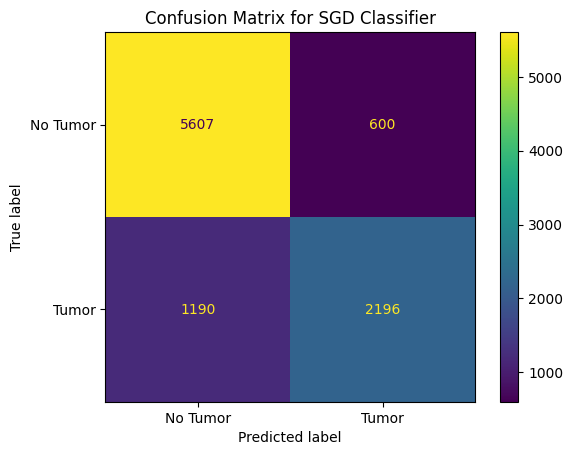

SVC Prediction Accuracy: 0.8086104451162306


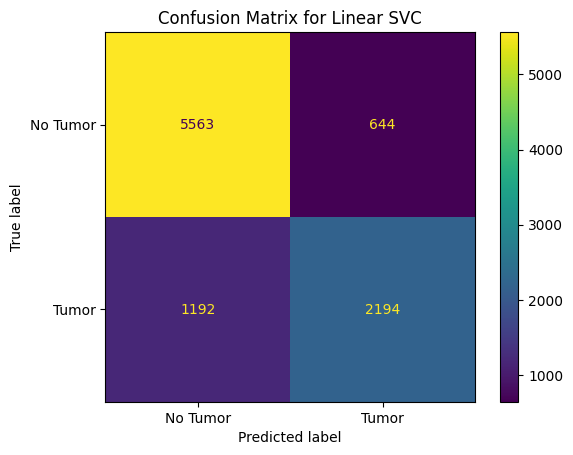

In [ ]:
sgd_pred = sgd_search.predict(x_test)
svc_pred = svc_search.predict(x_test)

ConfusionMatrixDisplay(confusion_matrix(y_test, sgd_pred),display_labels=["No Tumor", "Tumor"]).plot()
print("SGD Prediction Accuracy:", accuracy_score(y_test, sgd_pred))
plt.title("Confusion Matrix for SGD Classifier")
plt.show()

ConfusionMatrixDisplay(confusion_matrix(y_test, svc_pred),display_labels=["No Tumor", "Tumor"]).plot()
print("SVC Prediction Accuracy:", accuracy_score(y_test, svc_pred))
plt.title("Confusion Matrix for Linear SVC")
plt.show()

In [ ]:
print("\nTraining Classification Report:")
print(classification_report(y_train, svc_search.predict(x_train)))
print("\nValidation Classification Report:")
y_pred = svc_search.predict(x_test)
print(classification_report(y_test, y_pred))



Training Classification Report:
              precision    recall  f1-score   support

         0.0       0.83      0.89      0.86     25155
         1.0       0.76      0.65      0.70     13213

    accuracy                           0.81     38368
   macro avg       0.79      0.77      0.78     38368
weighted avg       0.80      0.81      0.80     38368


Validation Classification Report:
              precision    recall  f1-score   support

         0.0       0.82      0.90      0.86      6207
         1.0       0.77      0.65      0.71      3386

    accuracy                           0.81      9593
   macro avg       0.80      0.77      0.78      9593
weighted avg       0.81      0.81      0.80      9593



##### Performance Report of Linear SVC
__Training__
- Accuracy: 80%
- Recall: 80%
- Precision: 81%


__Validation__
- Accuracy: 80%
- Recall: 80%
- Precision: 82%

### 5.2.2 Model Performance on Counting Tumors in an Image
##### This section implements the tumor counting function of the model, and evaluates its performance

In [ ]:
# Define helper functions for invididual region treatment
def split_into_pathological_regions(gray_image, csv_file_path):
    df = pd.read_csv(csv_file_path)

    rois = []
    labels = []

    for idx, row in df.iterrows():
        shape = row['type']
        x_coords = list(map(int, row['coords_x'].split(',')))
        y_coords = list(map(int, row['coords_y'].split(',')))
        label = row['raw_classification']

        if shape == 'rectangle':
            x1, x2 = min(x_coords), max(x_coords)
            y1, y2 = min(y_coords), max(y_coords)
            roi = gray_image[y1:y2, x1:x2]
            rois.append(roi)
            labels.append(label)
        elif shape in ['polygon', 'polyline']:
            mask = np.zeros(gray_image.shape[:2], dtype=np.uint8)
            pts = np.array(list(zip(x_coords, y_coords)), np.int32)
            pts = pts.reshape((-1,1,2))
            cv2.fillPoly(mask, [pts], 255)
            masked = cv2.bitwise_and(gray_image, gray_image, mask=mask)
            x, y, w, h = cv2.boundingRect(pts)
            roi = masked[y:y+h, x:x+w]
            rois.append(roi)
            labels.append(label)

    return rois, labels
# Step 2: Feature extraction functions
def extract_sift_features(roi_image):
    """Extract SIFT features from the ROI"""
    features = {}

    # Skip if ROI is empty
    if np.sum(roi_image) == 0:
        return {"sift_keypoint_count": 0, "sift_desc_mean": 0, "sift_desc_std": 0,
                "sift_desc_max": 0, "sift_desc_min": 0}

    # Initialize SIFT detector
    sift = cv2.SIFT_create()

    # Find keypoints and descriptors
    keypoints, descriptors = sift.detectAndCompute(roi_image, None)

    # Count keypoints
    features['sift_keypoint_count'] = len(keypoints) if keypoints else 0

    # If descriptors were found, compute statistics
    if descriptors is not None and len(descriptors) > 0:
        # Calculate statistics of descriptors
        features['sift_desc_mean'] = np.mean(descriptors)
        features['sift_desc_std'] = np.std(descriptors)
        features['sift_desc_min'] = np.min(descriptors)
        features['sift_desc_max'] = np.max(descriptors)
    else:
        # No descriptors found, set default values
        features['sift_desc_mean'] = 0
        features['sift_desc_std'] = 0
        features['sift_desc_min'] = 0
        features['sift_desc_max'] = 0

    return features

def extract_hog_features(roi_image):
    """Extract HOG features from the ROI"""
    features = {}

    # Skip if ROI is empty
    if np.sum(roi_image) == 0:
        return {"hog_mean": 0, "hog_std": 0, "hog_min": 0, "hog_max": 0}

    # Resize for consistent HOG extraction
    resized_roi = cv2.resize(roi_image, (128, 128))

    # Calculate HOG features
    try:
        hog_features = hog(
            resized_roi,
            orientations=9,
            pixels_per_cell=(16, 16),
            cells_per_block=(2, 2),
            visualize=False,
            feature_vector=True
        )

        # Calculate statistics of HOG features
        features['hog_mean'] = np.mean(hog_features)
        features['hog_std'] = np.std(hog_features)
        features['hog_min'] = np.min(hog_features)
        features['hog_max'] = np.max(hog_features)

    except Exception as e:
        print(f"Error extracting HOG features: {e}")
        features['hog_mean'] = 0
        features['hog_std'] = 0
        features['hog_min'] = 0
        features['hog_max'] = 0

    return features

def extract_histogram_features(roi_image):
    """Extract histogram features from the ROI"""
    features = {}

    # Skip if ROI is empty
    if np.sum(roi_image) == 0:
        return {"hist_mean": 0, "hist_std": 0, "hist_energy": 0,
                "hist_entropy": 0, "hist_kurtosis": 0, "hist_skewness": 0}

    hist, bins = np.histogram(roi_image[roi_image > 0], bins=32, range=(0, 256))
    if hist.sum() > 0:
        hist = hist / hist.sum()

    features["hist_mean"] = np.mean(hist)
    features["hist_std"] = np.std(hist)
    features["hist_energy"] = np.sum(hist**2)

    hist_positive = hist[hist > 0]
    features["hist_entropy"] = -np.sum(hist_positive * np.log2(hist_positive)) if len(hist_positive) > 0 else 0

    # Higher order statistics
    try:
        features["hist_kurtosis"] = stats.kurtosis(hist)
        features["hist_skewness"] = stats.skew(hist)
    except:
        features["hist_kurtosis"] = 0
        features["hist_skewness"] = 0

    return features

def extract_connected_component_features(roi_image):
    """Extract blob/connected component features from the ROI"""
    import cv2
    import numpy as np
    from skimage import measure

    features = {}

    # Skip if nothing in ROI
    if np.sum(roi_image) == 0:
        return {"cc_count": 0, "cc_mean_area": 0, "cc_std_area": 0,
                "cc_mean_perimeter": 0, "cc_mean_eccentricity": 0}

    # Binarize image for connected components
    _, binary = cv2.threshold(roi_image, 10, 255, cv2.THRESH_BINARY)

    # Find connected components
    labeled = measure.label(binary)
    regions = measure.regionprops(labeled)

    # Count blobs
    features["cc_count"] = len(regions)

    # Extract blob statistics
    if len(regions) > 0:
        # Get areas and perimeters
        areas = [r.area for r in regions]
        perimeters = [r.perimeter for r in regions]
        eccentricities = [r.eccentricity for r in regions]

        features["cc_mean_area"] = np.mean(areas)
        features["cc_std_area"] = np.std(areas) if len(areas) > 1 else 0
        features["cc_mean_perimeter"] = np.mean(perimeters)
        features["cc_mean_eccentricity"] = np.mean(eccentricities)
    else:
        features["cc_mean_area"] = 0
        features["cc_std_area"] = 0
        features["cc_mean_perimeter"] = 0
        features["cc_mean_eccentricity"] = 0

    return features

def extract_all_features(roi_image):
    """Combine all feature extraction methods"""
    # Skip if ROI is empty
    if np.sum(roi_image) == 0:
        return {"empty": 1}

    # Extract features using different methods
    sift_features = extract_sift_features(roi_image)
    hog_features = extract_hog_features(roi_image)
    hist_features = extract_histogram_features(roi_image)
    cc_features = extract_connected_component_features(roi_image)

    # Combine all features
    all_features = {}
    all_features.update(sift_features)
    all_features.update(hog_features)
    all_features.update(hist_features)
    all_features.update(cc_features)

    return all_features

In [ ]:
# Section Explanation: This code will create a validation set and treat each
# image individually, dividing it up into its ROIs, predicting each ROI's element
# and finally giving a count of tumors detected in the image

all_csv = os.listdir(CSV_DIR)
random.seed(42)
random.shuffle(all_csv)

split_idx = int(0.8 * len(all_csv))
val_csv = all_csv[split_idx:]


num_detected_per_img = []
actual_num_per_img = []
for csv in val_csv:
    num_tumors = 0
    filename = csv[:-4]
    image = cv2.imread(os.path.join(RGB_DIR, filename+".png"),cv2.IMREAD_GRAYSCALE)

    rois, labels = split_into_pathological_regions(image, os.path.join(CSV_DIR,csv))

    # Count ground truth # of tumors in image
    for label in labels:
        if "tumor" in label:
            num_tumors+=1
    actual_num_per_img.append(num_tumors)

    # Convert features so we can pass it into the model
    features_list = []
    for roi in rois:
        features = extract_all_features(roi)
        keys = sorted(features.keys())
        feature_vals = [features[k] for k in keys]
        features_list.append(feature_vals)
    features_list = np.array(features_list)

    # For all regions of interest, make prediction
    predicted = svc_search.predict(features_list)
    num_detected_per_img.append(np.sum(predicted == 1))


# RMSE Calculation
squared_error = 0
for i in range(len(actual_num_per_img)):
    real_count = actual_num_per_img[i]
    detected_count = num_detected_per_img[i]
    diff = (real_count - detected_count)**2
    squared_error += diff
squared_error /= len(actual_num_per_img)
squared_error = sqrt(squared_error)
print(f"Tumor Count RMSE: {squared_error}")


Tumor Counting RMSE: 60.759312320916905
Tumor Count RMSE: 7.794825996833855


### 5.2.3 Perform Classification on Unmasked Image
##### This section involves training and optimizing a classifier to treat whole images instead of specific regions.

In [ ]:
# Create dataset of full images
image_features = []
tumor_presences = []
for csv in all_csv:
    filename = csv[:-4]
    df = pd.read_csv(os.path.join(CSV_DIR, csv))
    has_tumor = 0
    for idx, row in df.iterrows():
        label = row['raw_classification'] + row["main_classification"] + row["super_classification"]
        if "tumor" in label:
            has_tumor = 1
            break
    tumor_presences.append(has_tumor)

    img = cv2.imread(os.path.join(RGB_DIR,filename+".png"),cv2.IMREAD_GRAYSCALE)
    features = extract_all_features(img)
    keys = sorted(features.keys())
    features_list = [features[k] for k in keys]
    image_features.append(features_list)

In [ ]:
# Split into train and validation
image_features = np.array(image_features)
tumor_presences = np.array(tumor_presences)
x_train, x_test, y_train, y_test = train_test_split(image_features, tumor_presences, train_size=0.8)

In [ ]:
# SVM pipeline with optimized parameters
svc_pipeline = Pipeline([
    ('scaler', scaler),
    ('clf', svm.LinearSVC(dual=False, max_iter=10000, random_state=42))
])
svc_params = {
    'clf__C': [0.01, 0.1, 1.0, 10.0],
    'clf__penalty': ['l2'],
    'clf__loss': ['squared_hinge'],
}
svc_search_full_image = GridSearchCV(svc_pipeline, svc_params, cv=5, n_jobs=-1, verbose=1)
svc_search_full_image.fit(x_train, y_train)
print("\n=== Best LinearSVC Params ===")
print(svc_search_full_image.best_params_)
print("\nTraining Classification Report:")
print(classification_report(y_train, svc_search_full_image.predict(x_train)))
print("\nValidation Classification Report:")
y_pred = svc_search_full_image.predict(x_test)
print(classification_report(y_test, y_pred))


Fitting 5 folds for each of 4 candidates, totalling 20 fits

=== Best LinearSVC Params ===
{'clf__C': 0.01, 'clf__loss': 'squared_hinge', 'clf__penalty': 'l2'}

Training Classification Report:
              precision    recall  f1-score   support

           0       0.66      0.38      0.48       436
           1       0.76      0.91      0.83       959

    accuracy                           0.74      1395
   macro avg       0.71      0.65      0.66      1395
weighted avg       0.73      0.74      0.72      1395


Validation Classification Report:
              precision    recall  f1-score   support

           0       0.70      0.30      0.42       128
           1       0.70      0.92      0.79       221

    accuracy                           0.70       349
   macro avg       0.70      0.61      0.61       349
weighted avg       0.70      0.70      0.66       349



SGD Prediction Accuracy: 0.6962750716332379


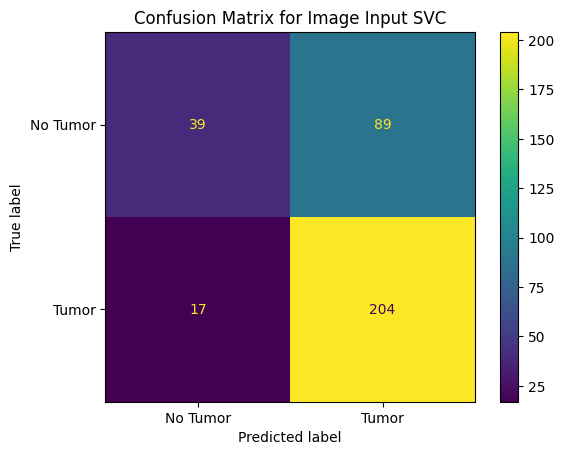

In [ ]:
ConfusionMatrixDisplay(confusion_matrix(y_test, y_pred),display_labels=["No Tumor", "Tumor"]).plot()
print("SGD Prediction Accuracy:", accuracy_score(y_test, y_pred))
plt.title("Confusion Matrix for Image Input SVC")
plt.show()

### 5.2.4 Determine Easiest Features to Distinguish from Tumors
##### This section involves determining which structures are easiest to distinguish from tumours using our linear SVC model

In [ ]:
total_labels_count = {}
misclassified_count = {}
to_display = {}
tumor_pics = []
for i in range(len(actual_num_per_img)):
    num_detected = num_detected_per_img[i]
    num_actual = actual_num_per_img[i]
    filename = val_csv[i]
    image_name = filename[:-3]+"png"
    image = cv2.imread(os.path.join(RGB_DIR,image_name), cv2.IMREAD_GRAYSCALE)

    rois, labels = split_into_pathological_regions(image, os.path.join(CSV_DIR,filename))
    for i in range(len(rois)):
        # Skip all tumor classifications
        if "tumor" in labels[i]:
            if len(tumor_pics) < 3:
                tumor_pics.append(rois[i])
            continue
        total_labels_count[labels[i]] = total_labels_count.get(labels[i],0)+1

        if "lymphocyte" or "neutrophil" in labels[i]:
            images = to_display.get(labels[i],[])
            if len(images)<3:
                images.append(rois[i])
            to_display[labels[i]] = images

        features = extract_all_features(rois[i])
        keys = sorted(features.keys())
        features_list = [features[k] for k in keys]

        features_list = np.array([features_list])

        pred = svc_search.predict(features_list)
        # If the prediction is not "not-tumor", then its a misclassification
        if pred[0] != 0:
            misclassified_count[labels[i]] = misclassified_count.get(labels[i],0) + 1

print(total_labels_count)
print(misclassified_count)
for key in total_labels_count.keys():
    print(f"Structure: {key}: {misclassified_count.get(key,0)/total_labels_count[key]*100:.2f}% mis-identified as tumor")

{'unlabeled': 1671, 'apoptotic_body': 91, 'fibroblast': 1515, 'lymphocyte': 2838, 'plasma_cell': 1153, 'mitotic_figure': 42, 'vascular_endothelium': 133, 'macrophage': 302, 'neutrophil': 29, 'ductal_epithelium': 61, 'myoepithelium': 1}
{'unlabeled': 239, 'fibroblast': 406, 'plasma_cell': 35, 'vascular_endothelium': 53, 'macrophage': 74, 'lymphocyte': 13, 'apoptotic_body': 4, 'mitotic_figure': 5, 'ductal_epithelium': 8}
Structure: unlabeled: 14.30% mis-identified as tumor
Structure: apoptotic_body: 4.40% mis-identified as tumor
Structure: fibroblast: 26.80% mis-identified as tumor
Structure: lymphocyte: 0.46% mis-identified as tumor
Structure: plasma_cell: 3.04% mis-identified as tumor
Structure: mitotic_figure: 11.90% mis-identified as tumor
Structure: vascular_endothelium: 39.85% mis-identified as tumor
Structure: macrophage: 24.50% mis-identified as tumor
Structure: neutrophil: 0.00% mis-identified as tumor
Structure: ductal_epithelium: 13.11% mis-identified as tumor
Structure: myoep

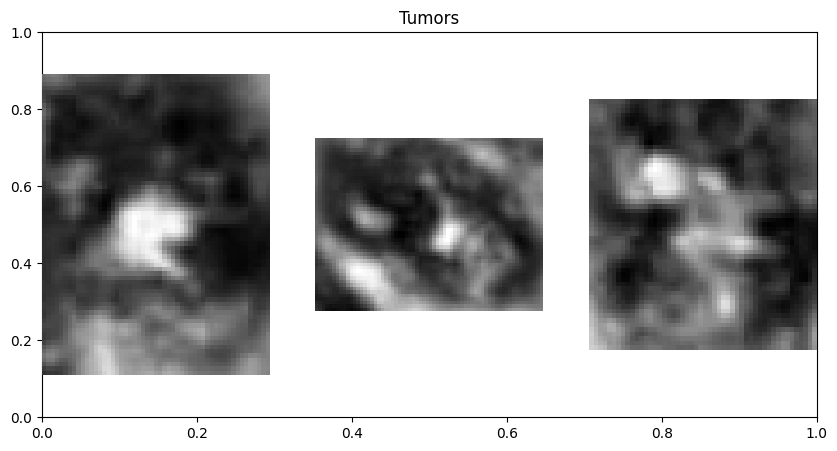

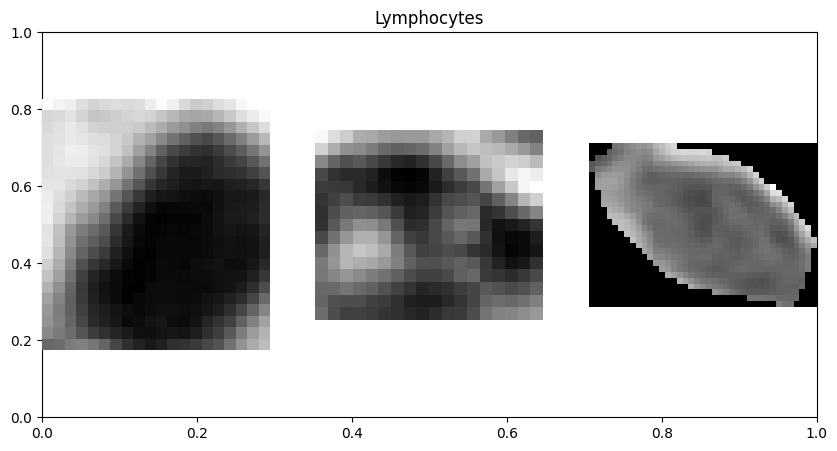

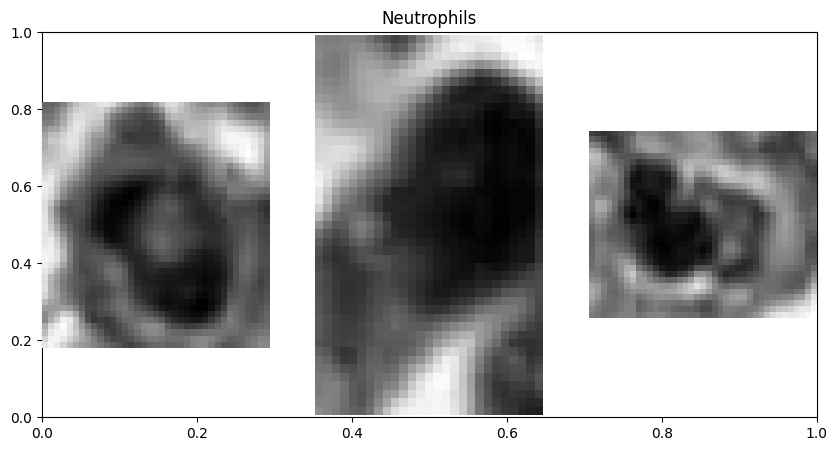

In [ ]:
lymphocytes = to_display.get("lymphocyte")
neutrophils = to_display.get("neutrophil")

plt.figure(figsize=(10,5))
plt.title("Tumors")
for idx, val in enumerate(tumor_pics):
    plt.subplot(131+idx)
    plt.imshow(val, cmap='gray')
    plt.axis("off")
plt.show()

plt.figure(figsize=(10,5))
plt.title("Lymphocytes")
for idx, val in enumerate(lymphocytes):
    plt.subplot(131+idx)
    plt.imshow(val, cmap='gray')
    plt.axis("off")
plt.show()

plt.figure(figsize=(10,5))
plt.title("Neutrophils")
for idx, val in enumerate(neutrophils):
    plt.subplot(131+idx)
    plt.imshow(val, cmap='gray')
    plt.axis("off")

plt.show()


##### __Discuss: Based on Features, what structures are easiest to distringuish from tumors__
The figures above illustrate tumors, as well as the two structures that were most accurately distinguished from tumors, neutrophils and lymphocytes. From these examples, the difference is fairly visible: tumors are are bright and enclosed, whereas the enclosure of the other two are much darker and their enclosure may be less pronounced. These differences, along with many others, make it much simpler for our simple SVM to distinguish them from tumors.

The features used for this model include HoG, SIFT, Histogram, and Connected Components. For this case, picking up on the intensity histogram may play a large factor in segregating them from tumors. Additionally, the descriptors of SIFT capture local surrounding textures, and the connected components pick up on the differences in shape. When put together, these features work very well with one another and result in a relatively low misclassification rate.

# 6. Bonus Question

## 6.1 Supervised Learning

We will first train a model to segment images by using the first 30 samples of the given patient, sampled randomly.

In [ ]:
# New imports required for this part
!pip install segmentation-models-pytorch==0.2.0

import os
import cv2
import torch
import numpy as np
import albumentations as A
import matplotlib.pyplot as plt
import segmentation_models_pytorch as smp
from torch.utils.data import Dataset, DataLoader

DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 4.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.6/87.6 kB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 377.0/377.0 kB 22.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 81.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 34.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 23.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 11.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 8.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

We can now define some data pre-processing and augmentation functions to make the segmentor perform better.

In [ ]:
def to_tensor(x, **kwargs):
    return x.transpose(2, 0, 1).astype('float32')

def get_preprocessing(preprocessing_fn):
    return A.Compose([
        A.Lambda(image=preprocessing_fn),
        A.Lambda(image=to_tensor, mask=to_tensor),
    ])

# Augments the training data by performing flips, scales, rotations and brightness contrasts
def get_training_augmentation():
    return A.Compose([
        A.HorizontalFlip(p=0.5),
        A.RandomBrightnessContrast(p=0.2),
        A.ShiftScaleRotate(shift_limit=0.1, scale_limit=0.1, rotate_limit=15, p=0.5),
    ])

Below is a class definition of the dataset which will be used for training.

In [ ]:
class SegmentationDataset(Dataset):
    def __init__(self, image_files, subject_id, rgb_dir, csv_dir, augmentation=None, preprocessing=None, size=(320, 320)):
        self.image_files = image_files
        self.subject_id = subject_id
        self.rgb_dir = rgb_dir
        self.csv_dir = csv_dir
        self.size = size
        self.augmentation = augmentation
        self.preprocessing = preprocessing

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        img_file = self.image_files[idx]
        img_path = os.path.join(self.rgb_dir, img_file)
        image = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)
        image_id = os.path.splitext(img_file)[0]

        # Generate ground truth from CSV
        mask = generate_ground_truth(self.subject_id, image_id, image.shape)
        mask = (mask > 127).astype("float32")  # binarize
        mask = cv2.resize(mask, self.size)
        image = cv2.resize(image, self.size)

        mask = np.expand_dims(mask, axis=-1)

        if self.augmentation:
            sample = self.augmentation(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']

        if self.preprocessing:
            sample = self.preprocessing(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']

        return image, mask


We will now define the model we will be using by setting up a new instance of the UNet model.

In [ ]:
ENCODER = 'resnet34'
ENCODER_WEIGHTS = 'imagenet'
ACTIVATION = 'sigmoid'
preprocessing_fn = smp.encoders.get_preprocessing_fn(ENCODER, ENCODER_WEIGHTS)

model = smp.Unet(
    encoder_name=ENCODER,
    encoder_weights=ENCODER_WEIGHTS,
    classes=1,
    activation=ACTIVATION,
).to(DEVICE)

Now, we will define the actual dataset that we will be using by making use of the functions we defined above.

In [ ]:
# Prepare dataset
subject_id = "TCGA-EW-A1P1-DX1"
all_files = sorted([f for f in os.listdir(RGB_DIR) if f.startswith(subject_id)])
train_files = all_files[:30]
val_files = all_files[30:]

train_dataset = SegmentationDataset(
    train_files,
    subject_id,
    RGB_DIR,
    CSV_DIR,
    augmentation=get_training_augmentation(),
    preprocessing=get_preprocessing(preprocessing_fn),
)

train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True)

# Loss and optimizer
loss_fn = smp.utils.losses.DiceLoss()
metrics = [smp.utils.metrics.IoU(threshold=0.5)]
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

# Training loop
train_epoch = smp.utils.train.TrainEpoch(
    model, loss=loss_fn, metrics=metrics,
    optimizer=optimizer, device=DEVICE, verbose=True,
)


/usr/local/lib/python3.11/dist-packages/albumentations/core/validation.py:87: UserWarning: ShiftScaleRotate is a special case of Affine transform. Please use Affine transform instead.
  original_init(self, **validated_kwargs)


We can finally train our model defined above.

In [ ]:
epochs = 100
for epoch in range(epochs):
    print(f"\nEpoch {epoch+1}/{epochs}")
    logs = train_epoch.run(train_loader)



Epoch 1/100
train: 100%|██████████| 8/8 [00:01<00:00,  5.34it/s, dice_loss - 0.6239, iou_score - 0.2666]

Epoch 2/100
train: 100%|██████████| 8/8 [00:01<00:00,  5.95it/s, dice_loss - 0.5747, iou_score - 0.3446]

Epoch 3/100
train: 100%|██████████| 8/8 [00:01<00:00,  5.95it/s, dice_loss - 0.5469, iou_score - 0.3792]

Epoch 4/100
train: 100%|██████████| 8/8 [00:01<00:00,  5.94it/s, dice_loss - 0.5128, iou_score - 0.418]

Epoch 5/100
train: 100%|██████████| 8/8 [00:01<00:00,  5.86it/s, dice_loss - 0.4875, iou_score - 0.4423]

Epoch 6/100
train: 100%|██████████| 8/8 [00:01<00:00,  5.20it/s, dice_loss - 0.4627, iou_score - 0.4759]

Epoch 7/100
train: 100%|██████████| 8/8 [00:01<00:00,  5.21it/s, dice_loss - 0.4404, iou_score - 0.5007]

Epoch 8/100
train: 100%|██████████| 8/8 [00:01<00:00,  5.81it/s, dice_loss - 0.4118, iou_score - 0.5314]

Epoch 9/100
train: 100%|██████████| 8/8 [00:01<00:00,  5.93it/s, dice_loss - 0.3923, iou_score - 0.558]

Epoch 10/100
train: 100%|██████████| 8/8 [00:01

Now that we have a trained model for the first 30 samples, we will evaluate its performance over its training data.

In [ ]:
# Evaluate model on the training set
model.eval()
train_dataset_no_aug = SegmentationDataset(
    train_files,
    subject_id,
    RGB_DIR,
    CSV_DIR,
    preprocessing=get_preprocessing(preprocessing_fn),
)
train_loader_eval = DataLoader(train_dataset_no_aug, batch_size=1)

dice_scores = []
with torch.no_grad():
    for x, y in train_loader_eval:
        x = x.to(DEVICE)
        y = y.to(DEVICE)
        pred = model.predict(x)
        pred = (pred > 0.5).float()

        intersection = (pred * y).sum()
        union = pred.sum() + y.sum()
        dice = (2. * intersection / union).item() if union != 0 else 1.0
        dice_scores.append(dice)

print(f"\n Average DICE on Training Set: {np.mean(dice_scores):.4f}")


 Average DICE on Training Set: 0.9322


**Key details of the implementation**
> The model which was used for this task is a pre-trained U-Net model with a ResNet50 encoder (we used the Segmentation Models PyTorch library). For the dataset, we used 30 random data images from the specified patient, and we generated the ground truth mask image from the associated CSV file. Input images and masks were resized to 320×320 and normalized using ImageNet statistics. We applied sigmoid activation and trained using the DICE loss and IoU score to optimize overlap between predicted and true masks. The model was trained for 100 epochs. Evaluation was performed using DICE coefficients.

## 6.2 Inference

Below is a function to quickly display the predicted mask for an original image segmented using the above model.

In [ ]:
def denormalize_image(image_tensor):
    # Ensure tensor is [3, H, W]
    if image_tensor.dim() == 4:
        image_tensor = image_tensor.squeeze(0)

    mean = torch.tensor([0.485, 0.456, 0.406], device=image_tensor.device).view(3, 1, 1)
    std = torch.tensor([0.229, 0.224, 0.225], device=image_tensor.device).view(3, 1, 1)
    return image_tensor * std + mean

def show_prediction(image_tensor, mask_true, mask_pred):
    # De-normalize the image
    image_tensor = denormalize_image(image_tensor)
    image_np = image_tensor.permute(1, 2, 0).cpu().numpy()
    image_np = np.clip(image_np, 0, 1)

    mask_true = mask_true.squeeze().cpu().numpy()
    mask_pred = mask_pred.squeeze().cpu().numpy()

    # Threshold mask for binary visualization
    mask_binary = (mask_pred * 255).astype(np.uint8)

    # Plot
    plt.figure(figsize=(15, 5))
    plt.subplot(1, 3, 1)
    plt.imshow(image_np)
    plt.title("Original Image")
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.imshow(mask_true, cmap="gray")
    plt.title("Ground Truth")
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.imshow(mask_binary, cmap="gray")
    plt.title("Predicted Binary Mask")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

Now, we can evaluate the model defined above to see how it performs on the remaining 8 samples from the same patient.

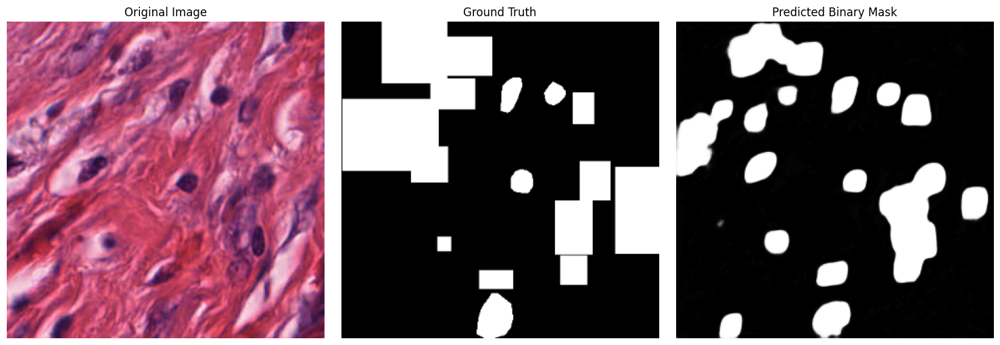

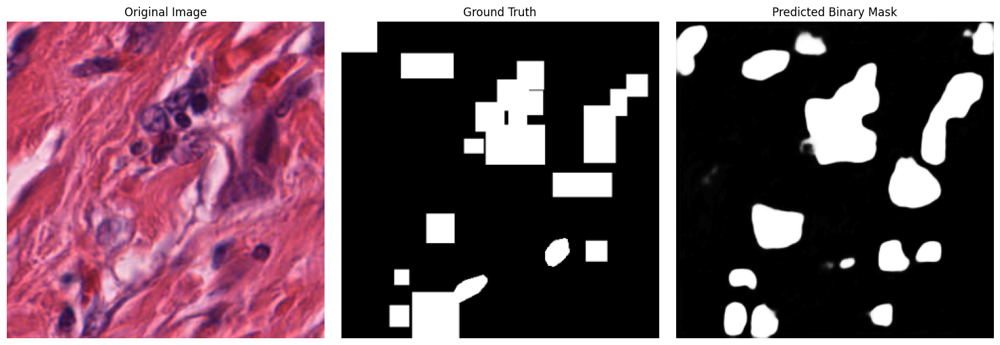


 Inference on 8 Samples:
Average DICE: 0.6573


In [ ]:
# Apply same preprocessing as during training
val_dataset = SegmentationDataset(
    val_files,
    subject_id,
    RGB_DIR,
    CSV_DIR,
    preprocessing=get_preprocessing(preprocessing_fn),
)

val_loader = DataLoader(val_dataset, batch_size=1, shuffle=False)

model.eval()
dice_scores = []

with torch.no_grad():
    for i, (images, masks) in enumerate(val_loader):
        images = images.to(DEVICE)
        masks = masks.to(DEVICE)

        preds = model(images)
        preds_sigmoid = torch.sigmoid(preds)
        preds_bin = preds_sigmoid.float() * 255

        # DICE calculation
        intersection = (preds_bin * masks).sum()
        union = preds_bin.sum() + masks.sum()
        dice = (2. * intersection / union).item() if union > 0 else 1.0
        dice_scores.append(dice)

        # Show sigmoid + binary thresholded mask
        if i < 2:
            sig = preds_sigmoid[0].cpu().squeeze().numpy()  # Define it here

            show_prediction(images[0].cpu(), masks[0].cpu(), preds_sigmoid[0].cpu())

            bin_mask = (sig > 0.5).astype(np.uint8) * 255

print(f"\n Inference on {len(val_dataset)} Samples:")
print(f"Average DICE: {sum(dice_scores)/len(dice_scores):.4f}")

As can be seen in the above results, the average DICE coefficient of the model's output was much better with the training data (0.9322) than with the 8 remaining samples for the inference part (0.6573). Increasing the number of epochs made the DICE coefficient much higher on the training dataset, but had a very slight increase on the validation dataset. This indicates that there was some overfitting on the training data, meaning that the model became too good at predicting this specific data and less efficient at predicting the remaining samples from the same patient. This is logical, since the training dataset was only containing 30 samples. Still, performance on the remaining samples is somewhat good and surpasses some of the previously evaluated methods.